In [74]:
# Initialize Notebook
from IPython.core.display import HTML,Image
#%run ../library/v1.0.5/init.ipy
HTML('''<script> code_show=true;  function code_toggle() {  if (code_show){  $('div.input').hide();  } else {  $('div.input').show();  }  code_show = !code_show }  $( document ).ready(code_toggle); </script> <form action="javascript:code_toggle()"><input type="submit" value="Toggle Code"></form>''')

In [1]:
import warnings
warnings.filterwarnings('ignore')
import gc, argparse, sys, os, errno
%pylab inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt;
import seaborn as sns
#sns.set()
#sns.set_style('whitegrid')
import h5py
from PIL import Image
import os
from tqdm import tqdm_notebook as tqdm
import scipy
import sklearn
from scipy.stats import pearsonr
from scipy.io import loadmat
import IPython.display as ipd
import IPython
import librosa.display
import librosa
from pystoi import stoi

Populating the interactive namespace from numpy and matplotlib


In [2]:
from mcd import dtw
import mcd.metrics as mt
def mel_cep_dtw_dist(target, converted):
    """
    Compute the distance between two unaligned speech waveforms
    :param target: reference speech numpy array
    :param converted: synthesized speech numpy array
    :return: mel cep distance in dB
    """
    total_cost = 0
    total_frames = 0
    for (tar, conv) in zip(target, converted):
        tar, conv = tar.astype('float64'), conv.astype('float64')
        cost, _ = dtw.dtw(tar, conv, mt.logSpecDbDist)
        frames = len(tar)
        total_cost += cost
        total_frames += frames

    return total_cost / total_frames
def plot_stft(audio,ax=None,n_fft=256,hop_length=128,show=False,n_mels=128,y_axis='mel'):
    X = librosa.stft(audio,n_fft=n_fft,hop_length=hop_length)
    if y_axis=='mel':
        #x_stft_db = librosa.feature.melspectrogram(x, sr=16000,n_fft=n_fft,win_length=win_length,hop_length=hop_length)
        S = librosa.feature.melspectrogram(audio, sr=16000,n_mels=n_mels,fmax=8000,n_fft=n_fft,hop_length=hop_length)
        #print (S.shape)
        if show:
            librosa.display.specshow(librosa.power_to_db(S,
                                              ref=np.max),
                             y_axis='mel',cmap='gray_r',ax=ax, fmax=8000)
        else:
            spec_db = librosa.power_to_db(S,ref=np.max)
            #level = 80
            #spec_db[spec_db<=-level] = -100
            #spec_db[spec_db==-level] = -100
            return spec_db
    else:
        if show:
            specshow(librosa.amplitude_to_db(abs(X)),cmap=cm.Blues,#cm.gray_r,
                                      sr=16000,ax=ax)
        else:
            return librosa.amplitude_to_db(abs(X))
    
def MSE_pcc(A,B,ax=None):
    mse =np.mean(((A - B)**2/B.var()))
    pcc = pearsonr(A.ravel(),B.ravel())[0]
    return mse,pcc
def analyze(predict,GT_STFT_test_spkr,audio_pred,audio_gt,mode='test',ind=-1,plot=False,mcd=None):
    samples = predict.shape[0]
    pcc = np.zeros([samples])
    mse = np.zeros([samples])
    for i in range(samples):
        mse[i], pcc[i] = MSE_pcc(predict[i],GT_STFT_test_spkr[i])
        #mse[i], pcc[i] = MSE_pcc(predict[i] ,GT_STFT_test_spkr[i] )
    stois = []
    timedur = 0#0.06

    for i in range(samples):
        stois.append(stoi(np.concatenate((np.ones([int(interval*timedur)]),\
                audio_pred[i*interval:(i+1)*interval],np.ones([int(interval*timedur)]))), \
                          np.concatenate((np.ones([int(interval*timedur)]),\
                audio_gt[i*interval:(i+1)*interval],np.ones([int(interval*timedur)]))), 16000, extended=False))
    stois = np.array(stois)
    if plot:
        if mcd is not None:
            fig,ax=plt.subplots(1,4,figsize=(18,4))
            ax[3].hist(mcd,bins=50,color='m')
            ax[3].set_title(mode+' MCD: %g(%g)' %(np.round(mcd.mean(),3),np.round(mcd.std(),3)))
        else:
            fig,ax=plt.subplots(1,3,figsize=(20,4))
        #fig,ax=plt.subplots(1,3,figsize=(18,4))
        ax[0].hist(mse,bins=25,color='b')
        ax[0].set_title('ind '+str(ind)+' '+mode+' MSE: %g(%g)' %(np.round(mse.mean(),3),np.round(mse.std(),3)))
        ax[1].hist(pcc,bins=50,color='g')
        ax[1].set_title(mode+' PCC: %g(%g)' %(np.round(pcc.mean(),3),np.round(pcc.std(),3)))
        ax[2].hist(stois,bins=50,color='r')
        ax[2].set_title(mode+' STOI: %g(%g)' %(np.round(stois.mean(),3),np.round(stois.std(),3)))
    return mse,pcc,stois
def play(audio,sr=16000):
    '''
    audio: tensor, eg: ex['audio']
    '''
    if len(audio.shape) >=2:
        audio = audio.ravel()
    display(ipd.Audio(audio,rate=sr))
    
def amplitude(x,noise_db=-50,max_db=22.5,trim_noise=True):
   if trim_noise:
      x_db = (x+1)/2*(max_db-noise_db)+noise_db
      if type(x) is np.ndarray:
         return 10**(x_db/10)*(x_db>noise_db).astype(np.float32)
      else:
         return 10**(x_db/10)*(x_db>noise_db).float()
   else:
      return 10**(((x+1)/2*(max_db-noise_db)+noise_db)/10)
    
def log_spec_dB_dist(x, y):
    log_spec_dB_const = 10.0 / math.log(10.0) * math.sqrt(2.0)
    diff = x - y
    
    return log_spec_dB_const * math.sqrt(np.inner(diff, diff))
    
interval = 16384

In [3]:
def get_result_dict(sampleind):
    result_dict = np.load('/scratch/xc1490/projects/ecog/ALAE_1023/data/formant_result/{}.npy'.format(sampleind),allow_pickle=1).item()
    #print (result_dict.keys())
    wave_key_list = ['wave_org_denoise','wave_rec','wave_rec_denoise','wave_rec_ecog','wave_rec_ecog_denoise']
    for key in result_dict.keys():
        if key!='components' and key!='components_ecog' and key!='lable':
            #print (key)
            #print (key,result_dict[key].shape)
            if key =='org_denoise':
                result_dict[key] = amplitude(result_dict[key])
            if key =='rec_denoise' or key =='rec_ecog' or key =='rec_ecog_denoise' or key =='org' or key =='rec':
                result_dict[key] = (result_dict[key]-0.5)*2
            if key in wave_key_list:
                #print (key)
                factor = np.sqrt(sum(result_dict['wave_org']**2)/sum(result_dict[key]**2))
                result_dict[key] = result_dict[key]*factor
    for key in ['org','rec','rec_ecog','rec_ecog_denoise','rec_ecog','rec_denoise']:
        result_dict[key] = np.swapaxes(result_dict[key].reshape(256,50,-1),1,0)
    return result_dict

In [79]:
def get_metric_from_result_dict(result_dict,sample_ind=None):
    #e2a
    spec_gt = result_dict['org']
    spec_pred = result_dict['rec_ecog']
 
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec_ecog'][:819582//interval*interval].ravel()

    spec_pred_mel = np.zeros([50,32,128])
    spec_gt_mel = np.zeros([50,32,128])

    for i in  range(50):
        spec_pred_mel[i] = plot_stft(wave_pred[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='mel',n_mels=32)
        spec_gt_mel[i] = plot_stft(wave_gt[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='mel',n_mels=32 )
    spec_concat_e2a = np.concatenate(( np.flip(spec_gt_mel,axis=1), np.flip(spec_pred_mel,axis=1)),axis=1)
    speclin_concat_e2a = np.concatenate(( np.flip(spec_gt ,axis=1), np.flip(spec_pred ,axis=1)),axis=1)
    
    mcds = []
    for i in  range(50) :
        mcds.append(mel_cep_dtw_dist(spec_pred_mel[i].T[:,1:]/10,spec_gt_mel[i].T[:,1:]/10))
    mcds = np.array(mcds)
    mcd_e2a = mcds
    
    mse_test_e2a,pcc_test_e2a,stois_test_e2a = analyze(spec_pred_mel,spec_gt_mel,wave_pred,wave_gt,plot=False,mcd=mcds)
    if sample_ind !=749:
        wave_gt_e2a = wave_gt
        wave_pred_e2a = wave_pred
    else:
        wave_gt_e2a = result_dict['wave_org_denoise'][:,0,:].ravel()#wave_gt
        wave_pred_e2a = result_dict['wave_rec_ecog_denoise'][:819582//interval*interval].ravel()#wave_pred

    
    #a2a
    spec_gt = result_dict['org']
    spec_pred = result_dict['rec']
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec'][:819582//interval*interval].ravel()

    spec_pred_mel = np.zeros([50,32,128])
    spec_gt_mel = np.zeros([50,32,128])

    for i in  range(50):
        spec_pred_mel[i] = plot_stft(wave_pred[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='mel',n_mels=32)
        spec_gt_mel[i] = plot_stft(wave_gt[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='mel',n_mels=32 )
    spec_concat_a2a = np.concatenate(( np.flip(spec_gt_mel,axis=1), np.flip(spec_pred_mel,axis=1)),axis=1)
    speclin_concat_a2a = np.concatenate(( np.flip(spec_gt ,axis=1), np.flip(spec_pred ,axis=1)),axis=1)
    
    mcds = []
    for i in  range(50) :
        mcds.append(mel_cep_dtw_dist(spec_pred_mel[i].T[:,1:]/10,spec_gt_mel[i].T[:,1:]/10))
    mcds = np.array(mcds)
    mcd_a2a = mcds
    if sample_ind ==717:
        wave_gt_a2a = wave_gt
        wave_pred_a2a = wave_pred
    else:
        wave_gt_a2a = result_dict['wave_org_denoise'][:,0,:].ravel()#wave_gt
        wave_pred_a2a = result_dict['wave_rec_denoise'][:819582//interval*interval].ravel()#wave_pred
    
    mse_test_a2a,pcc_test_a2a,stois_test_a2a = analyze(spec_pred_mel,spec_gt_mel,wave_pred,wave_gt,plot=False,mcd=mcds)

    #mfcc e2a
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec_ecog'][:819582//interval*interval].ravel()

    spec_pred = np.zeros([50,32,33])
    spec_gt = np.zeros([50,32,33])
    mfcc_e2a = np.zeros([50])
    for i in  range(50):
        spec_pred[i] = librosa.feature.mfcc(y=wave_pred[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        spec_gt[i] = librosa.feature.mfcc(y=wave_gt[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        mfcc_e2a[i] = pearsonr(spec_pred[i].ravel(),spec_gt[i].ravel())[0]
    specmfcc_concat_e2a = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)
    
    #mfcc a2a
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec'][:819582//interval*interval].ravel()

    spec_pred = np.zeros([50,32,33])
    spec_gt = np.zeros([50,32,33])

    mfcc_a2a = np.zeros([50])
    for i in  range(50):
        spec_pred[i] = librosa.feature.mfcc(y=wave_pred[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        spec_gt[i] = librosa.feature.mfcc(y=wave_gt[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        mfcc_a2a[i] = pearsonr(spec_pred[i].ravel(),spec_gt[i].ravel())[0]
    specmfcc_concat_a2a = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)

    components_keys = ['f0','loudness', 'amplitudes', 'amplitudes_h', 'freq_formants_hamon_hz', 'bandwidth_formants_hamon_hz', 'amplitude_formants_hamon','freq_formants_noise_hz', 'bandwidth_formants_noise_hz', 'amplitude_formants_noise']
    components_pcc = {}
    for key in components_keys:
        components_pcc[key] = np.zeros([50])
        for i in range(50):
            components_pcc[key][i] =pearsonr((result_dict['components'][key][i] *(result_dict['components']['amplitudes'][i,0:1,:]  >=0.2)).ravel(),\
                            (result_dict['components_ecog'][key][i] *(result_dict['components']['amplitudes'][i,0:1,:]  >=0.2)).ravel())[0]
        #print (key,result_dict['components'][key].shape,np.mean(components_pcc[key]))
    return mse_test_e2a, pcc_test_e2a, stois_test_e2a, mcd_e2a, mfcc_e2a, \
            mse_test_a2a, pcc_test_a2a, stois_test_a2a, mcd_a2a, mfcc_a2a, components_pcc,\
            wave_gt_a2a,wave_pred_a2a, wave_gt_e2a,wave_pred_e2a, spec_concat_e2a, spec_concat_a2a,\
            specmfcc_concat_e2a,specmfcc_concat_a2a,speclin_concat_e2a,speclin_concat_a2a,\
                result_dict['components'],result_dict['components_ecog']


sample_ind = int(os.getcwd().split('/')[-1])
#sample_ind = 717


In [185]:
result_dict = get_result_dict(sample_ind)
mse_test_e2a, pcc_test_e2a, stois_test_e2a, mcd_e2a, mfcc_e2a, \
            mse_test_a2a, pcc_test_a2a, stois_test_a2a, mcd_a2a, mfcc_a2a, components_pcc,\
            wave_gt_a2a,wave_pred_a2a, wave_gt_e2a,wave_pred_e2a, spec_concat_e2a, spec_concat_a2a,\
            specmfcc_concat_e2a,specmfcc_concat_a2a,speclin_concat_e2a,speclin_concat_a2a,\
                components,components_ecog= get_metric_from_result_dict(result_dict,sample_ind =sample_ind)

In [6]:
select_word = np.loadtxt('/scratch/xc1490/projects/ecog/ALAE_1023/data/wordlist_NY{}.txt'.format(sample_ind),dtype='str')

# audio to audio
- gt
- prediction
- merge
- metrics
- spectrogram, waveform

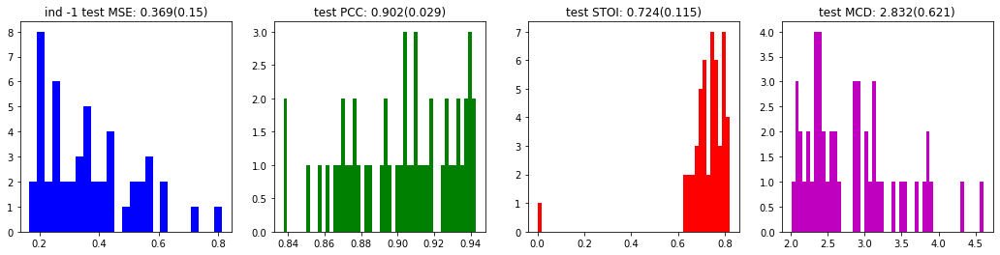

In [7]:
mse_test,pcc_test,stois_test = analyze(spec_concat_a2a[:,32:],spec_concat_a2a[:,:32],wave_gt_a2a,wave_pred_a2a,mode='test',ind=-1,plot=True,mcd=mcd_a2a)

In [8]:
wave_merge_a2a = np.concatenate(([np.concatenate((wave_gt_a2a[i*interval:(i+1)*interval],wave_pred_a2a[i*interval:(i+1)*interval]))\
                 for i in range(50)]))

In [9]:
display(ipd.Audio(wave_gt_a2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [10]:
display(ipd.Audio(wave_pred_a2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [11]:
display(ipd.Audio(wave_merge_a2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

## waveform

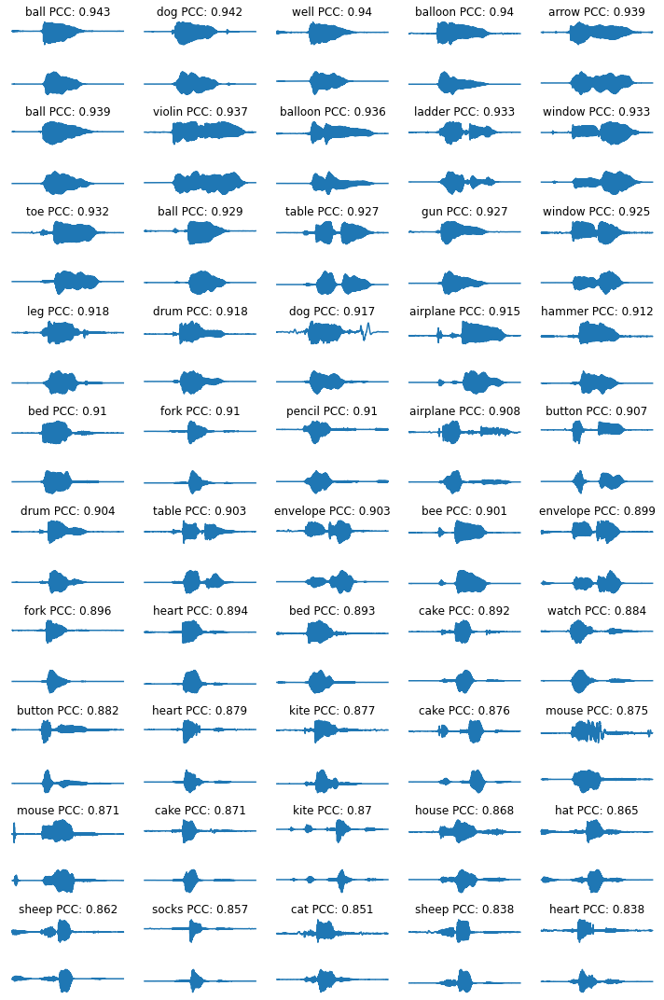

In [12]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums*2,col_nums,figsize=(col_nums*2,row_nums*1.5))
for i in range(row_nums):
    for j in range(col_nums):
        try:
            ax[i*2,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' PCC: {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
        ax[i*2,j].plot(wave_gt_a2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2+1,j].plot(wave_pred_a2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2,j].axis('off')
        ax[i*2+1,j].axis('off')
fig.tight_layout()

## mel spec

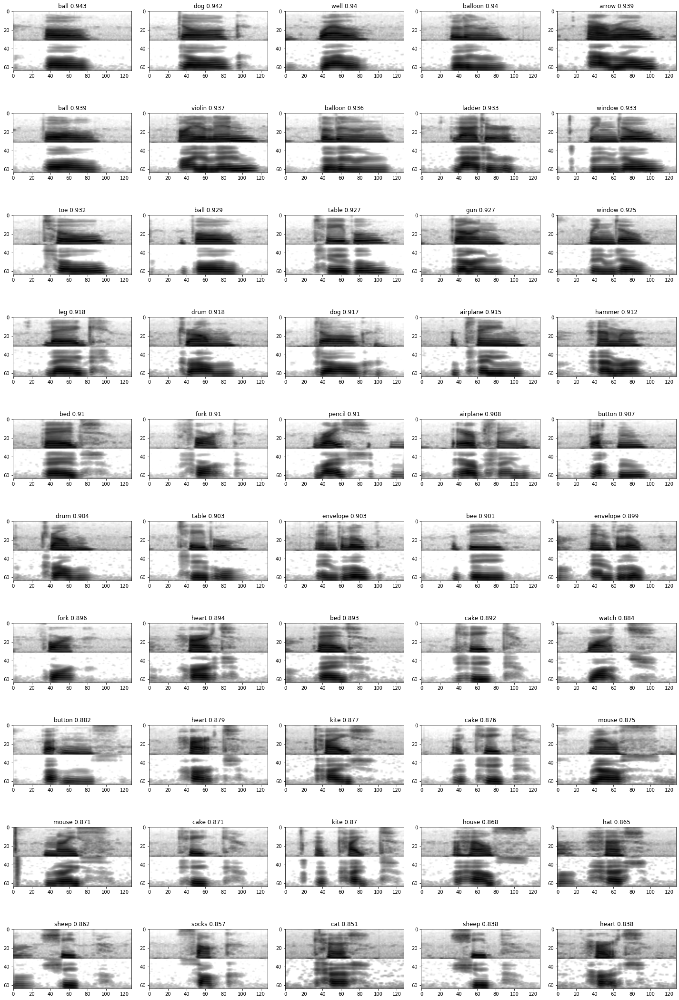

In [13]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*4,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat_a2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

In [14]:
spec_pred = np.zeros([50,256,128])
spec_gt = np.zeros([50,256,128])


for i in tqdm(range(50)):
    spec_pred[i] = plot_stft(wave_pred_a2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='linear',n_mels=64)
    spec_gt[i] = plot_stft(wave_gt_a2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='linear',n_mels=64 )

spec_concat = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)

## linear spec

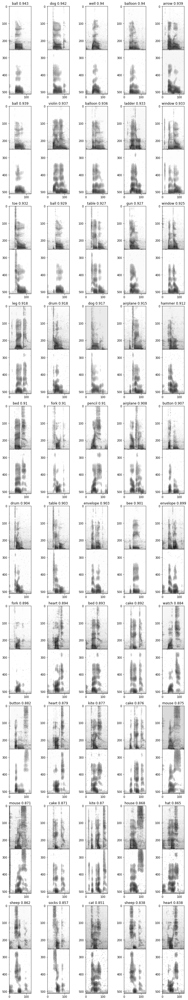

In [15]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*5))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

## MFCC

In [16]:
mse_test,pcc_test,stois_test = analyze(specmfcc_concat_a2a[:,32:],specmfcc_concat_a2a[:,:32],wave_gt_a2a,wave_pred_a2a,mode='test',ind=-1,plot=False,mcd=mcd_a2a)

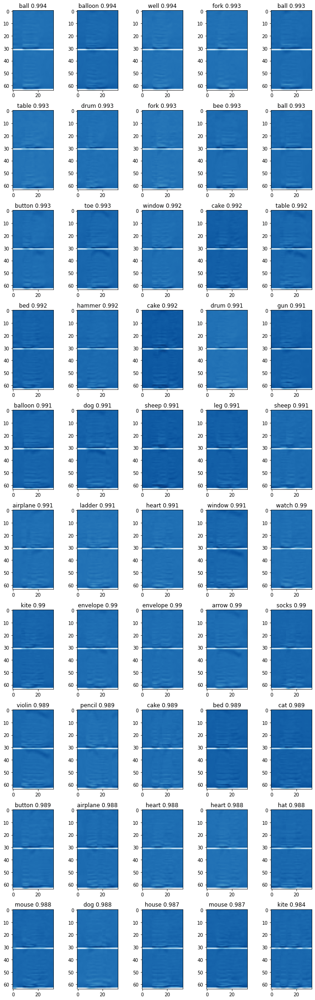

In [17]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(specmfcc_concat_a2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cm.Blues)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

# ECoG to audio
- gt
- prediction
- merge
- metrics
- spectrogram, waveform

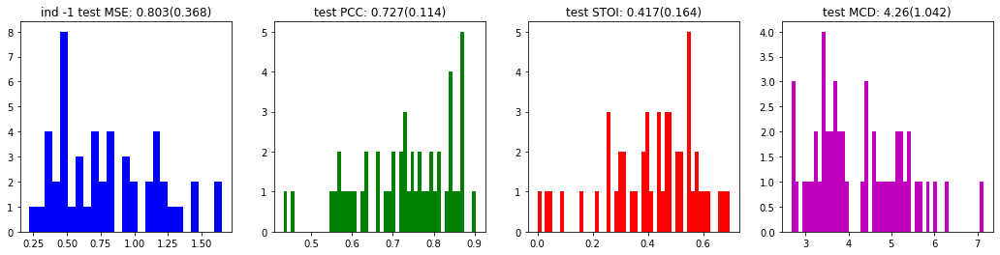

In [18]:
mse_test,pcc_test,stois_test = analyze(spec_concat_e2a[:,32:],spec_concat_e2a[:,:32],wave_gt_e2a,wave_pred_e2a,mode='test',ind=-1,plot=True,mcd=mcd_e2a)

In [19]:
wave_merge_e2a = np.concatenate(([np.concatenate((wave_gt_e2a[i*interval:(i+1)*interval],wave_pred_e2a[i*interval:(i+1)*interval]))\
                 for i in range(50)]))

In [20]:
display(ipd.Audio(wave_gt_e2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [21]:
display(ipd.Audio(wave_pred_e2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [22]:
display(ipd.Audio(wave_merge_e2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

## waveform

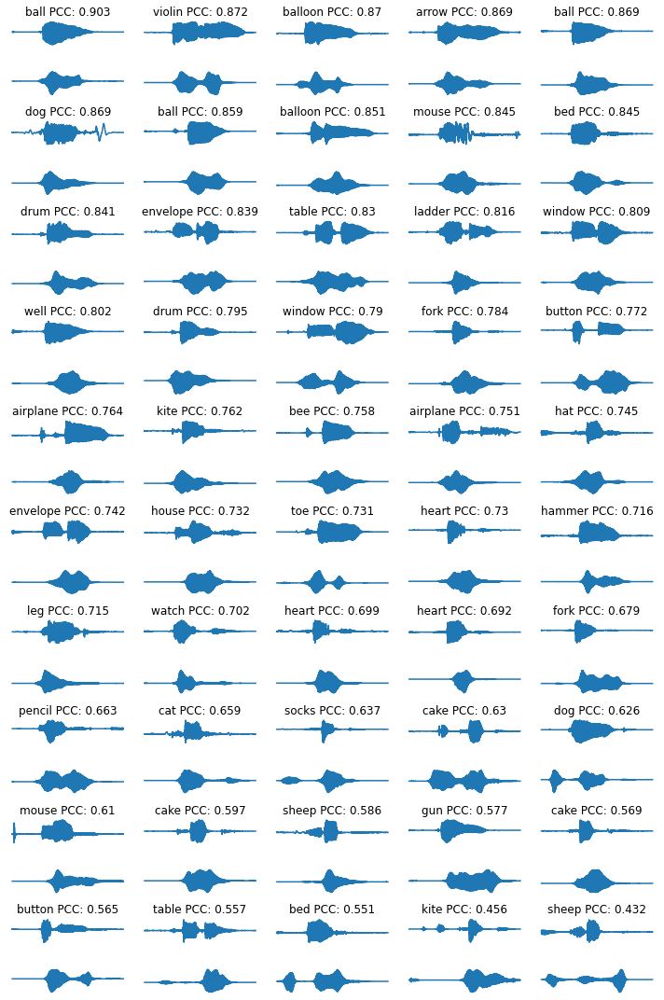

In [23]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums*2,col_nums,figsize=(col_nums*2,row_nums*1.5))
for i in range(row_nums):
    for j in range(col_nums):
        try:
            ax[i*2,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' PCC: {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
        ax[i*2,j].plot(wave_gt_e2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2+1,j].plot(wave_pred_e2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2,j].axis('off')
        ax[i*2+1,j].axis('off')
fig.tight_layout()

## mel spec

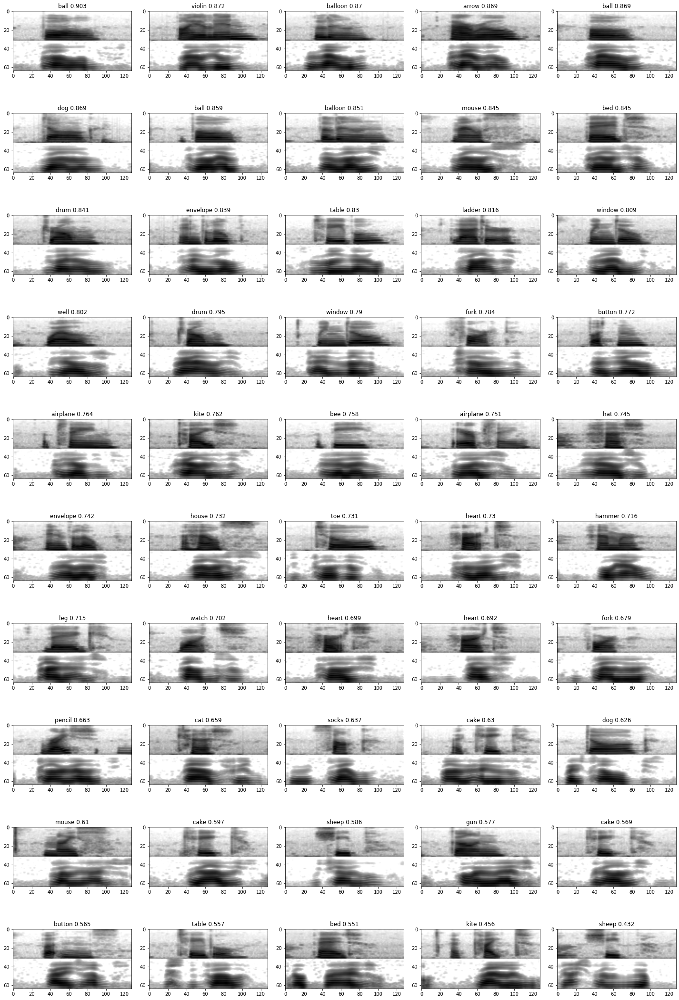

In [24]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*4,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat_e2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

In [25]:
spec_pred = np.zeros([50,256,128])
spec_gt = np.zeros([50,256,128])


for i in tqdm(range(50)):
    spec_pred[i] = plot_stft(wave_pred_e2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='linear',n_mels=64)
    spec_gt[i] = plot_stft(wave_gt_e2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='linear',n_mels=64 )

spec_concat = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)

## linear spec

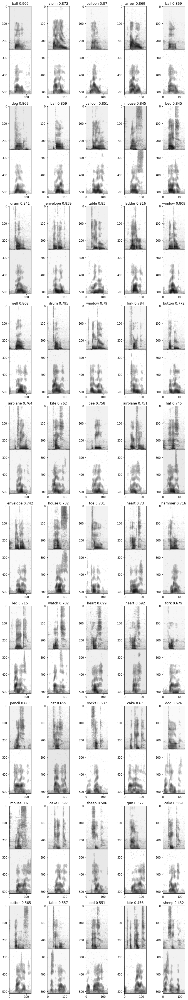

In [26]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*5))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

## MFCC

In [27]:
mse_test,pcc_test,stois_test = analyze(specmfcc_concat_e2a[:,32:],specmfcc_concat_e2a[:,:32],wave_gt_e2a,wave_pred_e2a,mode='test',ind=-1,plot=False,mcd=mcd_e2a)

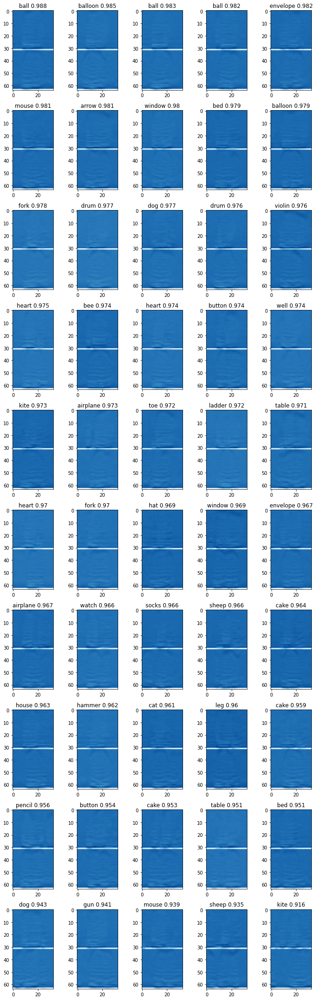

In [28]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(specmfcc_concat_e2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cm.Blues)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

# component analysis

In [165]:
loudness_dict = {717:0.00005,742:0.0001,749:0.00001}

loudness_dict = {717:0.00005,742:0.0001,749:0.00001}
for i in range(50):
    fig,ax=plt.subplots(figsize=(6,2))
    ax.plot(components_ecog['loudness'][i,0])
    ax.axhline(loudness_dict[sample_ind])

loudness_dict = {717:0.00005,742:0.0001,749:0.00001}
for i in range(20):
    fig,ax=plt.subplots( 1,figsize=(6,2))
    ax.plot(components_ecog['loudness'][i,0])
    ax.axhline(loudness_dict[sample_ind])
    fig,ax=plt.subplots( 1,figsize=(6,14))
    ax .imshow(spec_concat[word_ind][:256] ,cmap=cmap)

In [ ]:
select_keys = ['f0','loudness', 'amplitudes', 'amplitudes_h', \
                                 'freq_formants_hamon_hz', 'bandwidth_formants_hamon_hz', \
                             'amplitude_formants_hamon','freq_formants_noise_hz', \
                                'bandwidth_formants_noise_hz', 'amplitude_formants_noise']
for key in select_keys:
    print (np.swapaxes(components_ecog[key],2,1).shape)

In [220]:
keys  = ['f0_hz', 'freq_formants_hamon_hz', 'bandwidth_formants_hamon_hz', \
                             'amplitude_formants_hamon','freq_formants_noise_hz', \
             'loudness_db', 'amplitudes_db',\
                                'bandwidth_formants_noise_hz', 'amplitude_formants_noise']

In [135]:
def plotbar_msepcc(mses,pccs):
    plot_df = pd.DataFrame(np.concatenate(( np.array(mses).reshape(-1,1),\
     np.repeat('MSE',len(mses)).reshape(-1,1),\
    np.array(keys).reshape(-1,1)),axis=1))

    plot_df.columns = ['Value','Metric','Component']
    plot_df['Value'] = plot_df['Value'].astype('float')

    fig,ax=plt.subplots(1,2,figsize=(12,5))
    plot = sns.barplot(ax=ax[0],data=plot_df,x='Component',y='Value',hue='Metric',alpha=0.8)
    for item in plot.get_xticklabels():
        item.set_rotation(75)
    ax[0].set_title('Metrics')
    handles, labels = ax[0].get_legend_handles_labels()
    ax[0].legend(handles=handles[0:], labels=labels[0:])

    plot_df = pd.DataFrame(np.concatenate(( np.array(pccs).reshape(-1,1),\
     np.repeat('PCC',len(pccs)).reshape(-1,1),\
    np.array(keys).reshape(-1,1)),axis=1))

    plot_df.columns = ['Value','Metric','Component']
    plot_df['Value'] = plot_df['Value'].astype('float')

    plot = sns.barplot(ax=ax[1],data=plot_df,x='Component',y='Value',hue='Metric',alpha=0.8)
    for item in plot.get_xticklabels():
        item.set_rotation(75)
    ax[1].set_title('Metrics')
    handles, labels = ax[1].get_legend_handles_labels()
    ax[1].legend(handles=handles[0:], labels=labels[0:])
    plt.tight_layout()

result_dict = get_result_dict(sample_ind)
mse_test_e2a, pcc_test_e2a, stois_test_e2a, mcd_e2a, mfcc_e2a, \
            mse_test_a2a, pcc_test_a2a, stois_test_a2a, mcd_a2a, mfcc_a2a, components_pcc,\
            wave_gt_a2a,wave_pred_a2a, wave_gt_e2a,wave_pred_e2a, spec_concat_e2a, spec_concat_a2a,\
            specmfcc_concat_e2a,specmfcc_concat_a2a,speclin_concat_e2a,speclin_concat_a2a,\
                components,components_ecog= get_metric_from_result_dict(result_dict,sample_ind =sample_ind)

In [246]:
components['loudness_db'] = librosa.amplitude_to_db(components['loudness'], ref=np.max)
components_ecog['loudness_db'] = librosa.amplitude_to_db(components_ecog['loudness'], ref=np.max)
components['amplitudes_db'] = librosa.amplitude_to_db(components['amplitudes'], ref=np.max)
components_ecog['amplitudes_db'] = librosa.amplitude_to_db(components_ecog['amplitudes'], ref=np.max)

In [227]:
def plot_components(controls,batch,word_ind, weighted_loss=False):
    print ('------------------------------{}----------------------------------'.format('-'*len(select_word[word_ind])))
    print ('------------------------------{}----------------------------------'.format(select_word[word_ind]))
    print ('------------------------------{}----------------------------------'.format('-'*len(select_word[word_ind])))
    display(ipd.Audio(wave_merge_e2a.reshape(50,-1)[word_ind].ravel(),rate=16000))
    fig,ax=plt.subplots(figsize=(6,6))
    ax.imshow(np.concatenate((spec_concat[word_ind][:256],\
                              spec_concat[word_ind][256:] ),axis=1),cmap=cmap)
    ax.set_title(select_word[word_ind]+' {0:.3g}'.format(pcc_test[word_ind]))

    num = len(keys)
    fig,ax=plt.subplots(num,2,figsize=(12,num*2))
    if weighted_loss ==1:
        '''
        tmp_latend_ind = np.where(batch['latent_indicator']==1)[1]
        tmp_latend_ind_ = np.where(batch['latent_indicator']!=1)[1]
        for i in range(num):
            gttmp = batch[keys[i]].numpy()
            pretmp = controls[keys[i]].numpy()
            tmpmax = max(np.max(gttmp),np.max(pretmp))
            gttmp[:,tmp_latend_ind_] = np.nan
            pretmp[:,tmp_latend_ind_] = np.nan
            ax[i,0].plot(pretmp[0]);
            ax[i,1].plot(gttmp[0]);
            ax[i,0].set_ylim(0,tmpmax)
            ax[i,1].set_ylim(0,tmpmax)
            try:
                pcc = pearsonr(batch[keys[i]].numpy()[:,tmp_latend_ind].ravel(), \
                    controls[keys[i]].numpy()[:,tmp_latend_ind].ravel())[0]
                ax[i,0].set_title(keys[i]+' '+str(pcc)[:5])
            except:
                ax[i,0].set_title(keys[i])
            ax[i,1].set_title('gt '+keys[i])
        '''    
        tmpind = np.where(batch['loudness'][word_ind,0]>=loudness_dict[sample_ind])[0]
        tmpind_ = np.where(batch['loudness'][word_ind,0]<loudness_dict[sample_ind])[0]
        mses = []
        pccs = []
        for i in range(num):
            gttmp = np.swapaxes(batch[keys[i]][word_ind],1,0)
            pretmp = np.swapaxes(controls[keys[i]][word_ind],1,0)
            tmpmax = max(np.max(gttmp),np.max(pretmp))
            #print (tmpmax,keys[i])
            gttmp[tmpind_] = np.nan
            pretmp[tmpind_] = np.nan
            ax[i,0].plot(pretmp );
            ax[i,1].plot(gttmp );
            ax[i,0].set_ylim(0,tmpmax)
            ax[i,1].set_ylim(0,tmpmax)
            mse,pcc = MSE_pcc(gttmp[tmpind],pretmp[tmpind],ax=None)
            pccs.append(pcc)
            mses.append(mse)
            ax[i,0].set_title(keys[i]+' PCC: {}, MSE: {} '.format(str(pcc)[:5],str(mse)[:5]))
            ax[i,1].set_title('gt '+keys[i])
            ax[i,0].set_xlim(0,128)
            ax[i,1].set_xlim(0,128)
            #ax[i,0].axvspan(tmpind[0],tmpind[-1], color='green', alpha=0.1)
            #ax[i,1].axvspan(tmpind[0],tmpind[-1], color='green', alpha=0.1)
    else:
        for i in range(num):
            gttmp = np.swapaxes(batch[keys[i]][word_ind],1,0)
            pretmp = np.swapaxes(controls[keys[i]][word_ind],1,0)
            tmpmax = max(np.max(gttmp),np.max(pretmp))
            
            ax[i,0].plot(pretmp );
            ax[i,1].plot(gttmp );
            ax[i,0].set_ylim(0,tmpmax)
            ax[i,1].set_ylim(0,tmpmax)
            mse,pcc = MSE_pcc(gttmp,pretmp,ax=None)
            ax[i,0].set_title(keys[i]+' PCC: {}, MSE: {} '.format(str(pcc)[:5],str(mse)[:5]))
            ax[i,1].set_title('gt '+keys[i])
            #ax.axvspan(3, 6, color='red', alpha=0.5)
    plt.tight_layout()
    plotbar_msepcc(mses,pccs)
    plt.show()
    return np.array(pccs), np.array(mses)

import copy
components_ecog_copy = copy.deepcopy(components_ecog)
components_copy = copy.deepcopy(components)

## ECoG to audio recon

for i in range(50):
    print (i,select_word[i])
    display(ipd.Audio(wave_merge_e2a.reshape(50,-1)[i].ravel()[interval:],rate=16000))

In [ ]:
#717 intelligible: 15 well, 19 ball 21 envelope 42 ball  48 mouse
#717 partially intell 4 dog 5 arrow  2 violin 16 envelope 36 house  39 mouse

#742 intelligible:  5 cow  7 glasses  9 leg  22 house  42 hat  44 envelope  48 ball
#742 partially intell   12 table 13 airplane 26 watch  28 violin  38 knife 43 well  49 flag

#749 intelligible:   15 well  35 toe  48 glasses
#749 partially intell   3 hat 11 ball  14 leg 20 envelope  43 duck

In [171]:
intelligible_dict = {}
intelligible_dict[717] = np.array([15,19,21,42,48])
intelligible_dict[742] = np.array([5,7,9,22,42,44,48])
intelligible_dict[749] = np.array([15,35,48 ])

part_intelligible_dict = {}
part_intelligible_dict[717] = np.array([4,5,2,16,36,39])
part_intelligible_dict[742] = np.array([12,13,26,28,38,43,49])
part_intelligible_dict[749] = np.array([3,11,14,20,43 ])

In [244]:
pccs_df = pd.DataFrame(index=np.arange(0,50),columns = keys)
mses_df = pd.DataFrame(index=np.arange(0,50),columns = keys)

## intelligible audio

result_dict = get_result_dict(sample_ind)
mse_test_e2a, pcc_test_e2a, stois_test_e2a, mcd_e2a, mfcc_e2a, \
            mse_test_a2a, pcc_test_a2a, stois_test_a2a, mcd_a2a, mfcc_a2a, components_pcc,\
            wave_gt_a2a,wave_pred_a2a, wave_gt_e2a,wave_pred_e2a, spec_concat_e2a, spec_concat_a2a,\
            specmfcc_concat_e2a,specmfcc_concat_a2a,speclin_concat_e2a,speclin_concat_a2a,\
                components,components_ecog= get_metric_from_result_dict(result_dict,sample_ind =sample_ind)

--------------------------------------------------------------------
------------------------------well----------------------------------
--------------------------------------------------------------------


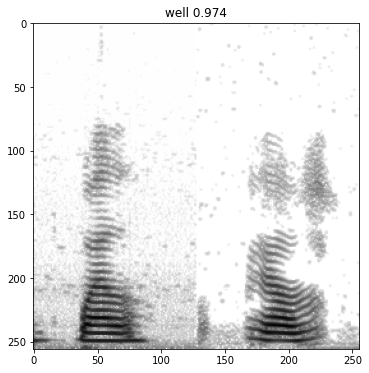

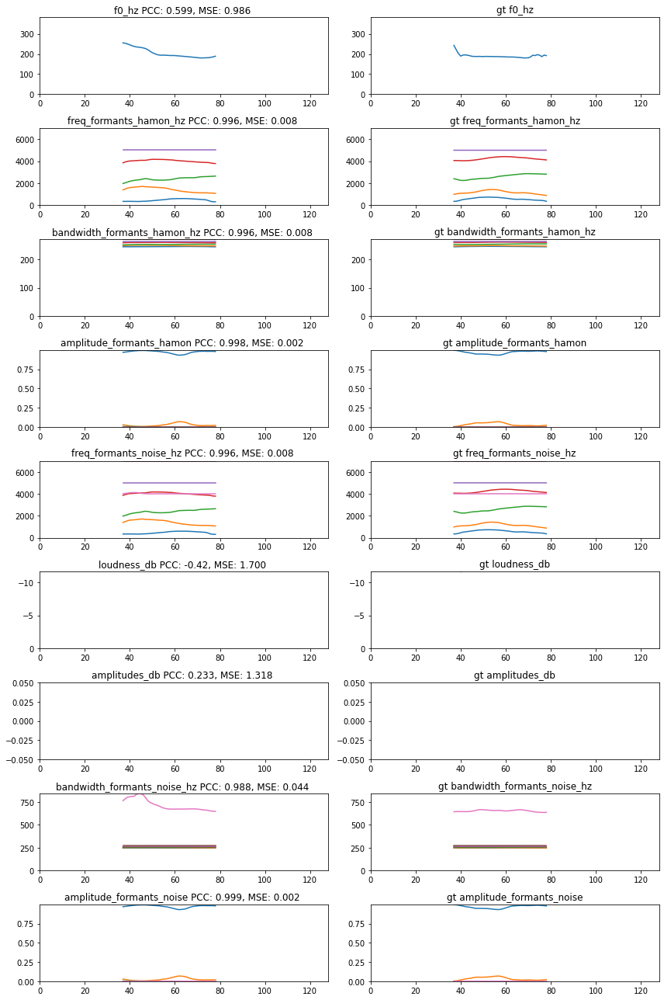

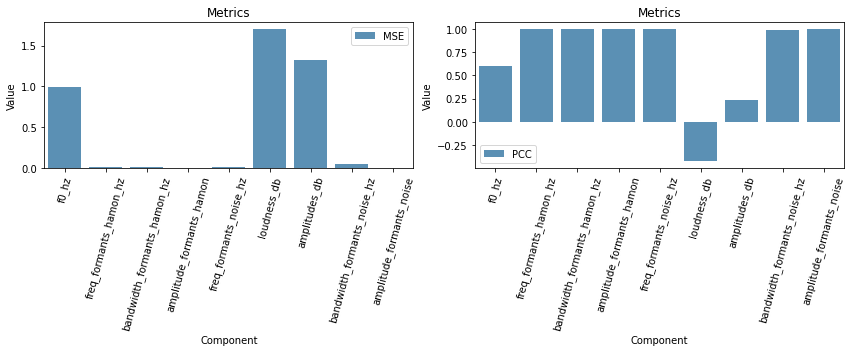

--------------------------------------------------------------------
------------------------------ball----------------------------------
--------------------------------------------------------------------


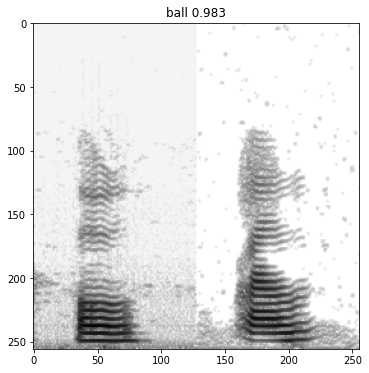

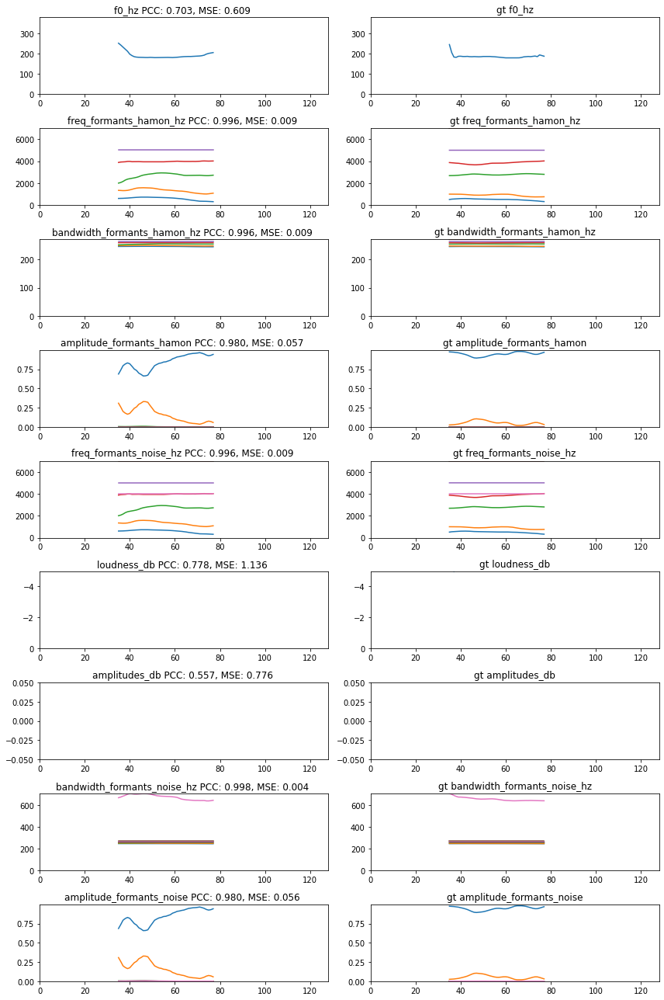

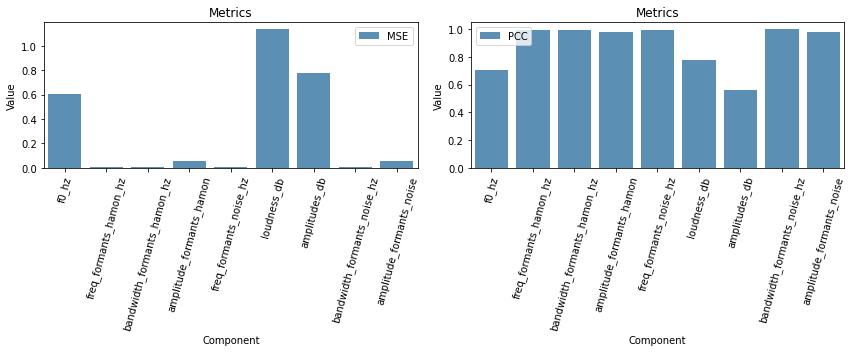

------------------------------------------------------------------------
------------------------------envelope----------------------------------
------------------------------------------------------------------------


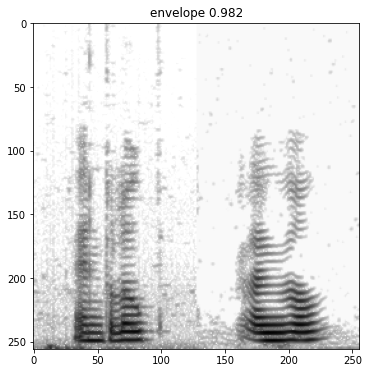

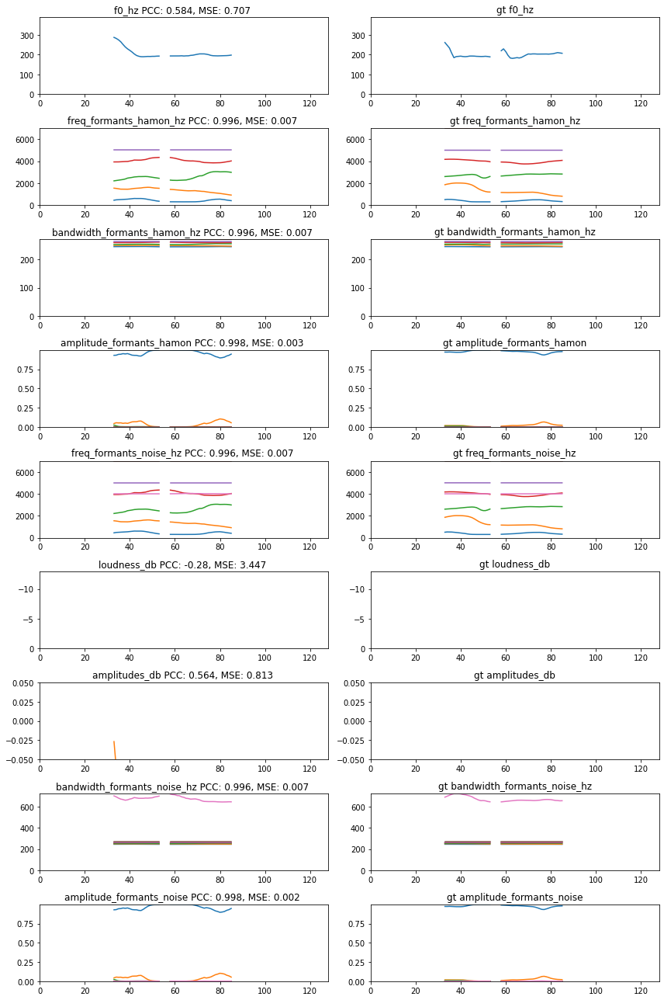

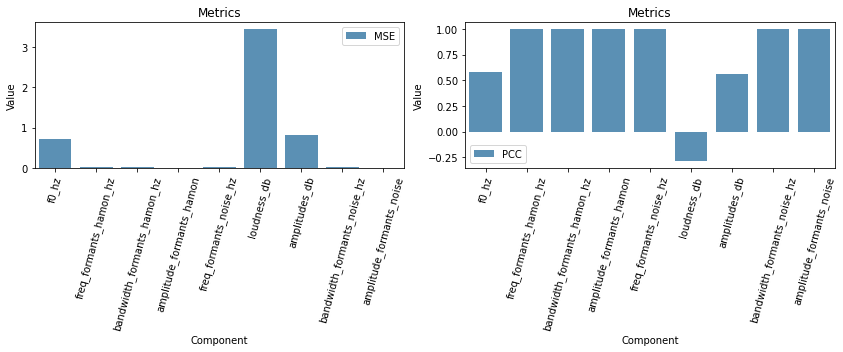

--------------------------------------------------------------------
------------------------------ball----------------------------------
--------------------------------------------------------------------


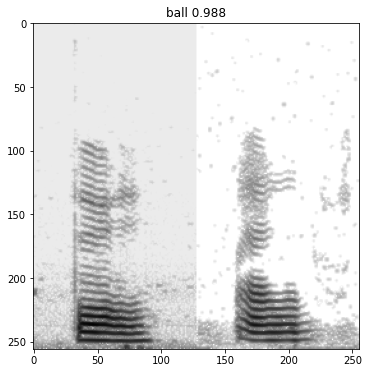

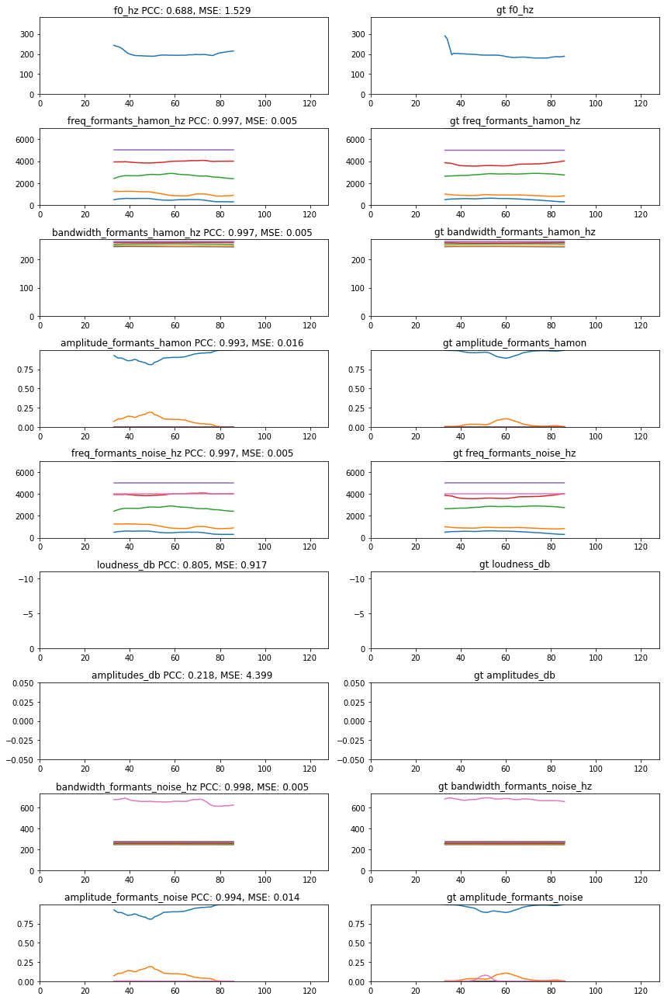

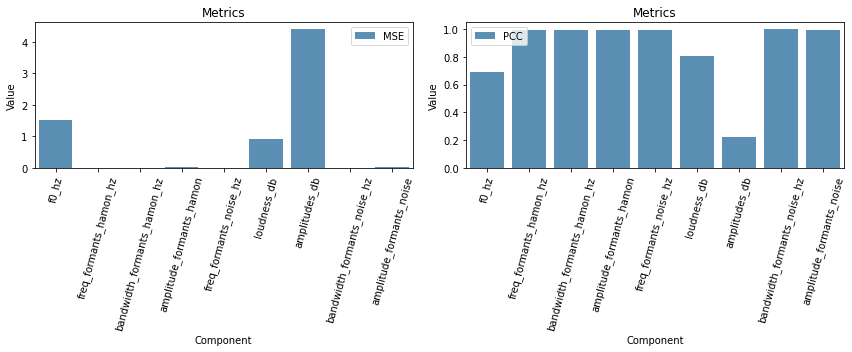

---------------------------------------------------------------------
------------------------------mouse----------------------------------
---------------------------------------------------------------------


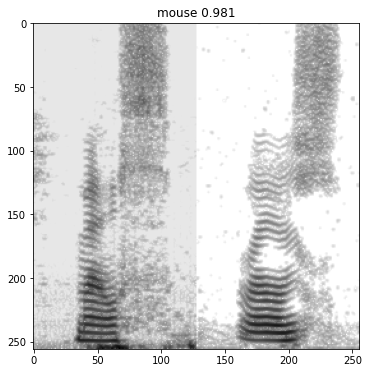

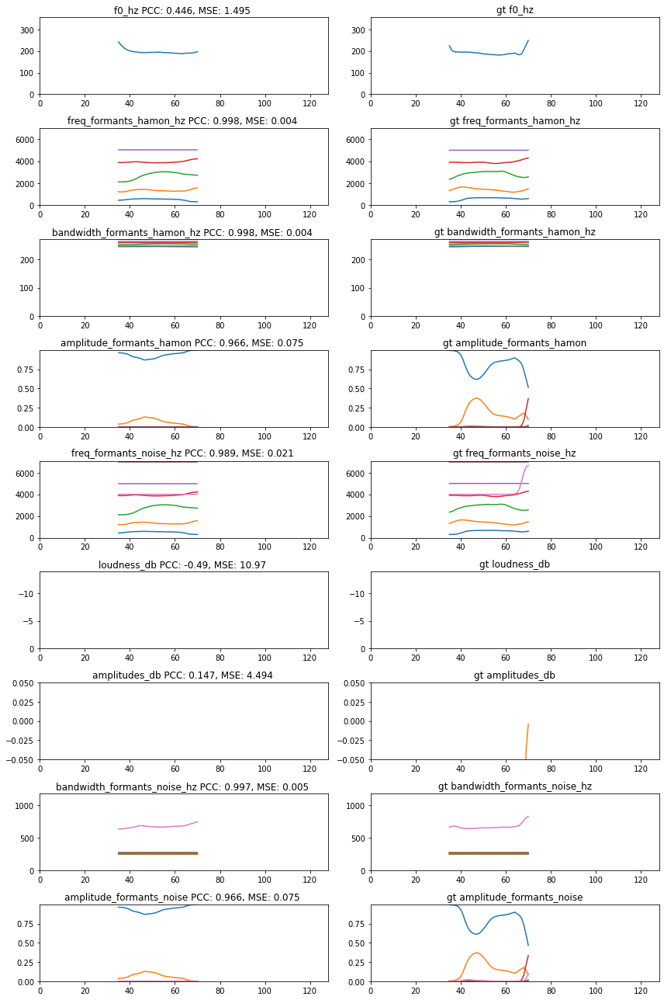

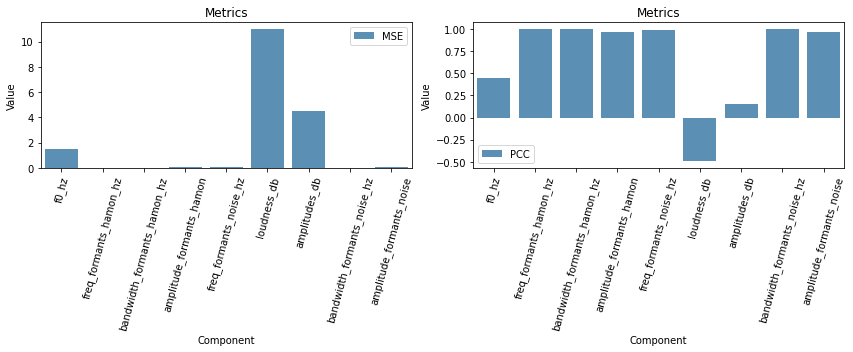

In [248]:
for word_ind in intelligible_dict[sample_ind]:
    pccstmp, msestmp = plot_components(components_ecog ,components ,word_ind=word_ind, \
                                       weighted_loss=1)
    pccs_df.iloc[word_ind] = pccstmp
    mses_df.iloc[word_ind] = msestmp

## part of the audio is intelligible

-------------------------------------------------------------------
------------------------------dog----------------------------------
-------------------------------------------------------------------


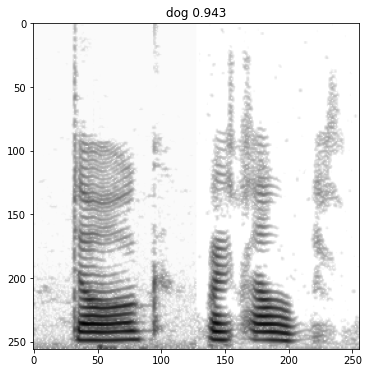

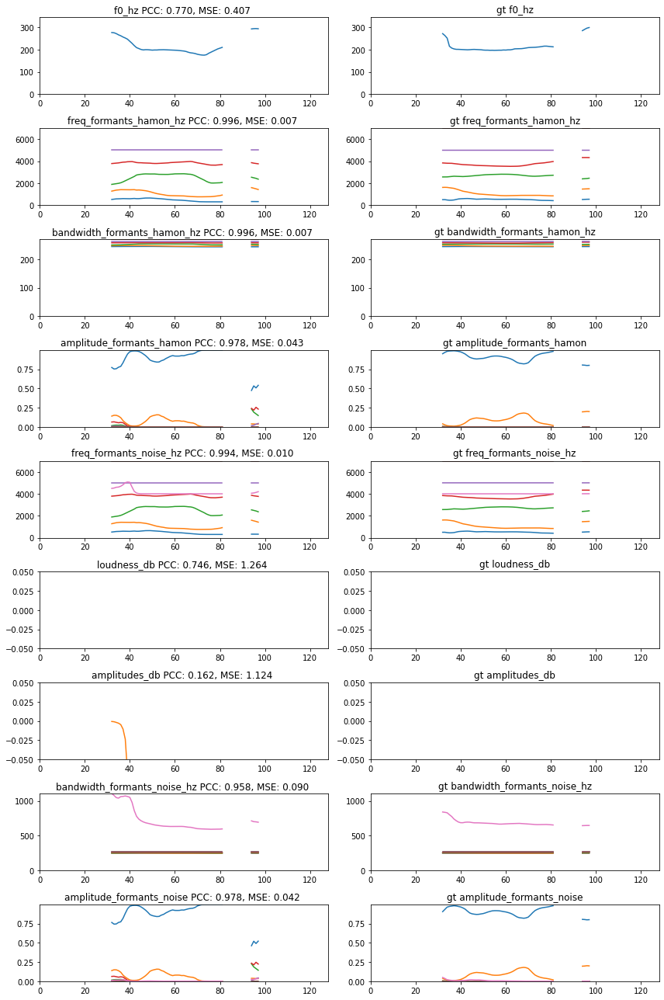

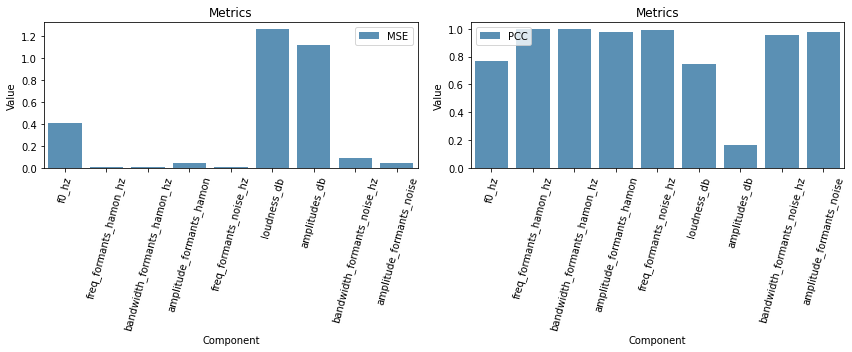

---------------------------------------------------------------------
------------------------------arrow----------------------------------
---------------------------------------------------------------------


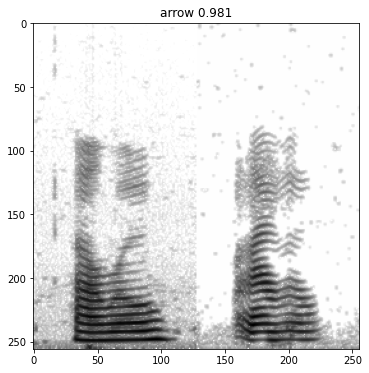

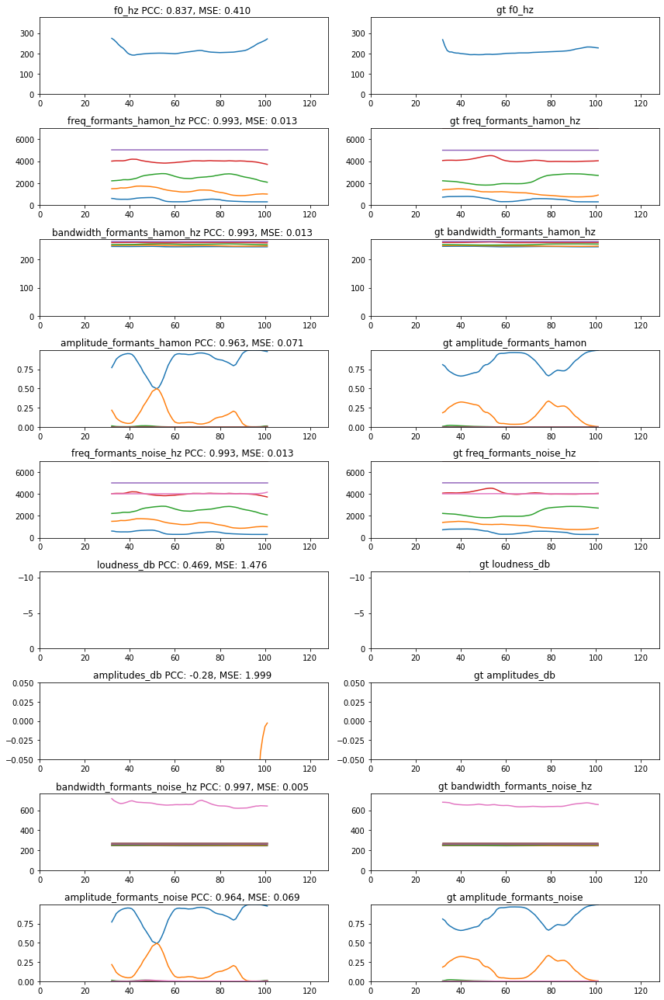

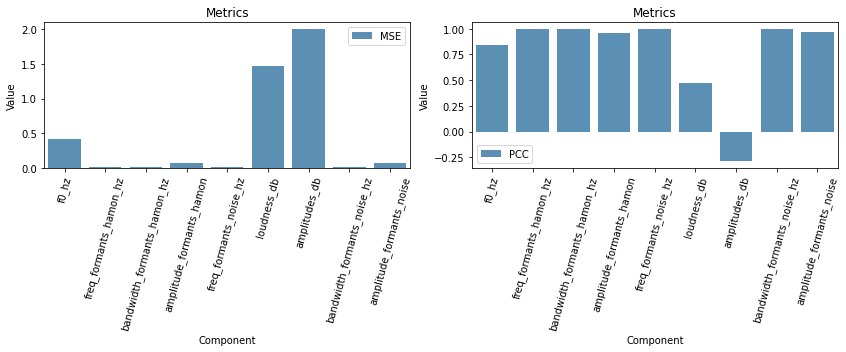

----------------------------------------------------------------------
------------------------------violin----------------------------------
----------------------------------------------------------------------


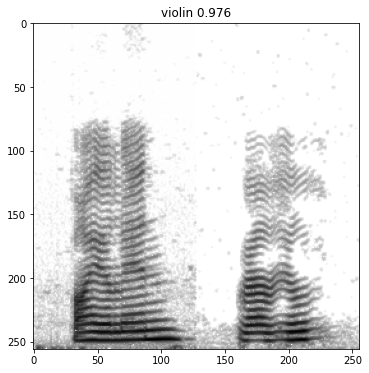

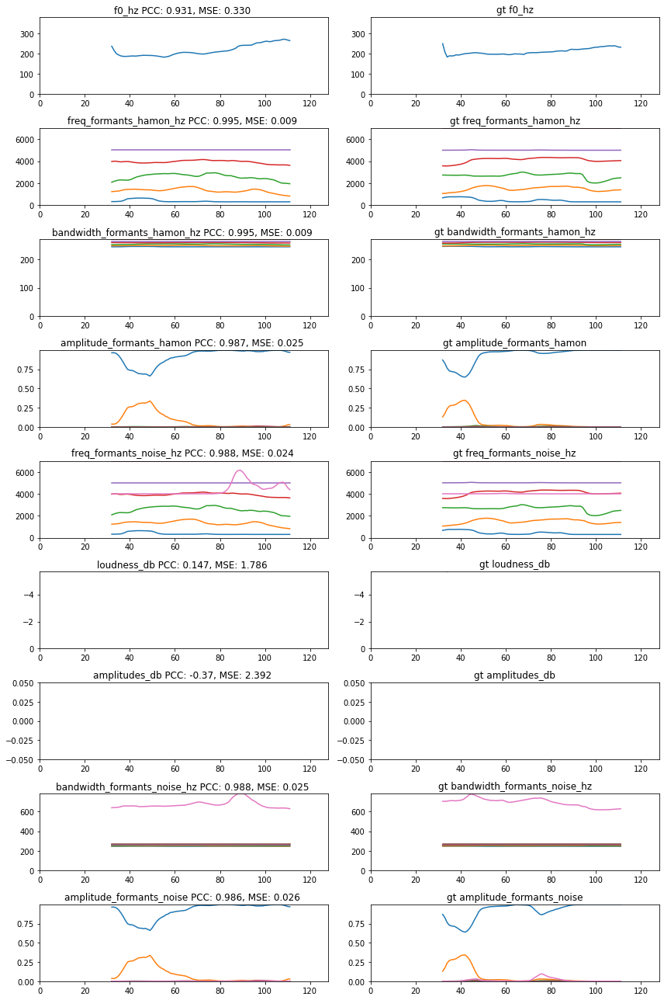

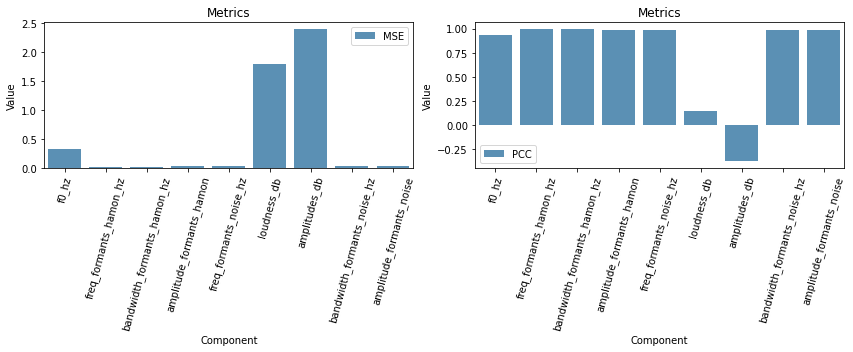

------------------------------------------------------------------------
------------------------------envelope----------------------------------
------------------------------------------------------------------------


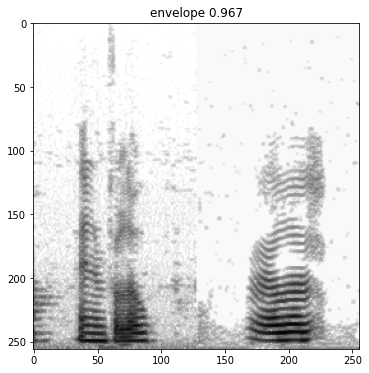

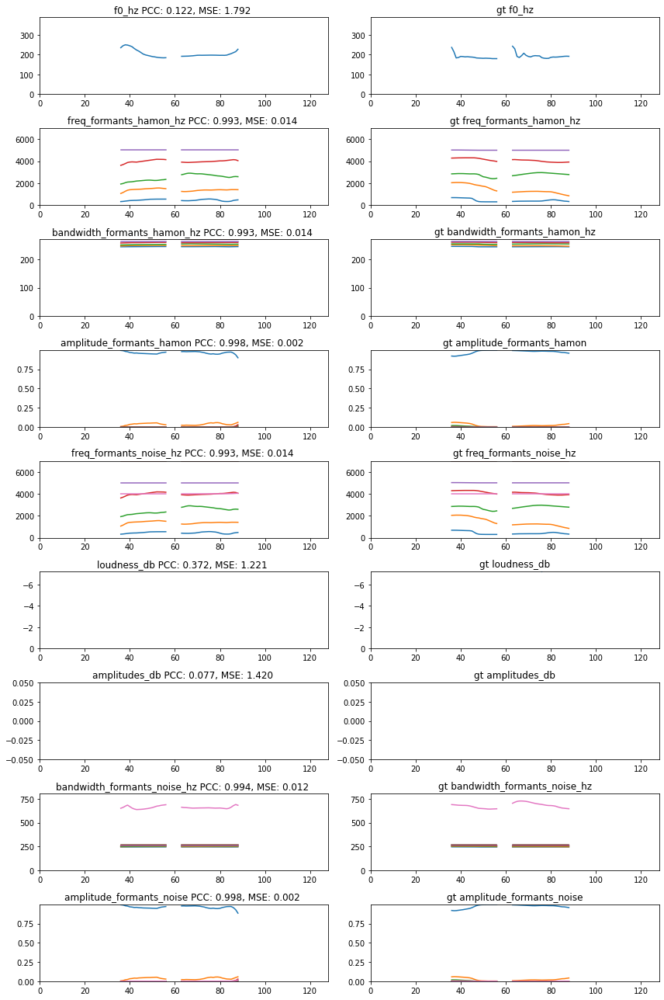

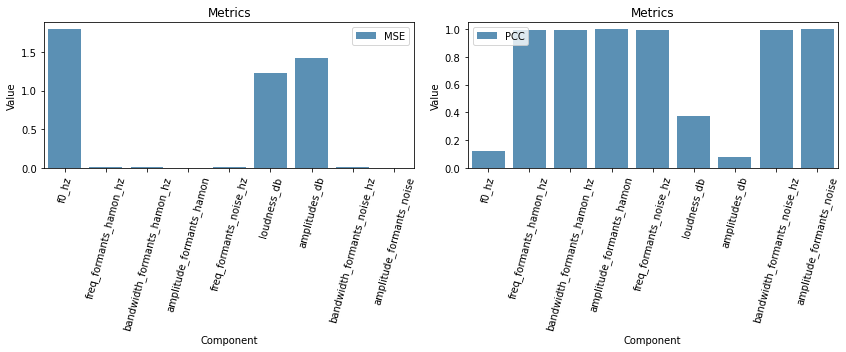

---------------------------------------------------------------------
------------------------------house----------------------------------
---------------------------------------------------------------------


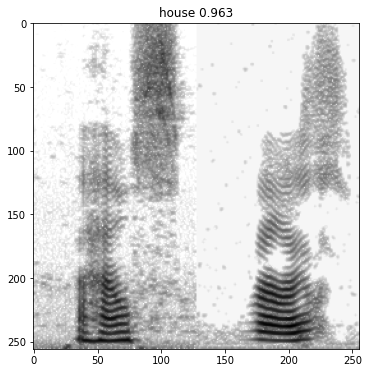

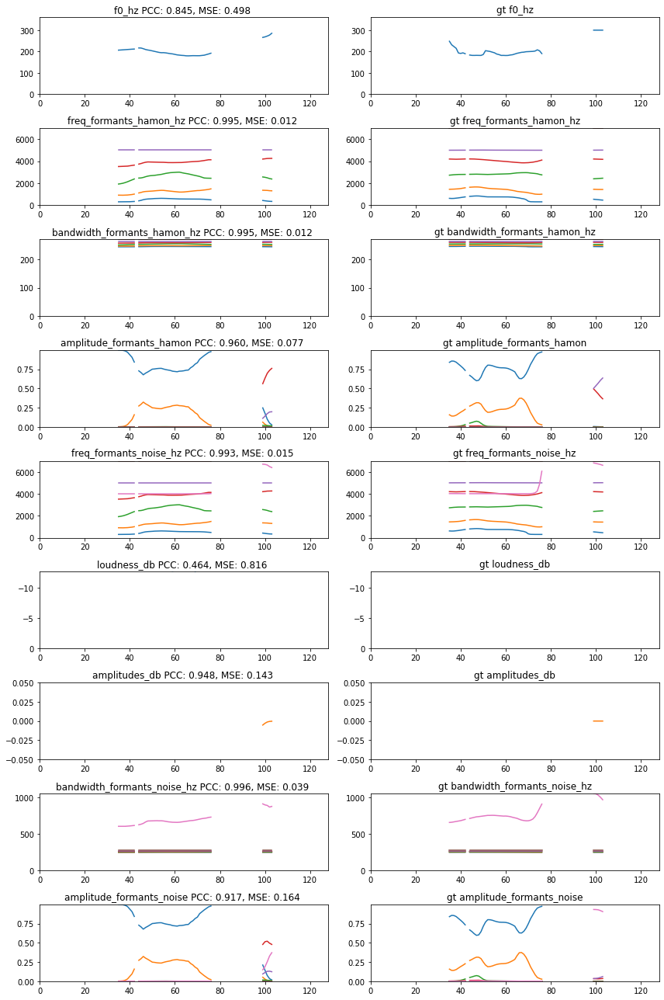

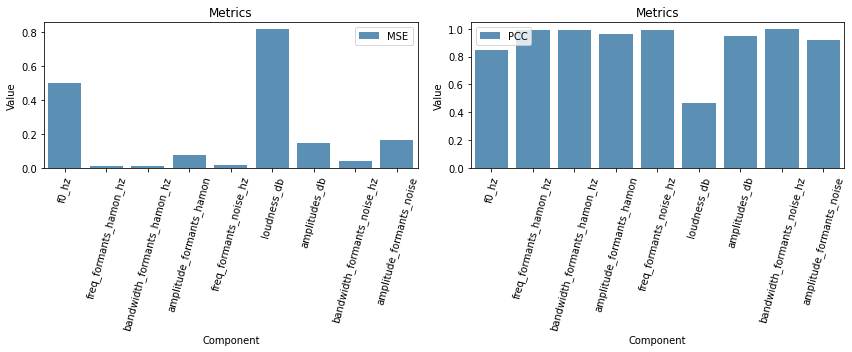

---------------------------------------------------------------------
------------------------------mouse----------------------------------
---------------------------------------------------------------------


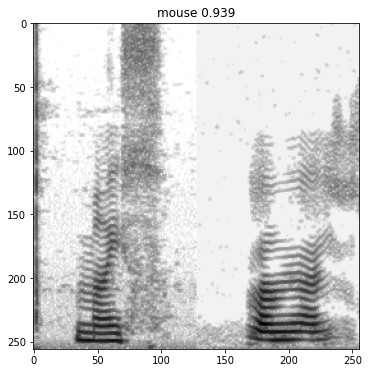

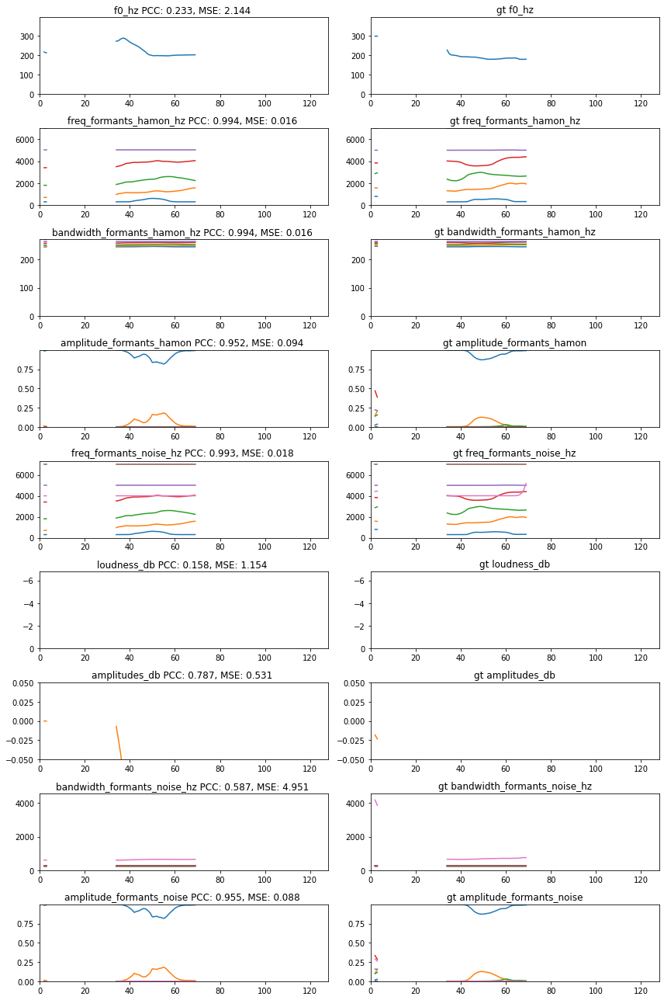

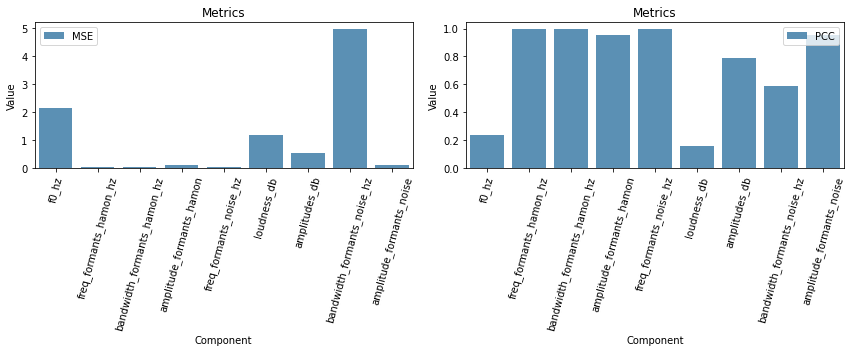

In [249]:
for word_ind in part_intelligible_dict[sample_ind]:
    pccstmp, msestmp = plot_components(components_ecog ,components ,word_ind=word_ind, \
                                       weighted_loss=1)
    pccs_df.iloc[word_ind] = pccstmp
    mses_df.iloc[word_ind] = msestmp

## others

-------------------------------------------------------------------
------------------------------bed----------------------------------
-------------------------------------------------------------------


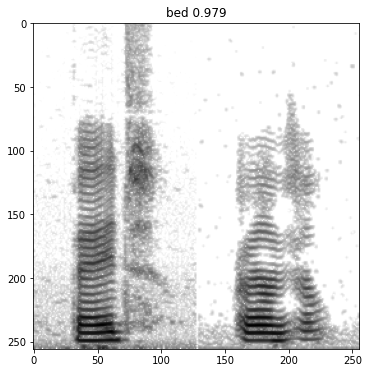

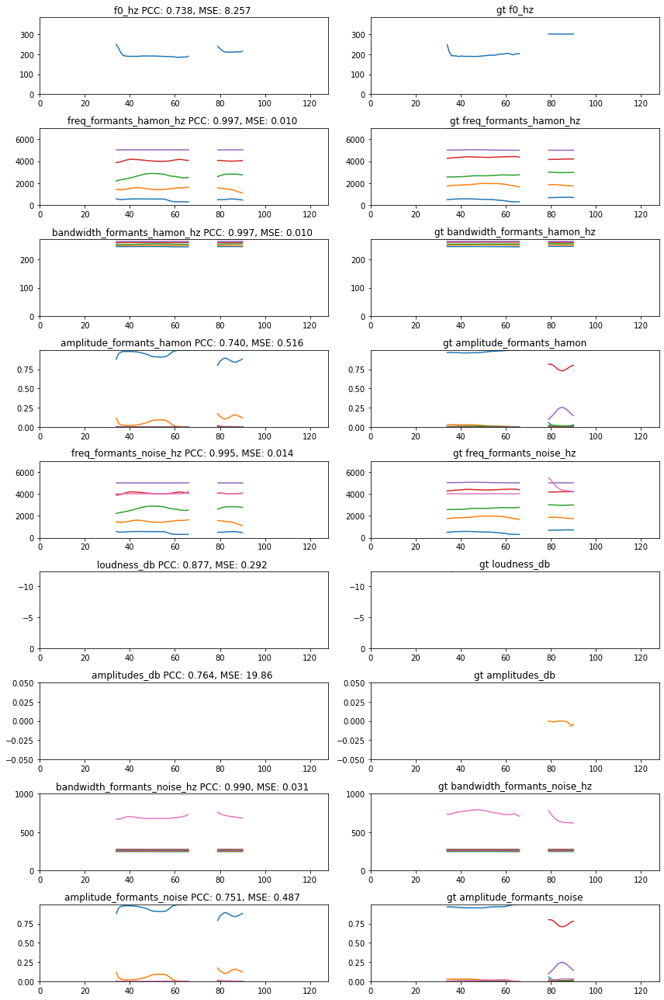

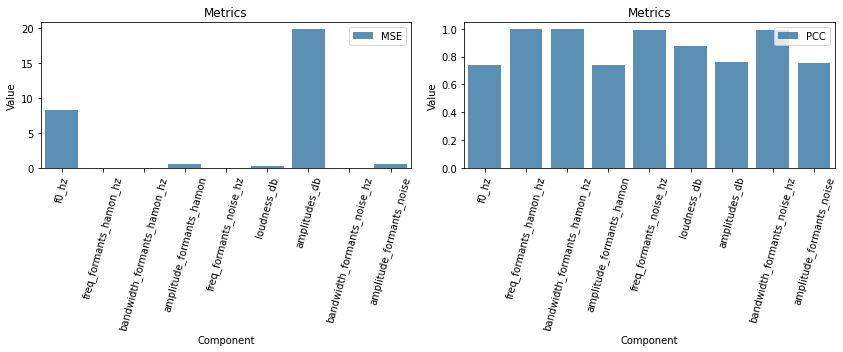

-------------------------------------------------------------------
------------------------------toe----------------------------------
-------------------------------------------------------------------


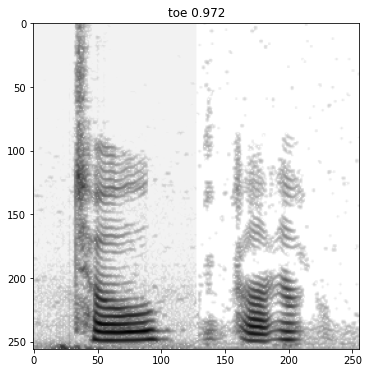

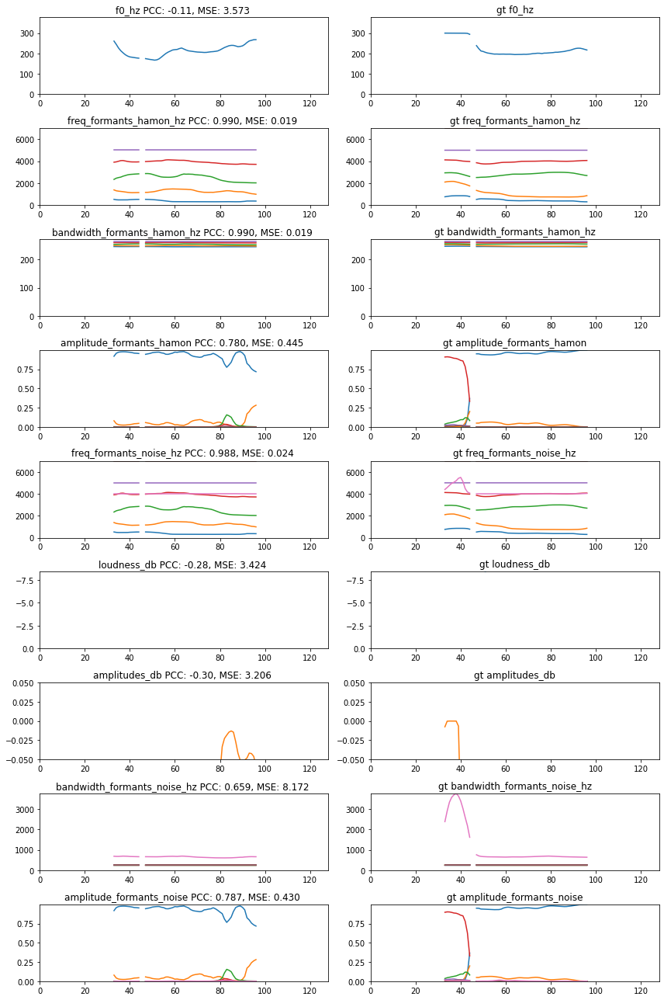

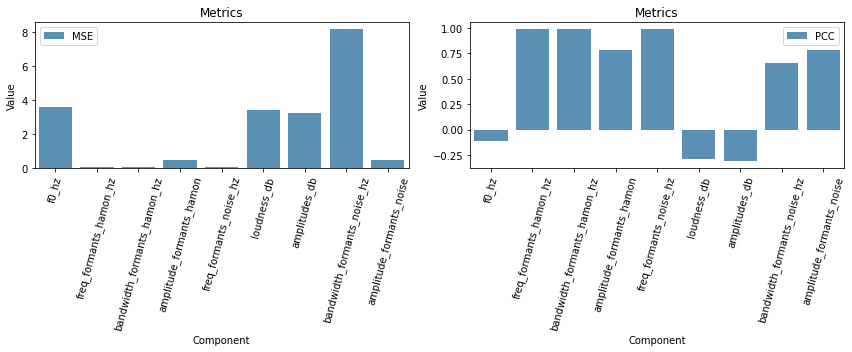

---------------------------------------------------------------------
------------------------------table----------------------------------
---------------------------------------------------------------------


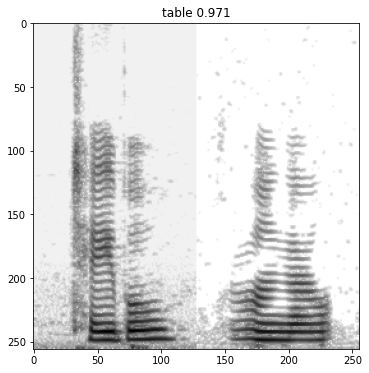

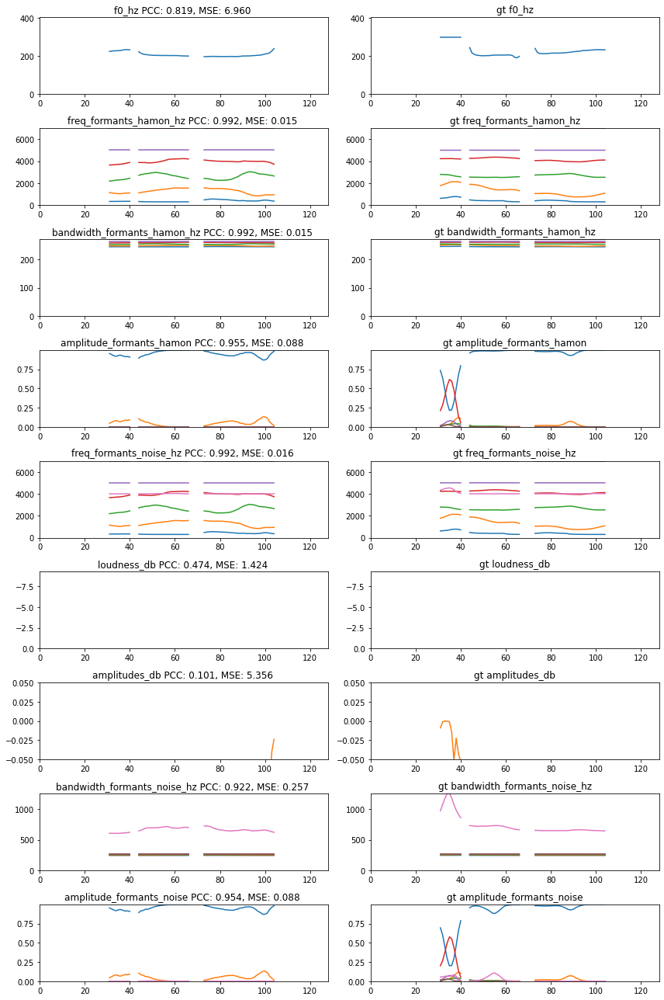

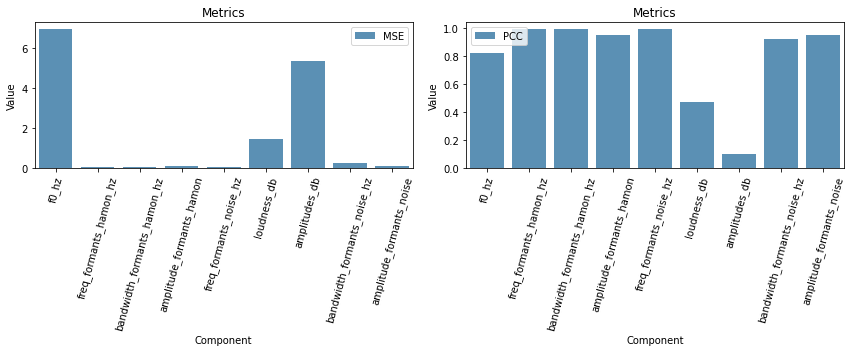

-------------------------------------------------------------------
------------------------------leg----------------------------------
-------------------------------------------------------------------


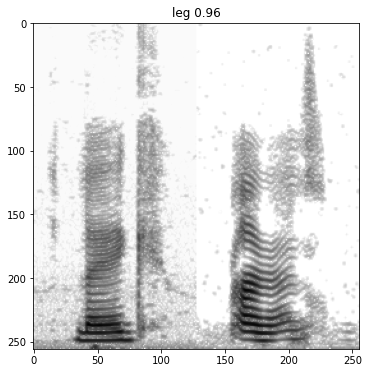

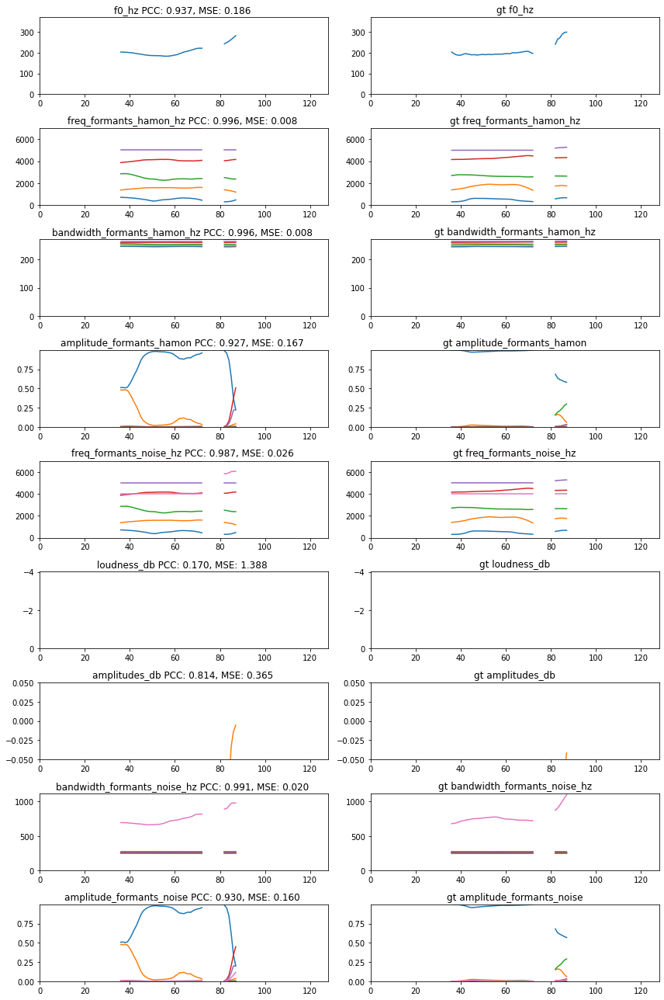

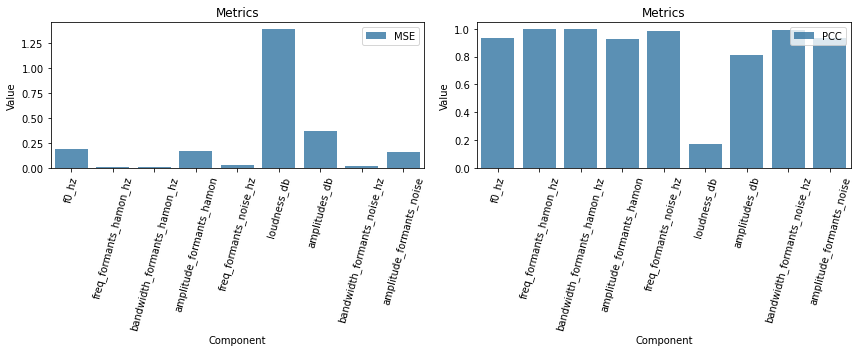

----------------------------------------------------------------------
------------------------------window----------------------------------
----------------------------------------------------------------------


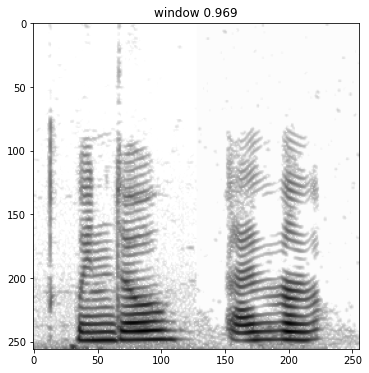

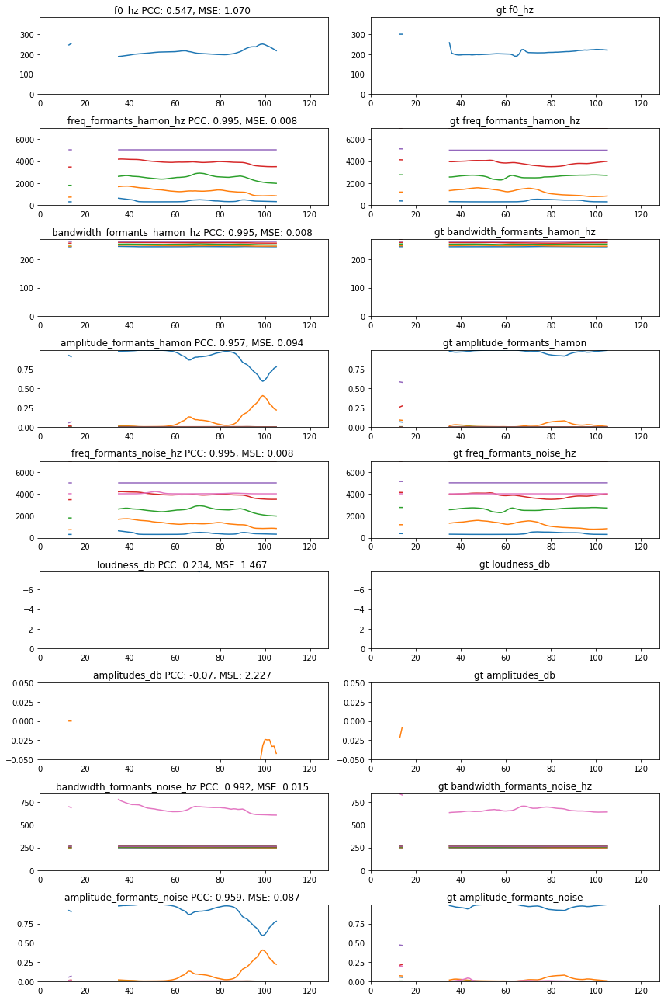

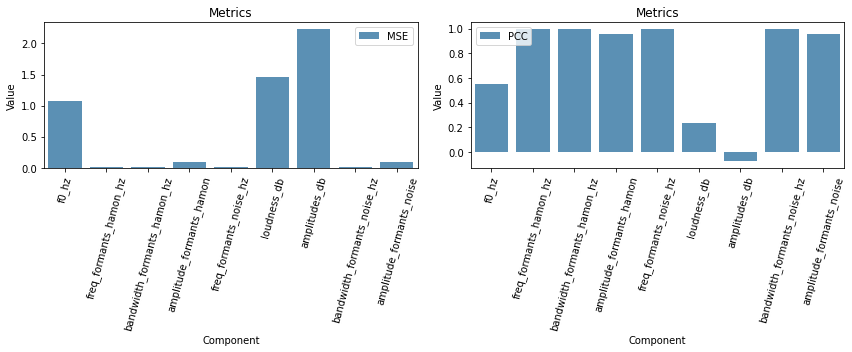

----------------------------------------------------------------------
------------------------------button----------------------------------
----------------------------------------------------------------------


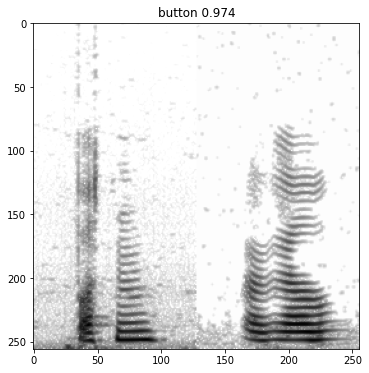

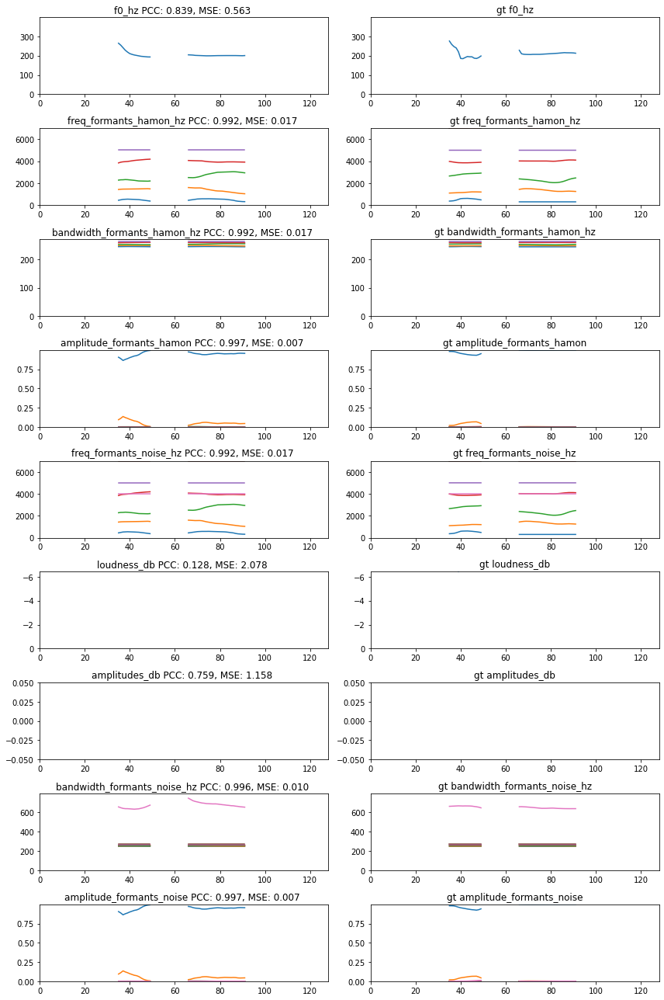

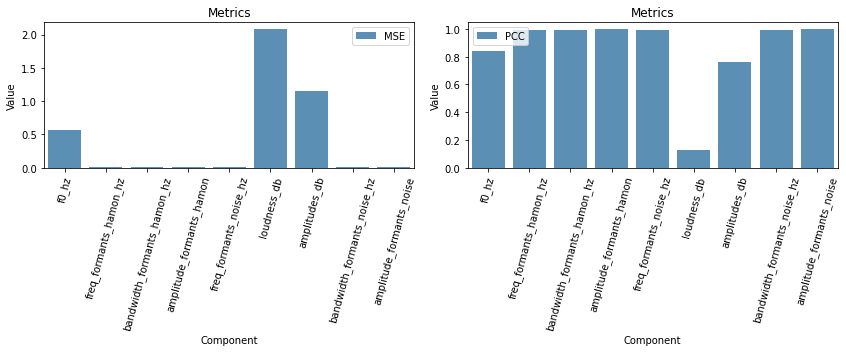

--------------------------------------------------------------------
------------------------------cake----------------------------------
--------------------------------------------------------------------


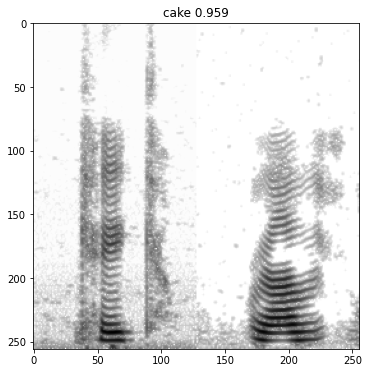

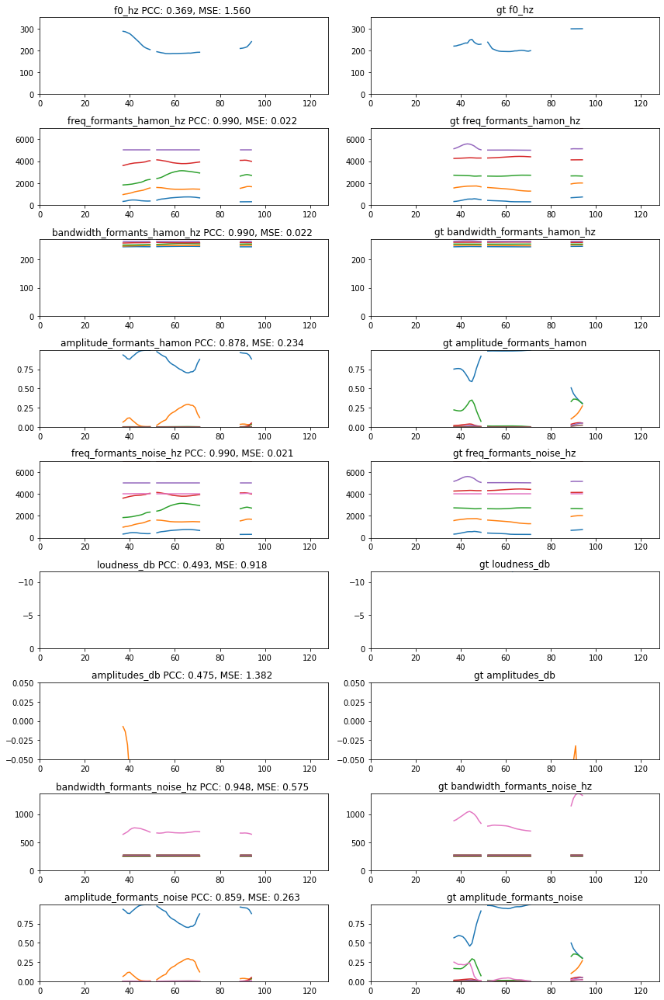

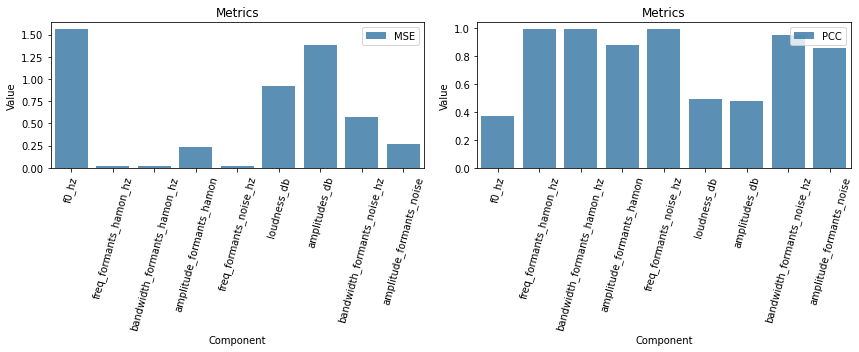

----------------------------------------------------------------------
------------------------------pencil----------------------------------
----------------------------------------------------------------------


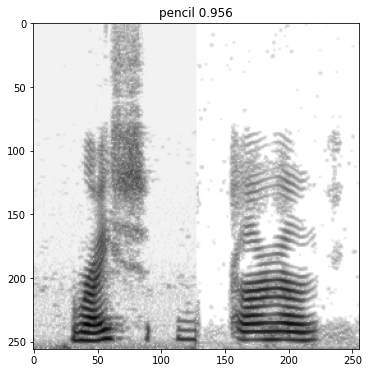

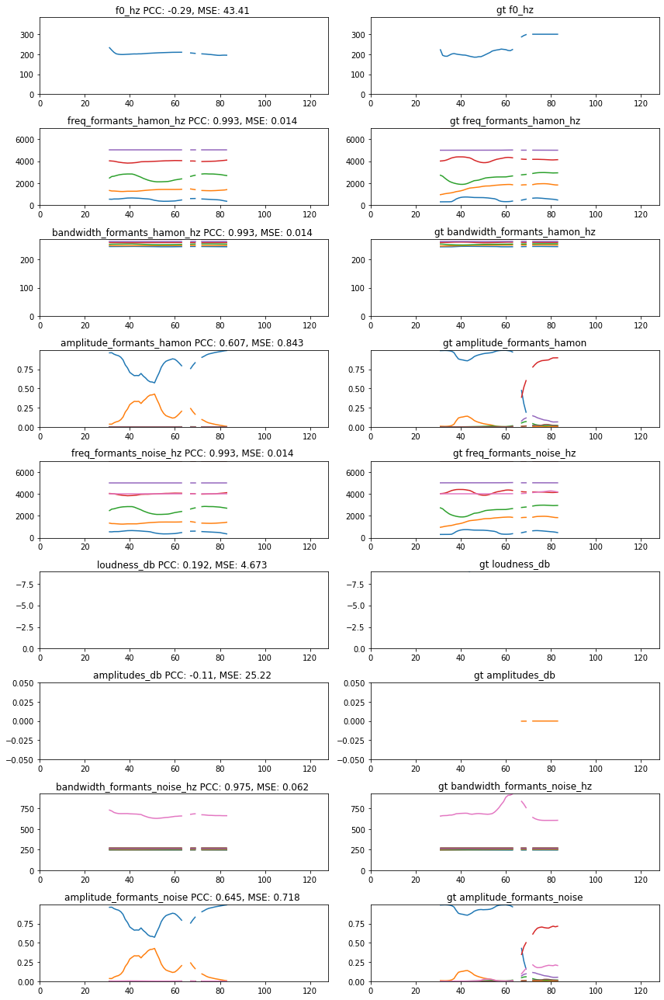

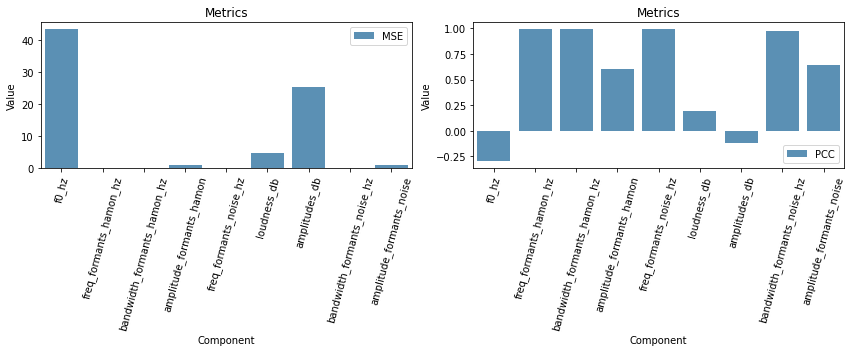

---------------------------------------------------------------------
------------------------------sheep----------------------------------
---------------------------------------------------------------------


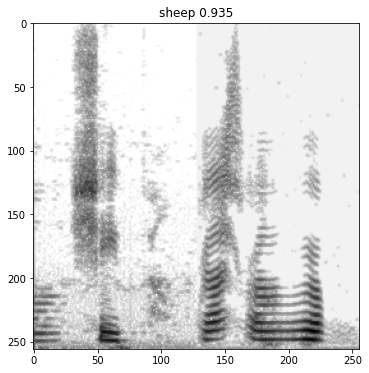

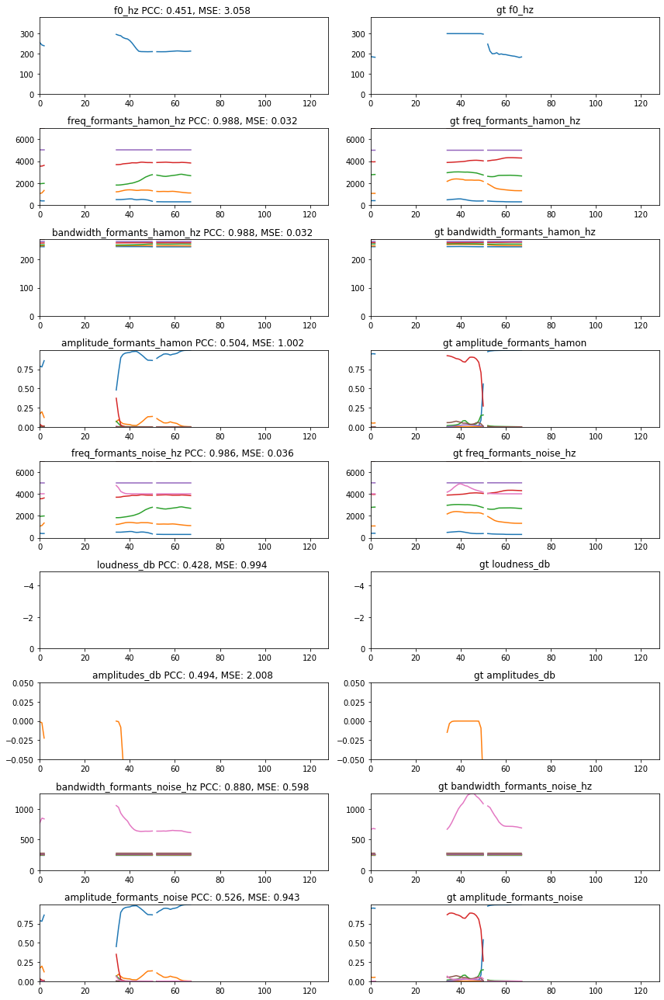

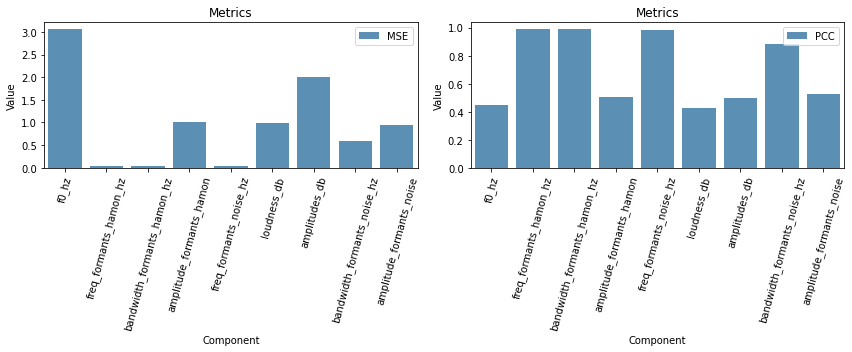

----------------------------------------------------------------------
------------------------------window----------------------------------
----------------------------------------------------------------------


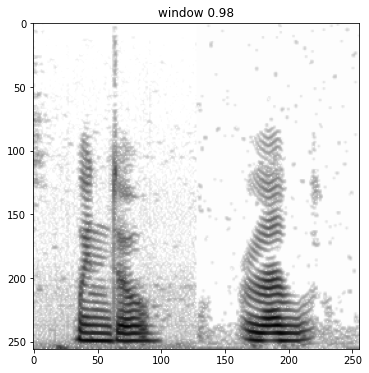

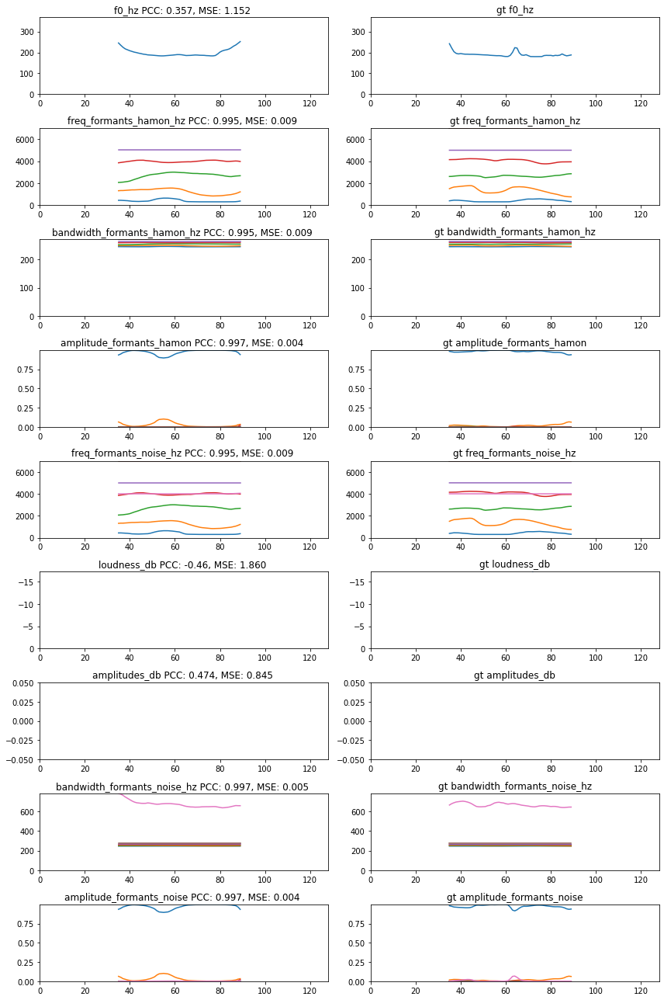

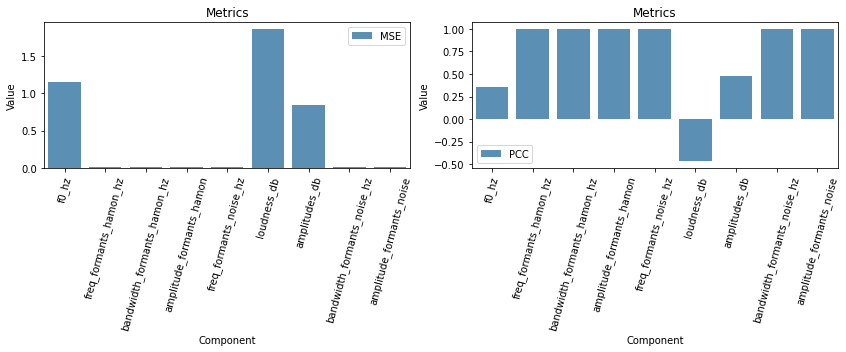

--------------------------------------------------------------------
------------------------------fork----------------------------------
--------------------------------------------------------------------


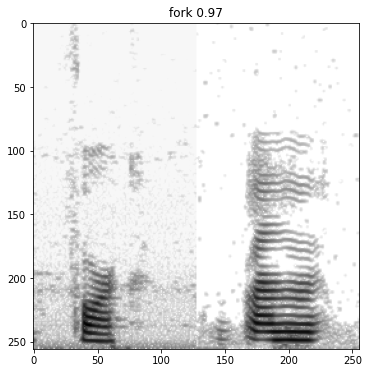

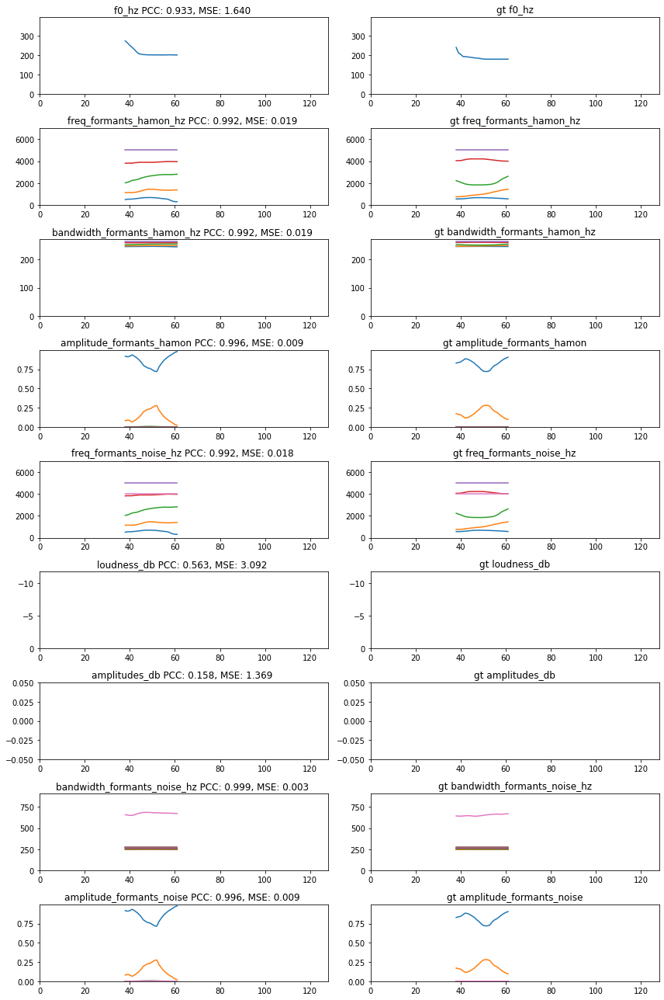

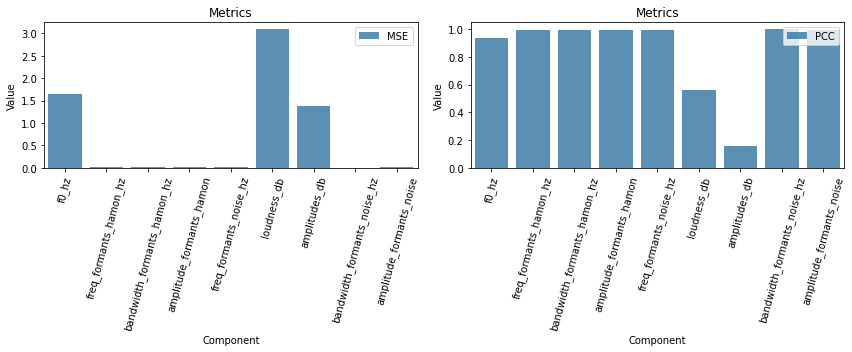

-------------------------------------------------------------------
------------------------------hat----------------------------------
-------------------------------------------------------------------


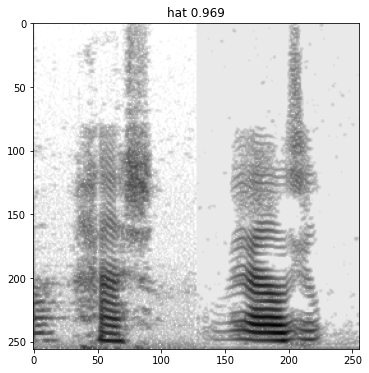

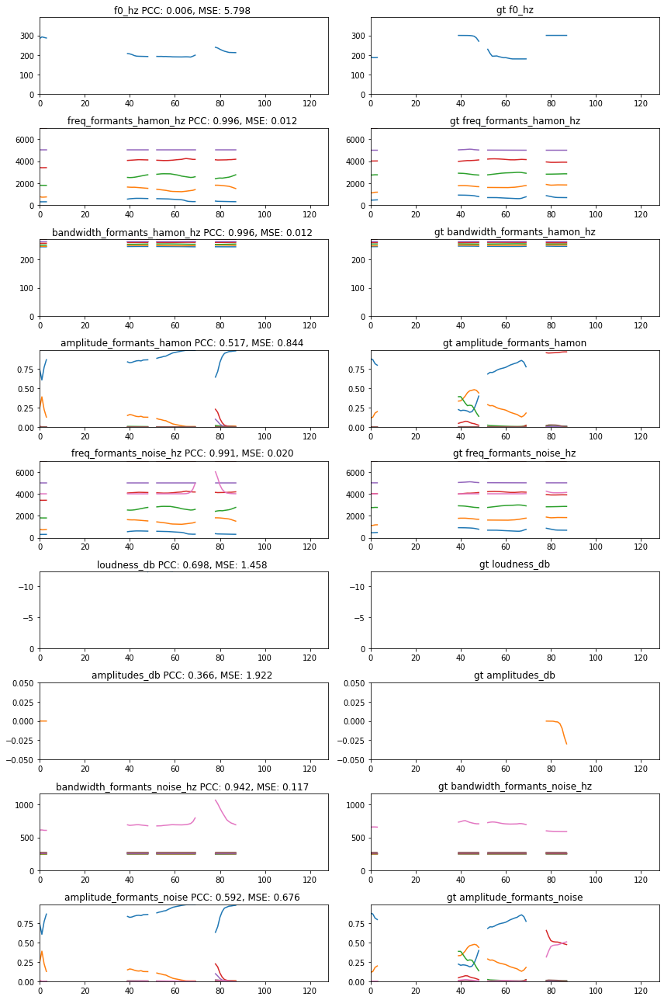

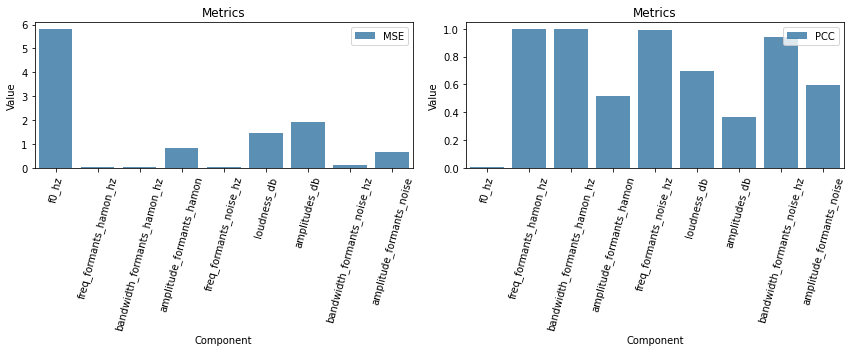

-------------------------------------------------------------------
------------------------------bed----------------------------------
-------------------------------------------------------------------


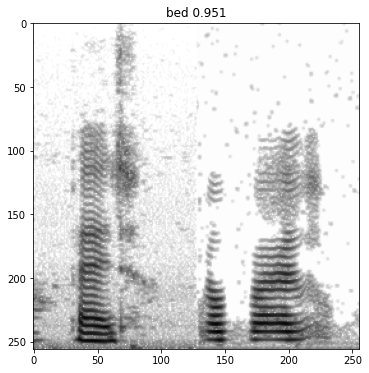

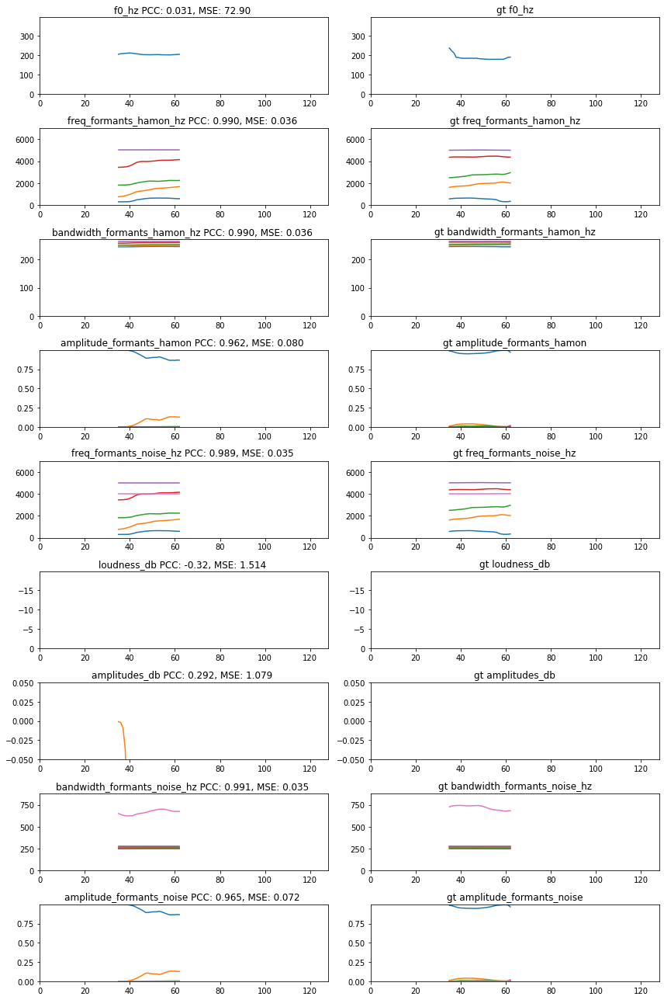

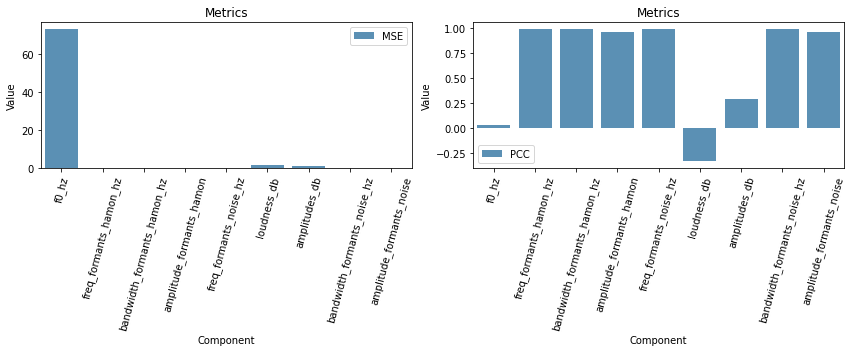

----------------------------------------------------------------------
------------------------------hammer----------------------------------
----------------------------------------------------------------------


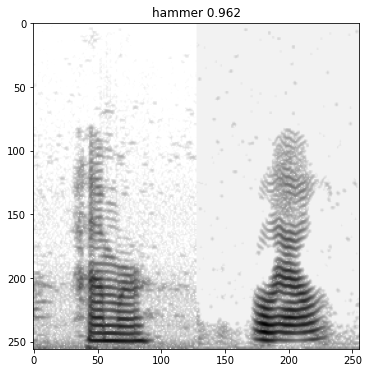

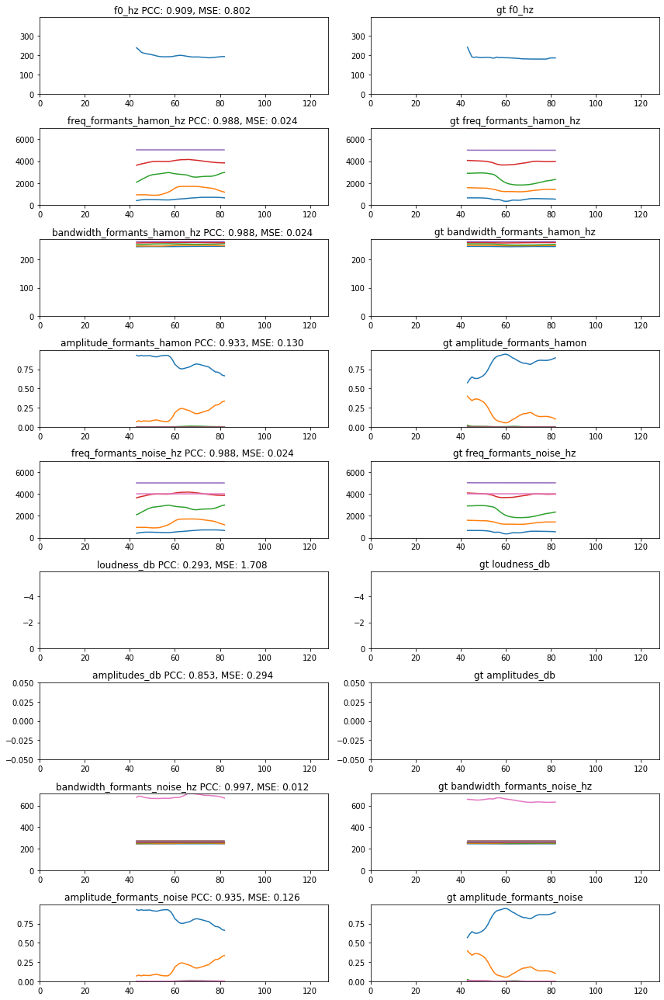

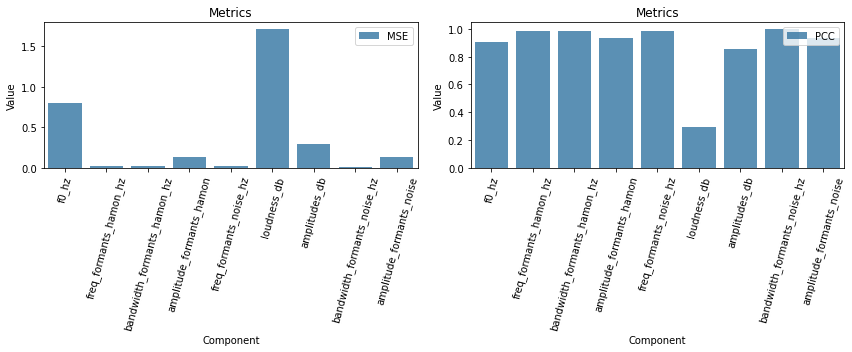

---------------------------------------------------------------------
------------------------------sheep----------------------------------
---------------------------------------------------------------------


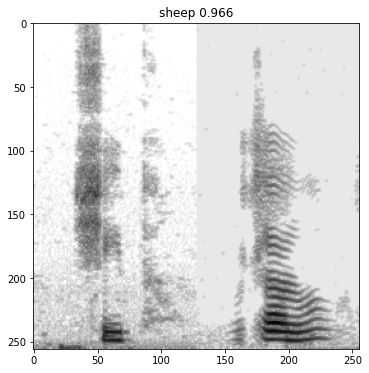

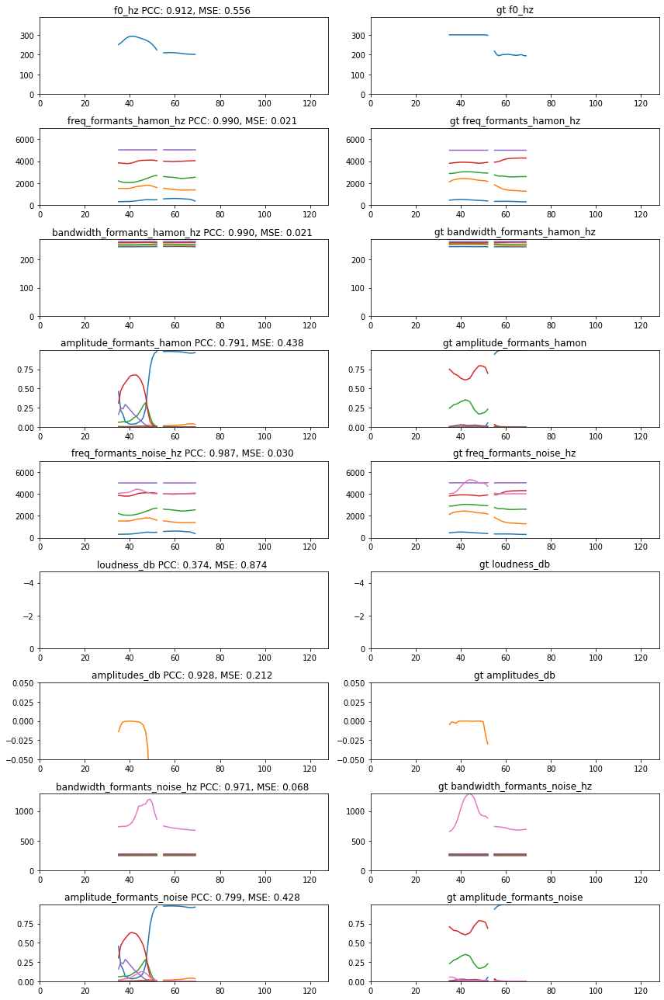

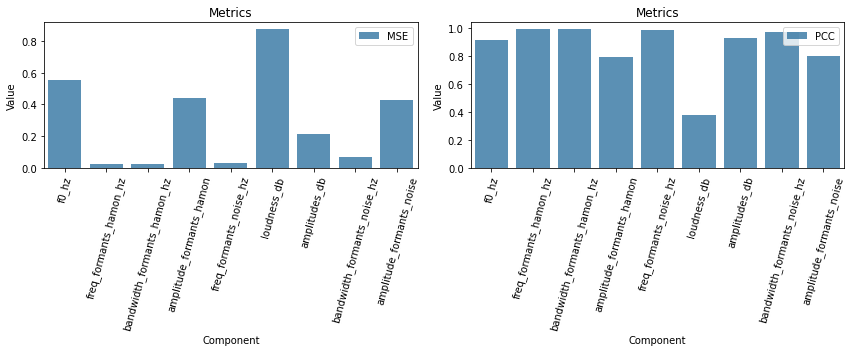

---------------------------------------------------------------------
------------------------------heart----------------------------------
---------------------------------------------------------------------


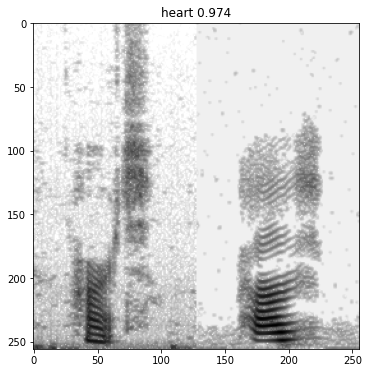

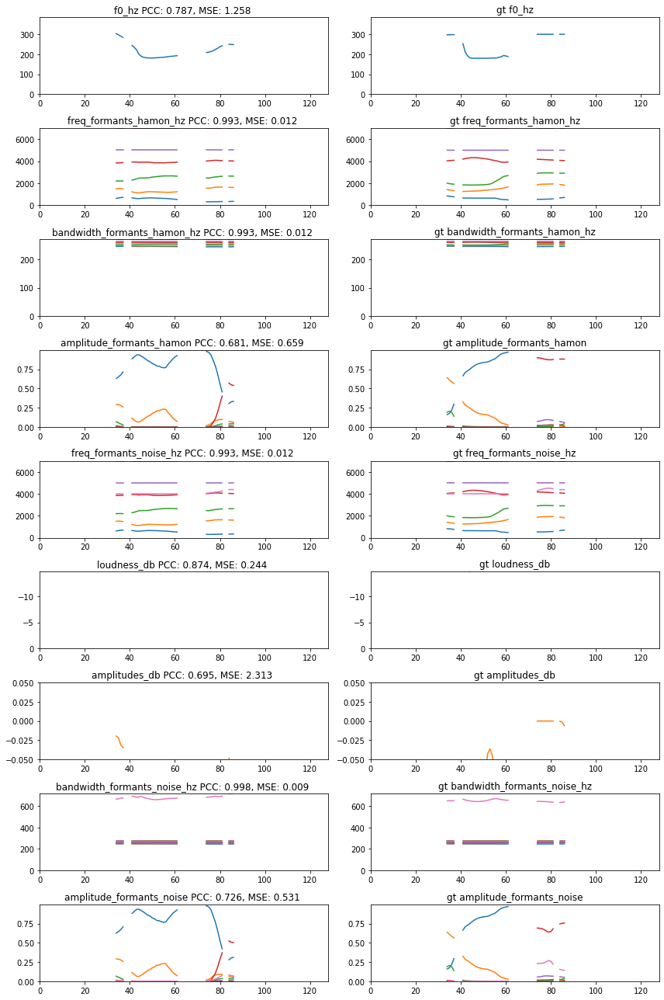

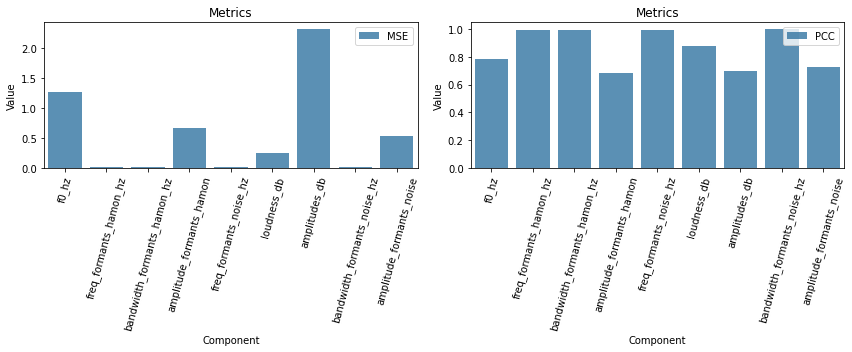

--------------------------------------------------------------------
------------------------------drum----------------------------------
--------------------------------------------------------------------


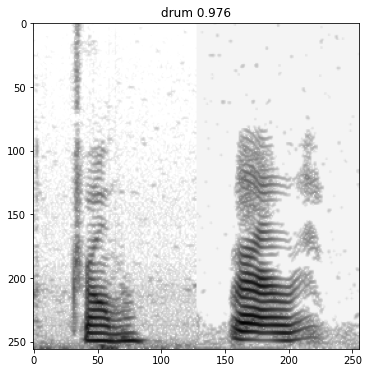

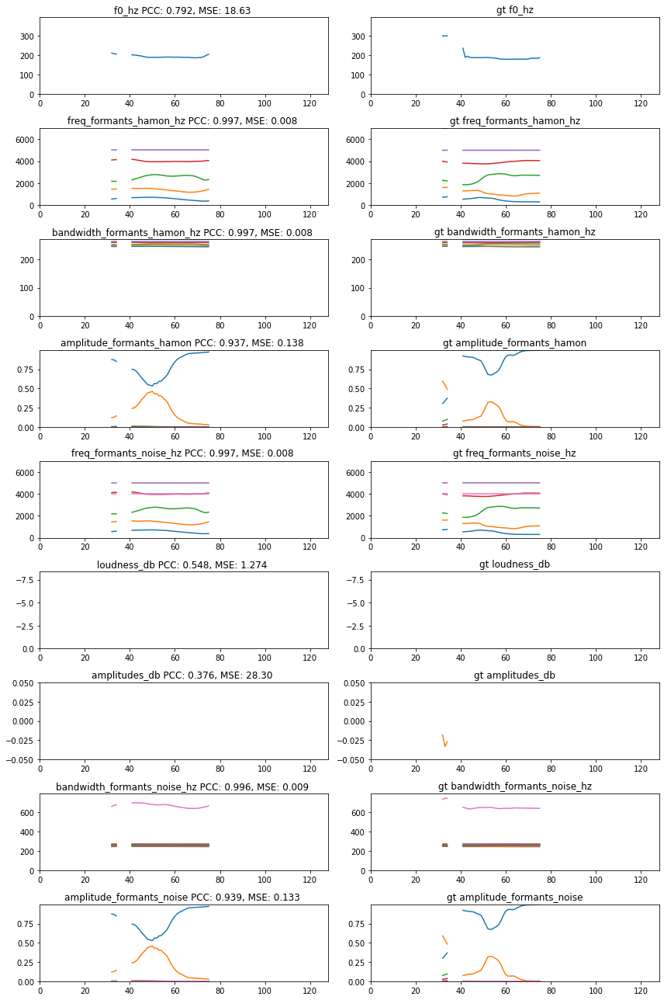

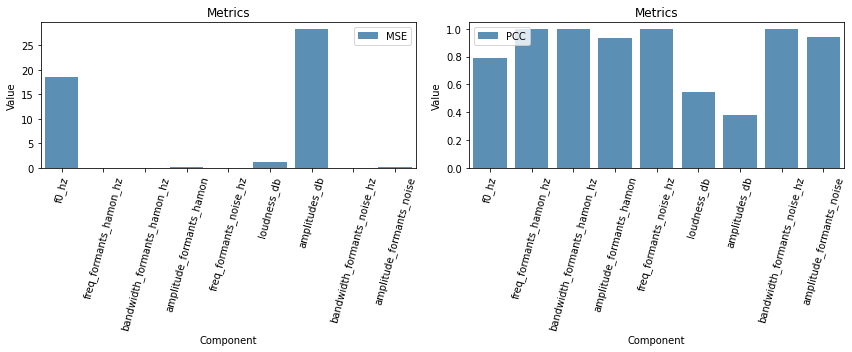

--------------------------------------------------------------------
------------------------------cake----------------------------------
--------------------------------------------------------------------


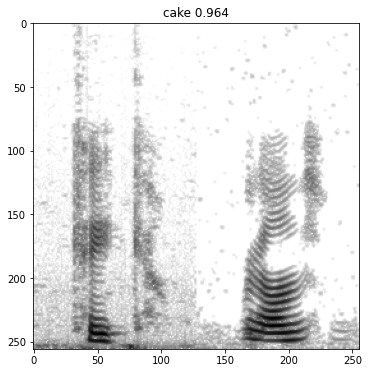

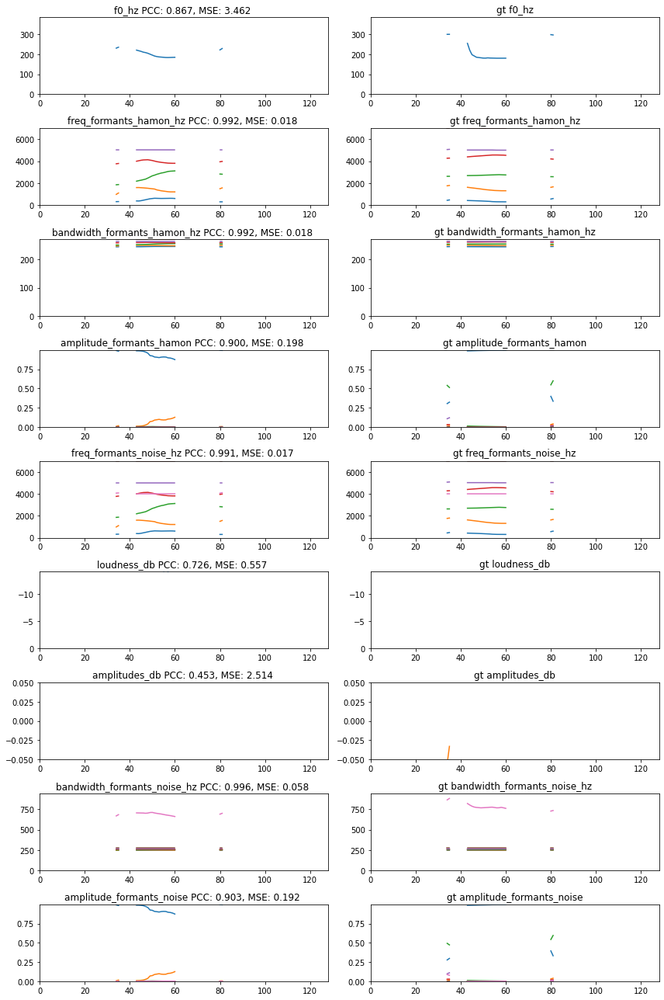

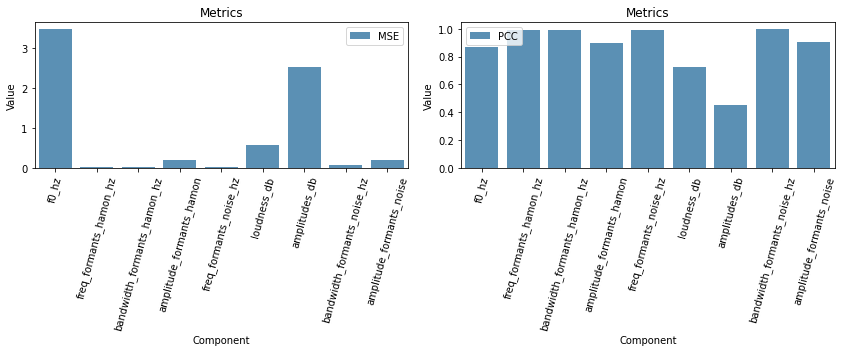

--------------------------------------------------------------------
------------------------------kite----------------------------------
--------------------------------------------------------------------


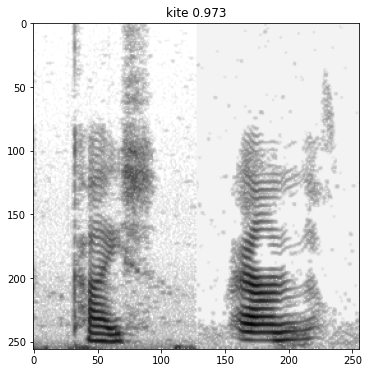

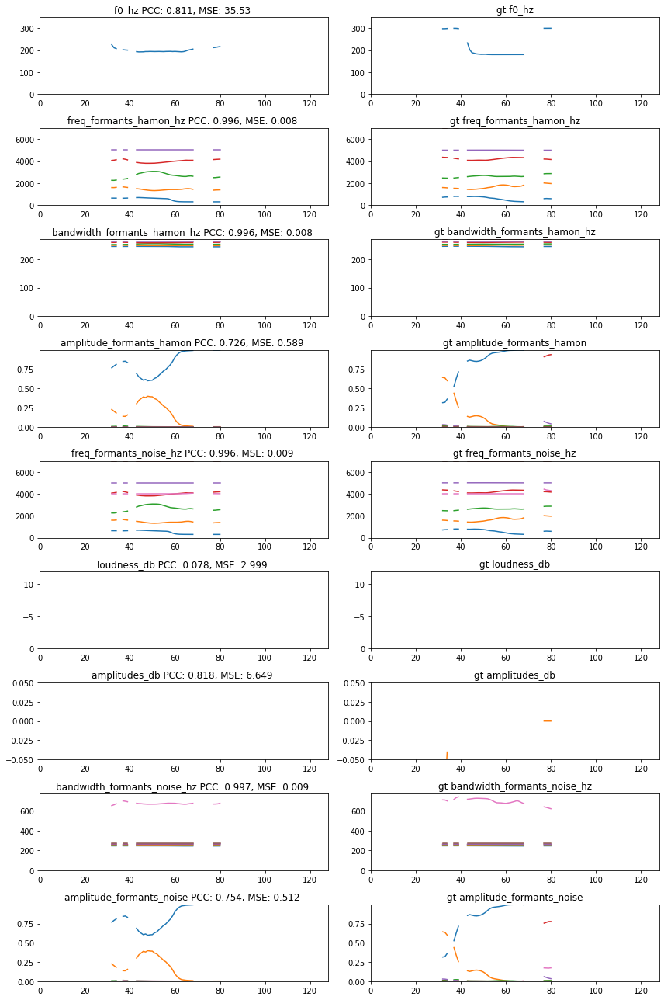

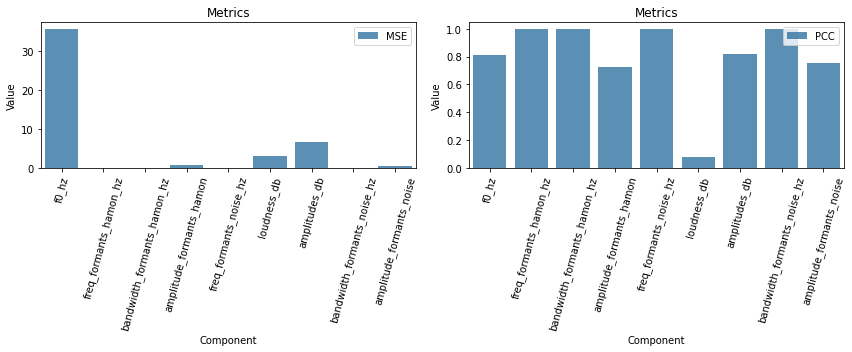

--------------------------------------------------------------------
------------------------------fork----------------------------------
--------------------------------------------------------------------


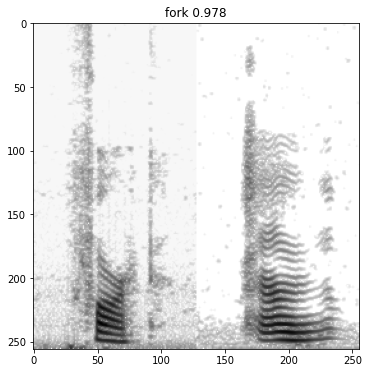

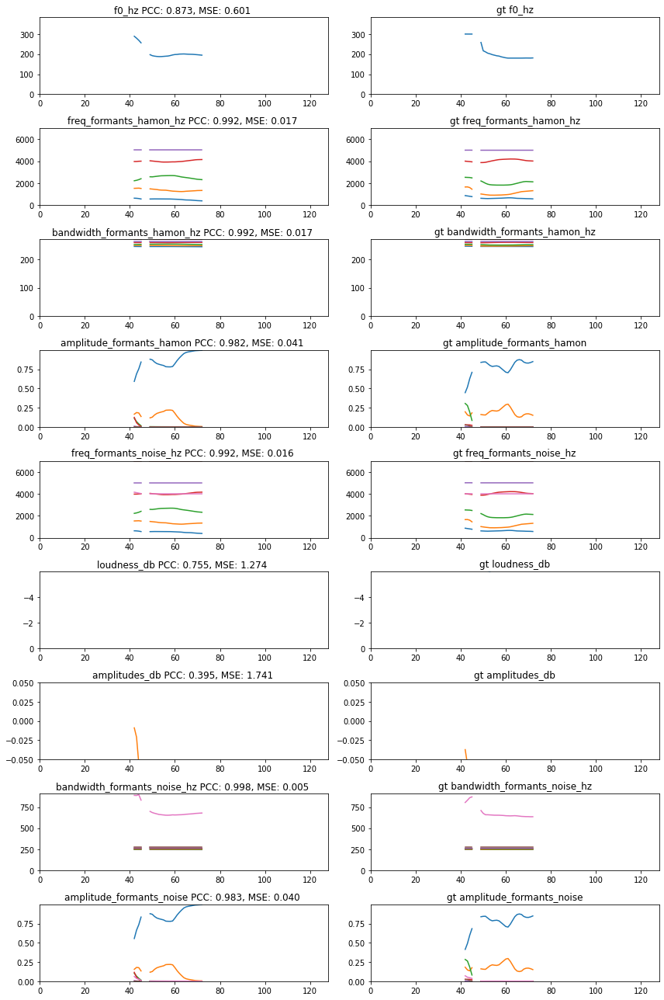

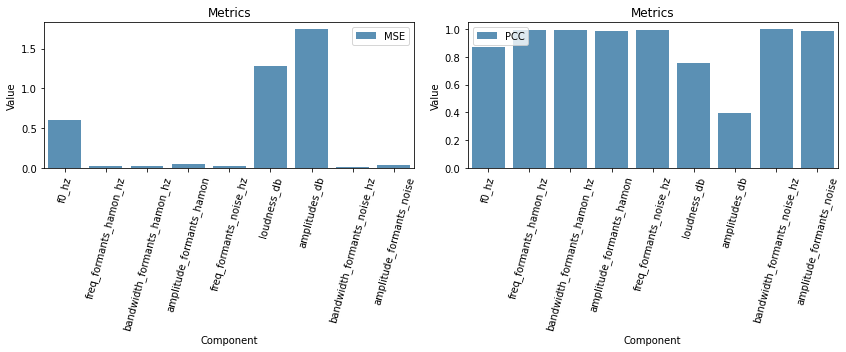

---------------------------------------------------------------------
------------------------------socks----------------------------------
---------------------------------------------------------------------


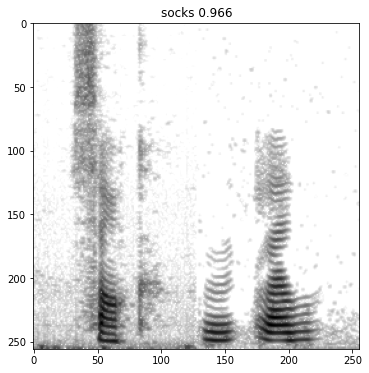

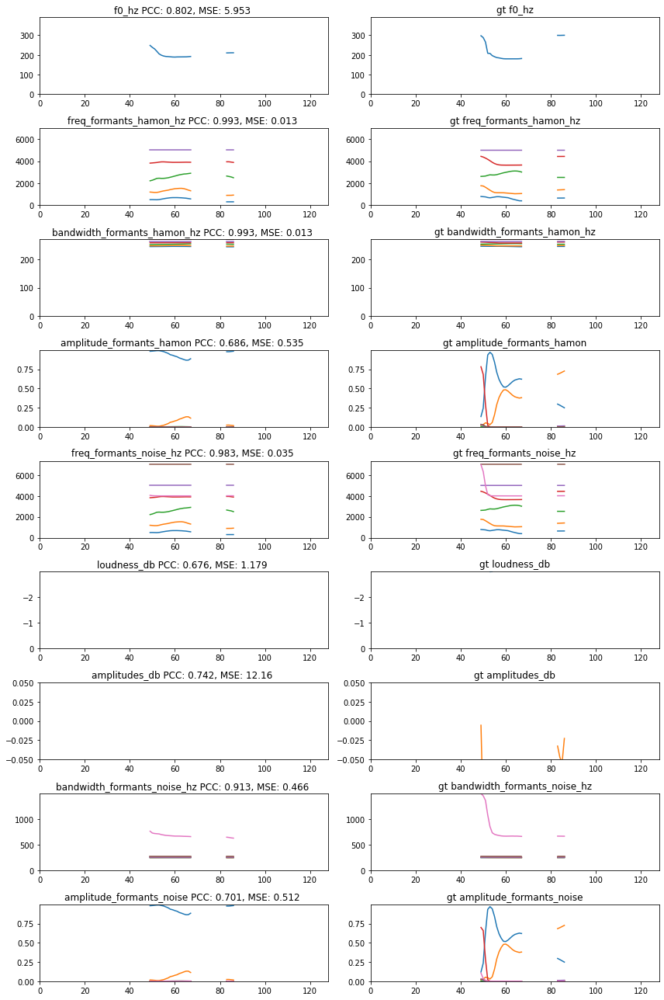

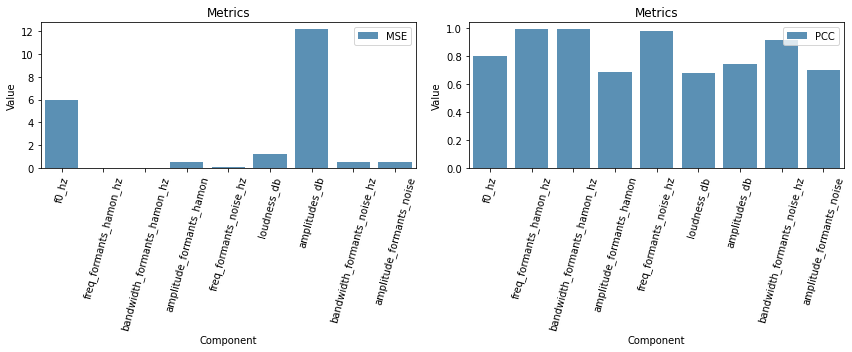

-------------------------------------------------------------------
------------------------------cat----------------------------------
-------------------------------------------------------------------


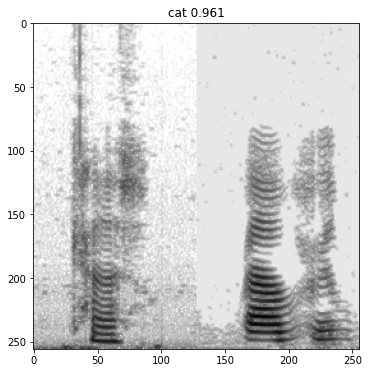

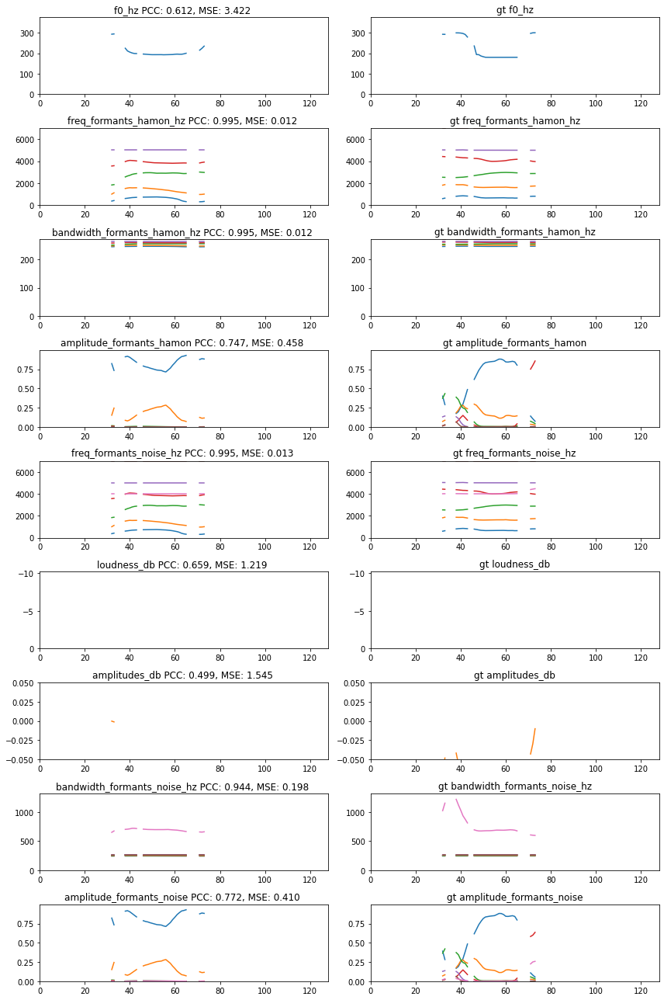

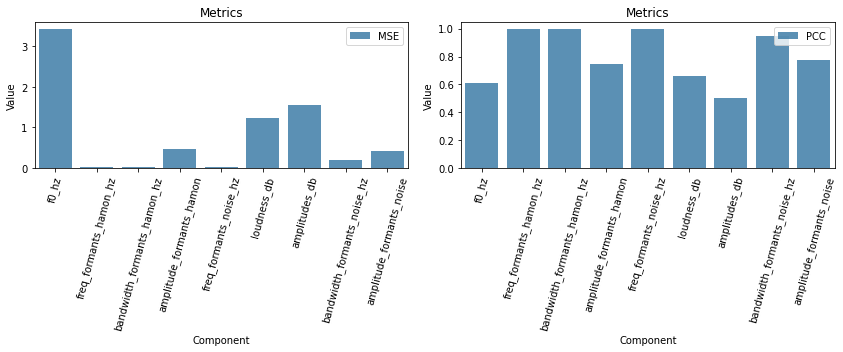

-----------------------------------------------------------------------
------------------------------balloon----------------------------------
-----------------------------------------------------------------------


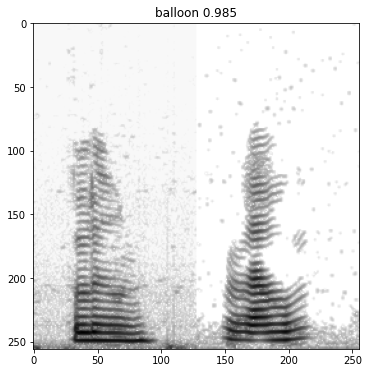

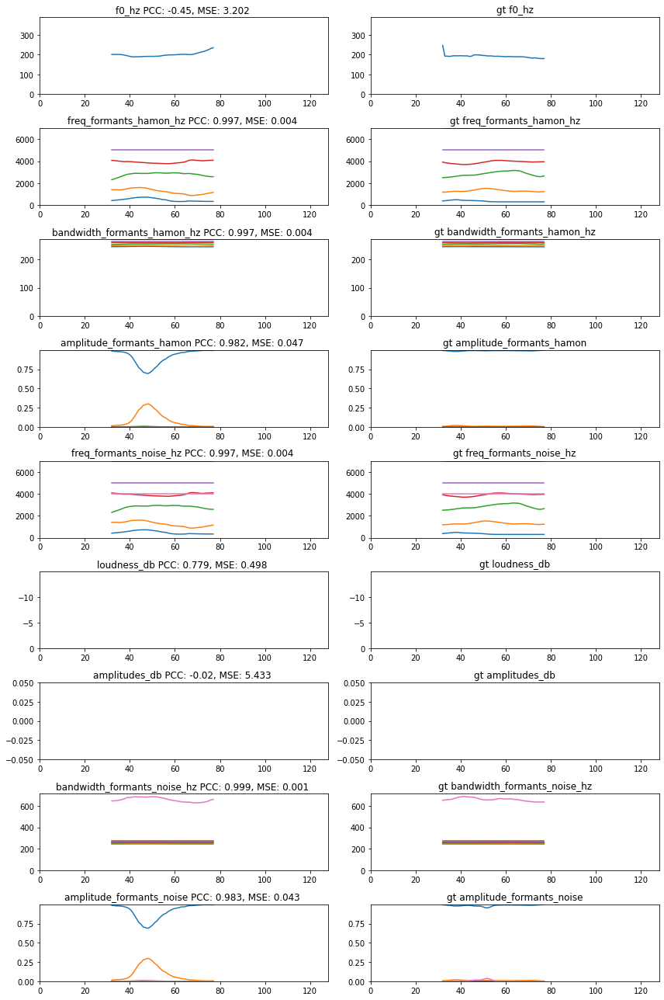

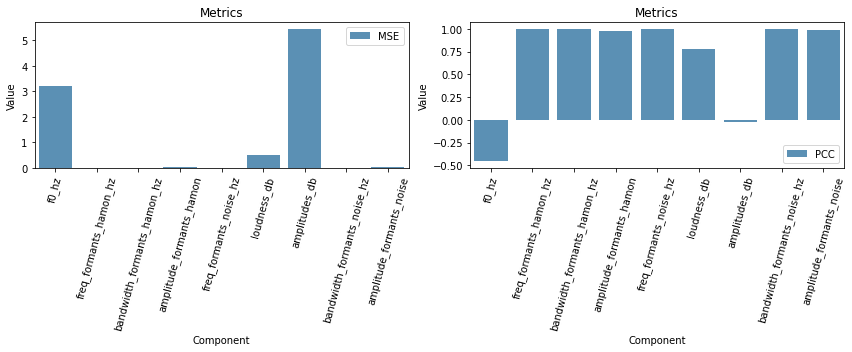

---------------------------------------------------------------------
------------------------------table----------------------------------
---------------------------------------------------------------------


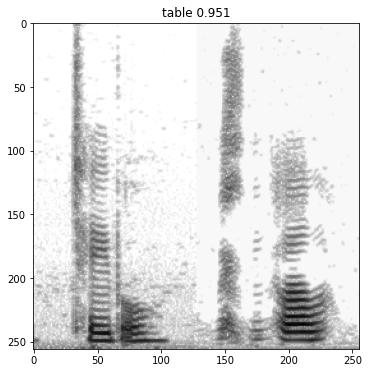

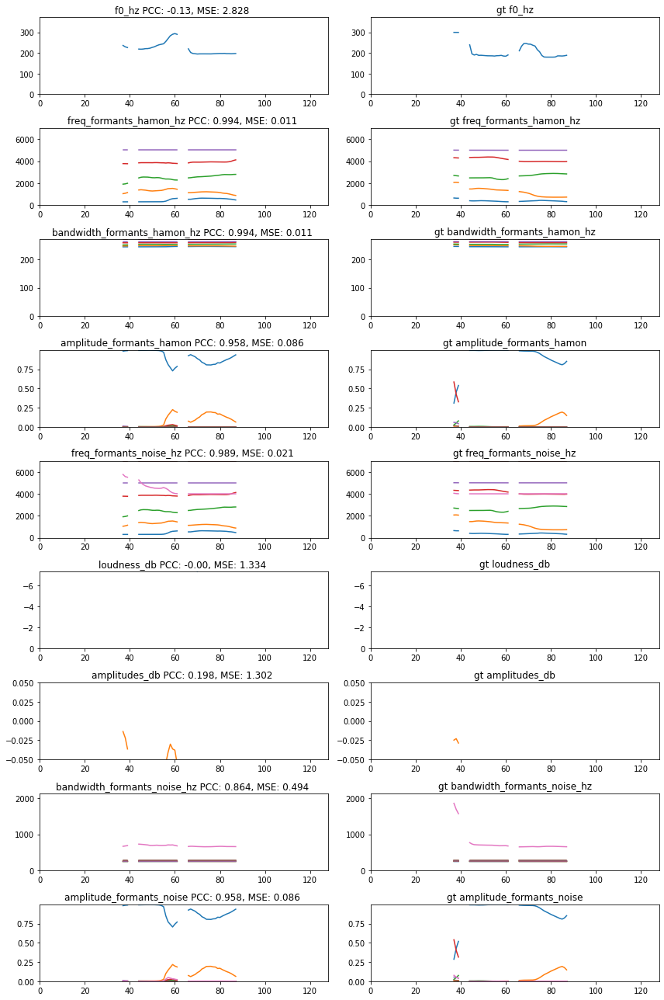

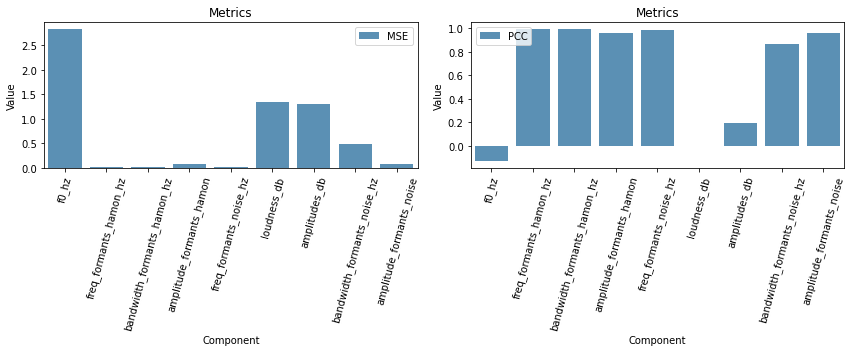

--------------------------------------------------------------------
------------------------------kite----------------------------------
--------------------------------------------------------------------


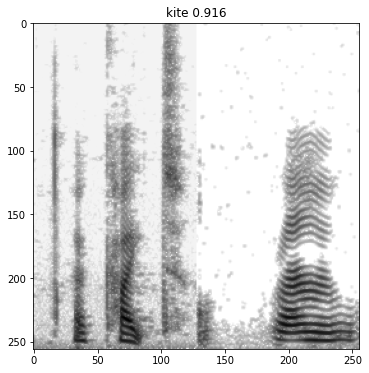

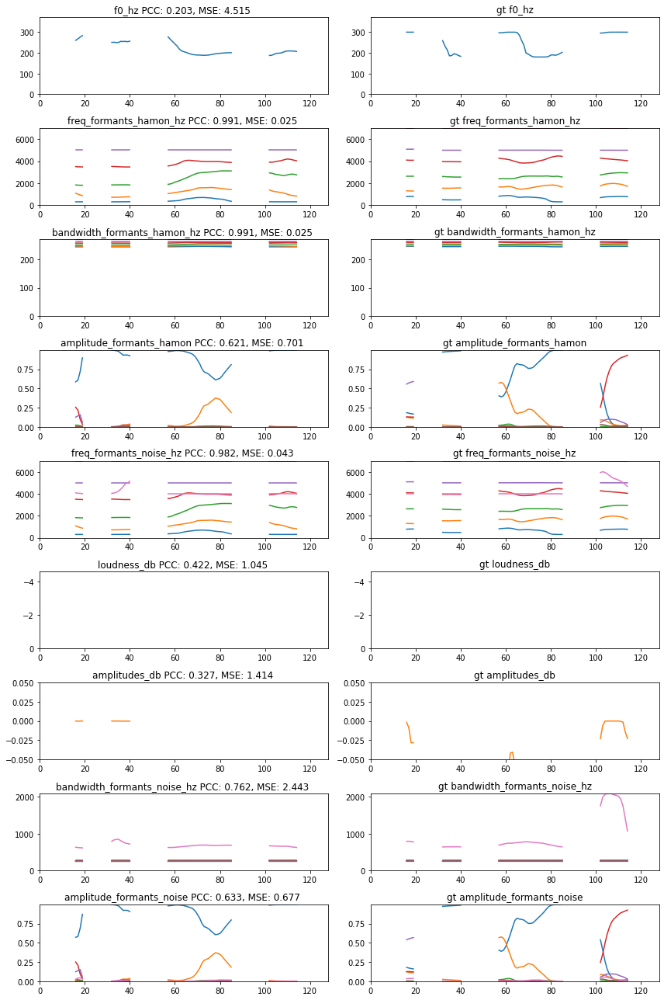

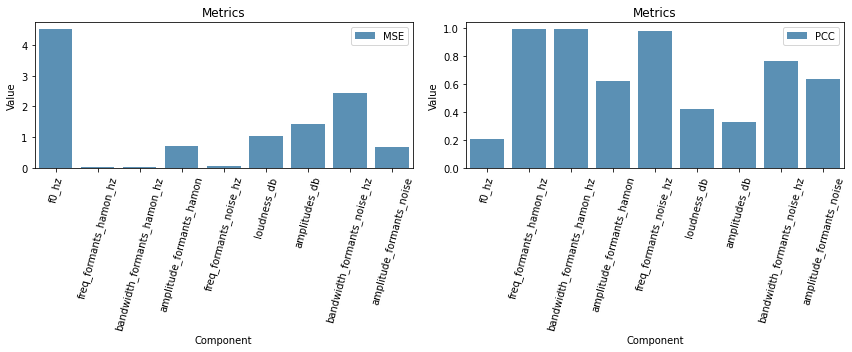

--------------------------------------------------------------------
------------------------------ball----------------------------------
--------------------------------------------------------------------


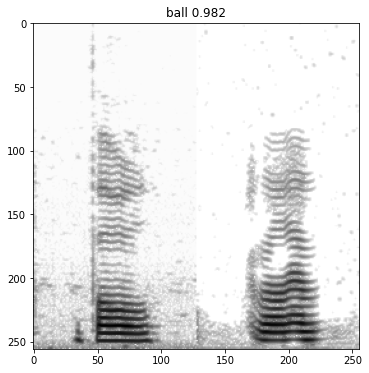

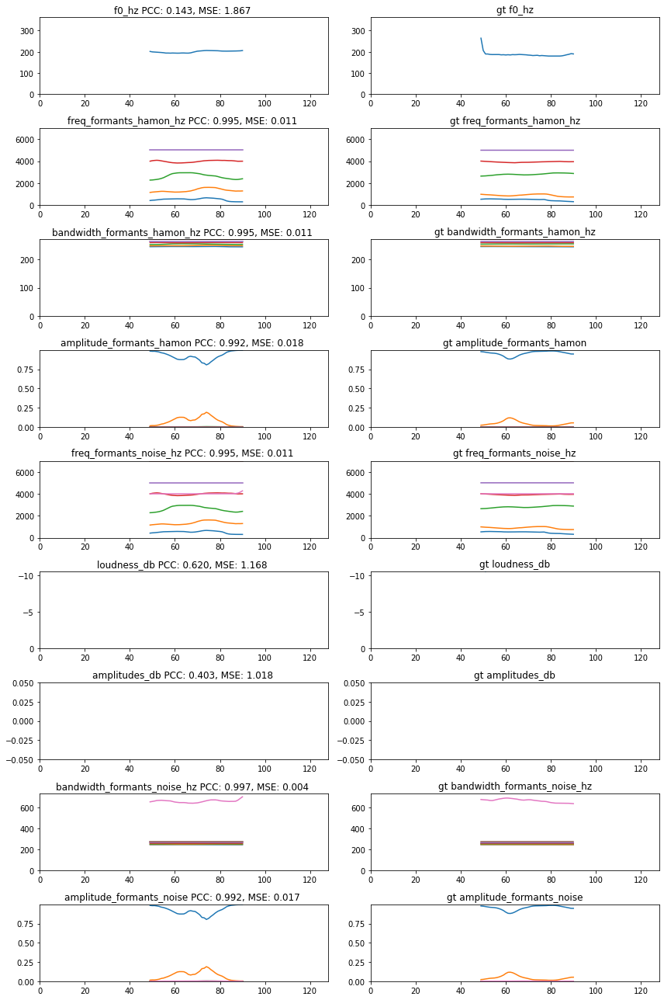

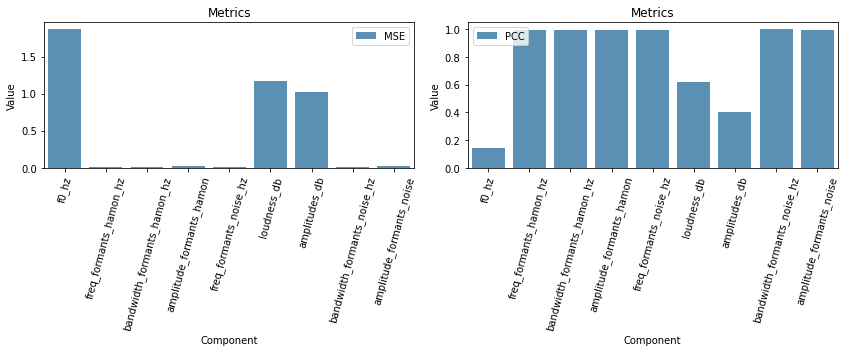

--------------------------------------------------------------------
------------------------------cake----------------------------------
--------------------------------------------------------------------


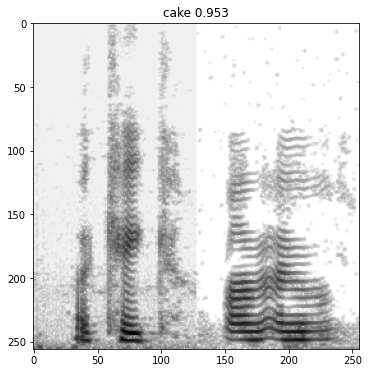

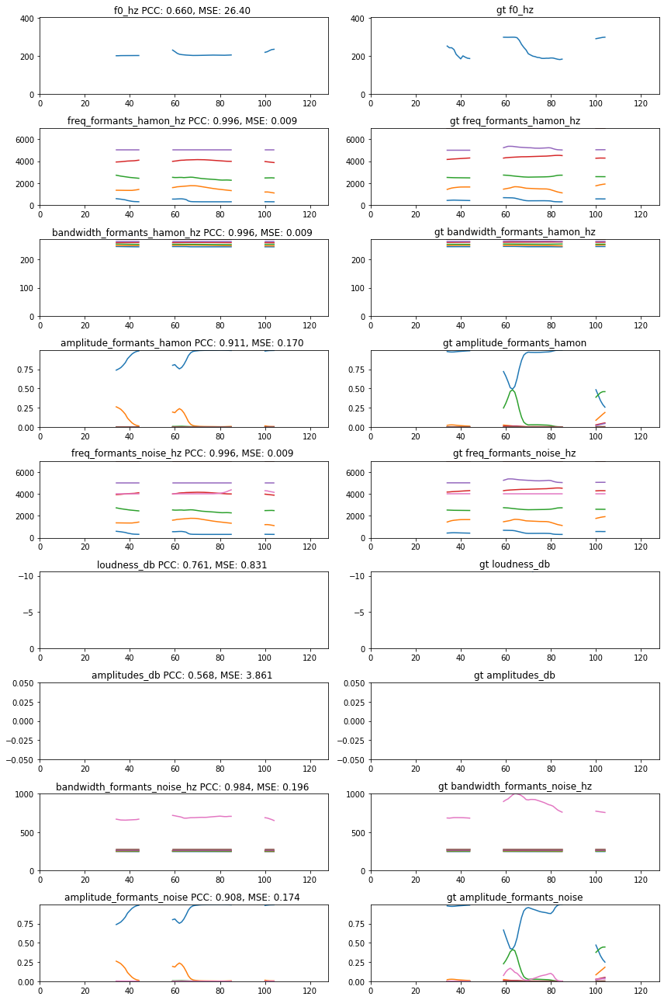

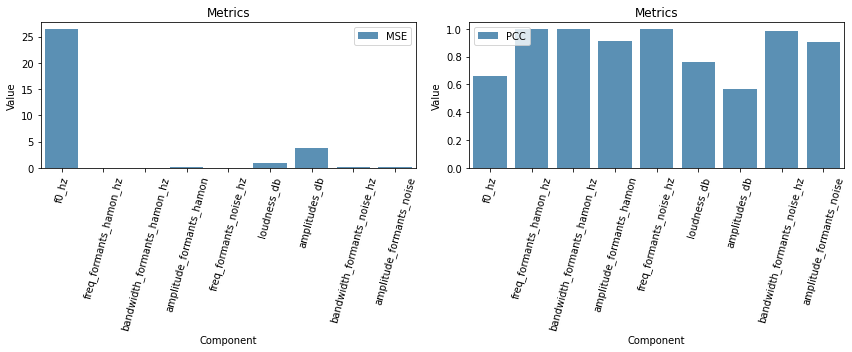

-------------------------------------------------------------------
------------------------------bee----------------------------------
-------------------------------------------------------------------


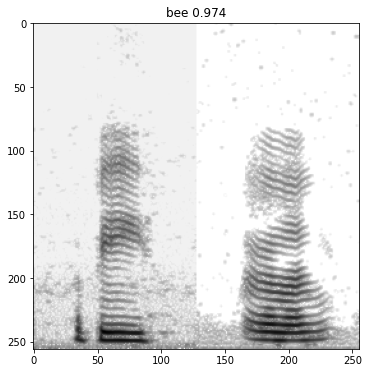

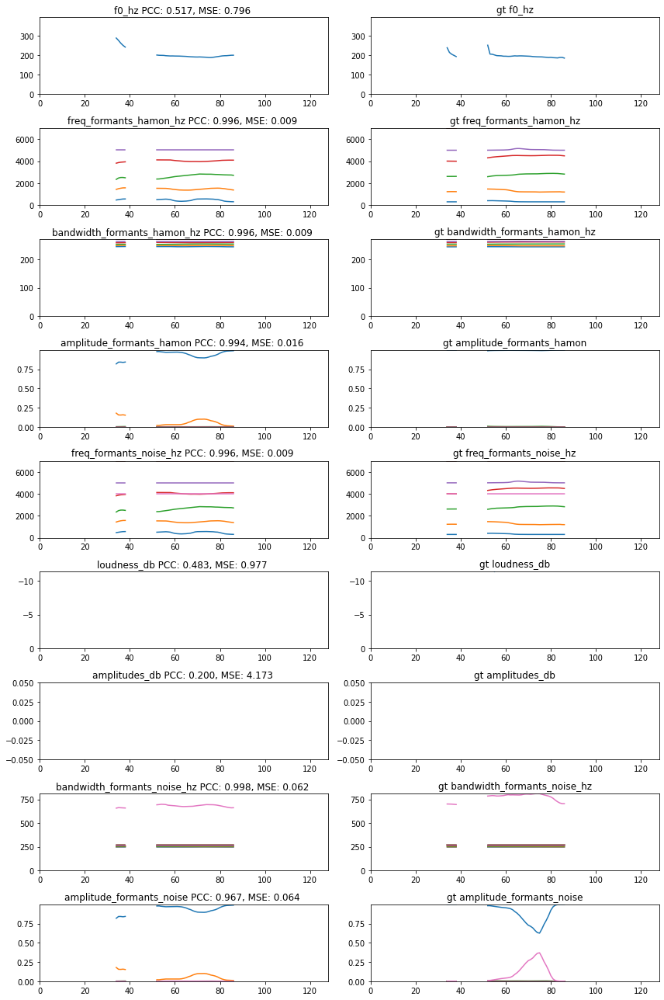

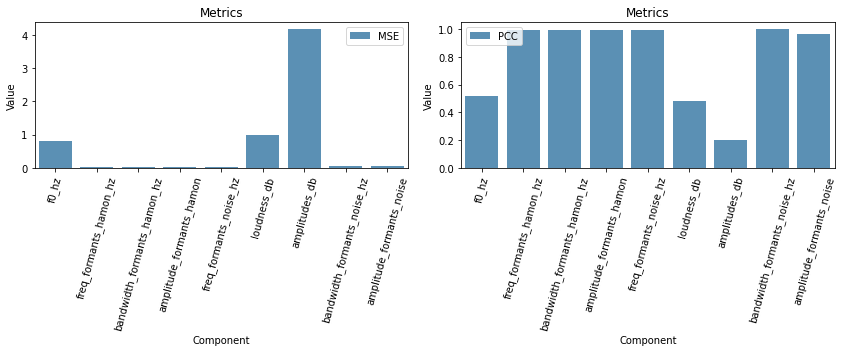

----------------------------------------------------------------------
------------------------------button----------------------------------
----------------------------------------------------------------------


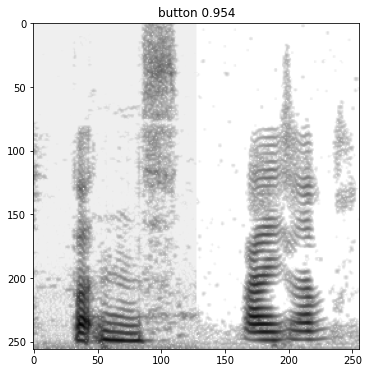

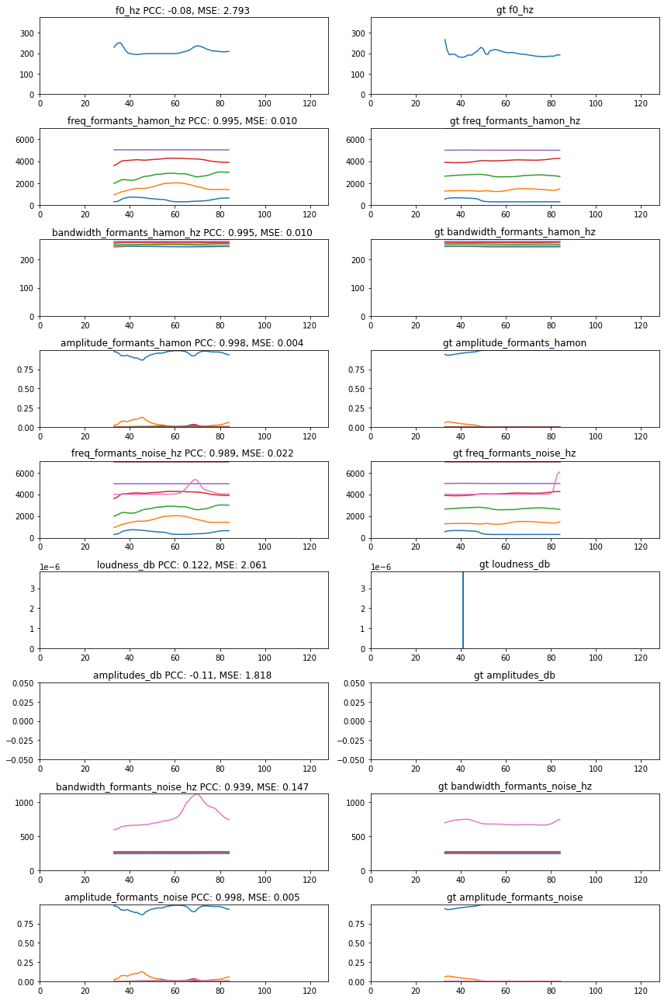

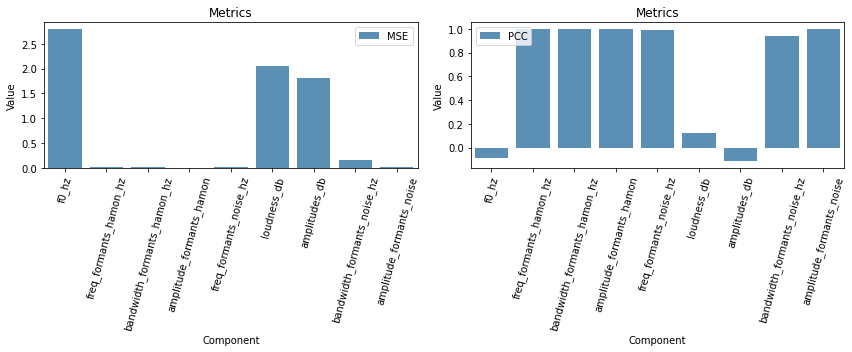

---------------------------------------------------------------------
------------------------------heart----------------------------------
---------------------------------------------------------------------


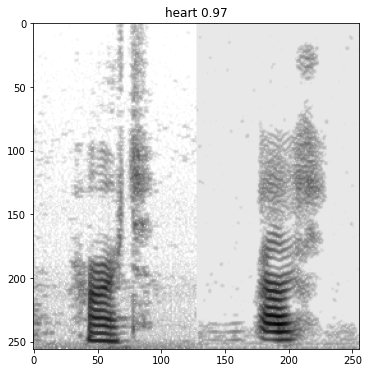

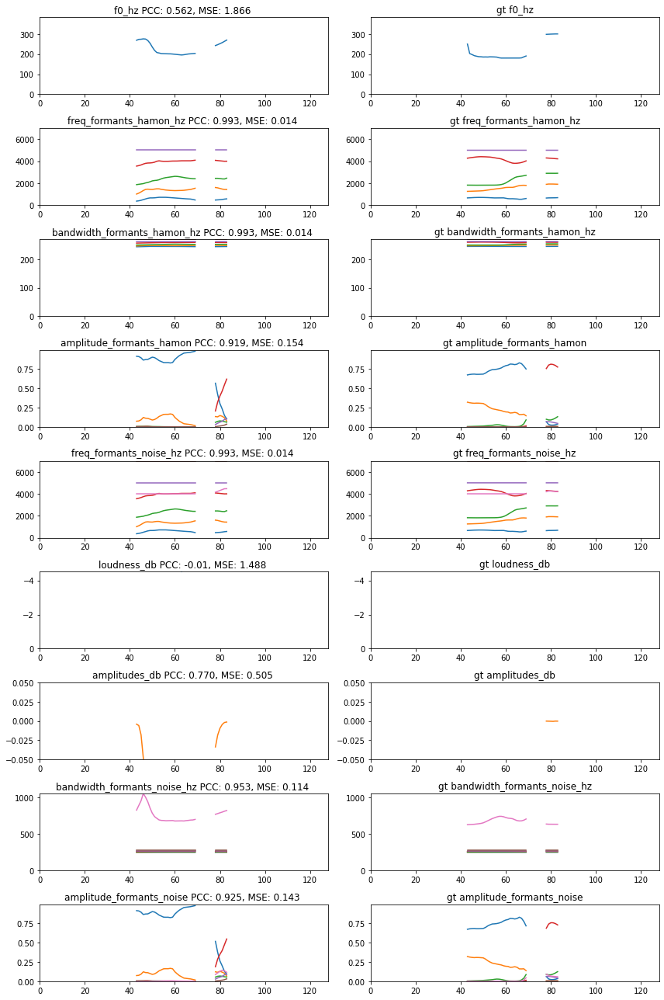

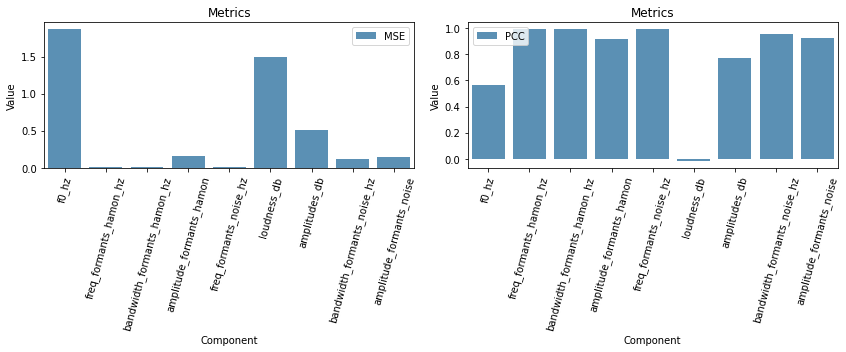

------------------------------------------------------------------------
------------------------------airplane----------------------------------
------------------------------------------------------------------------


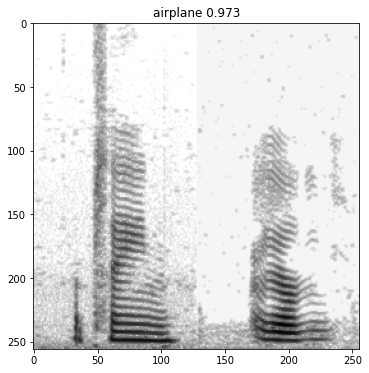

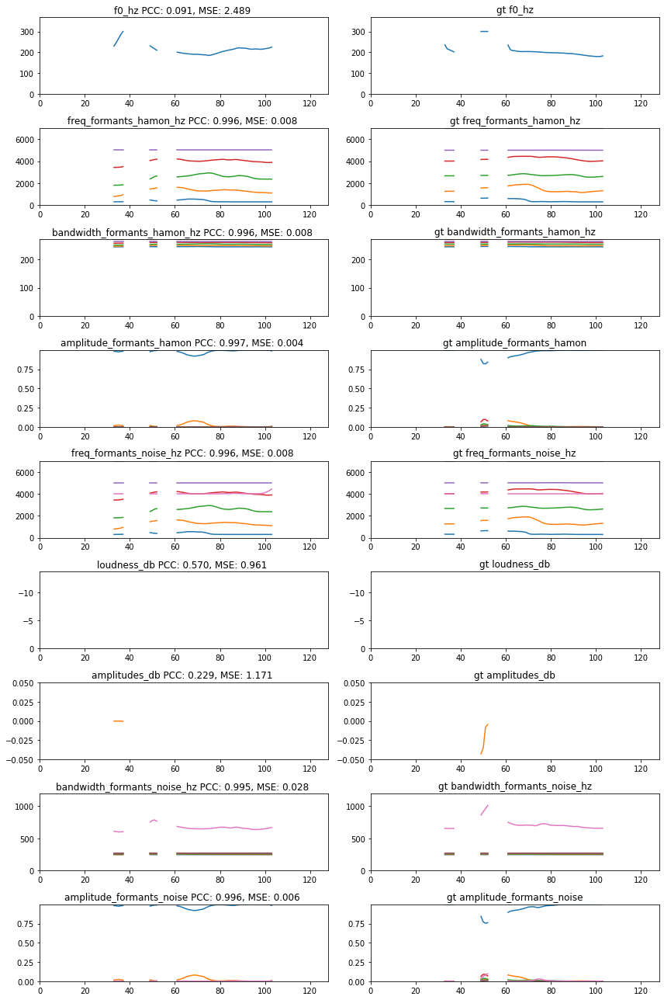

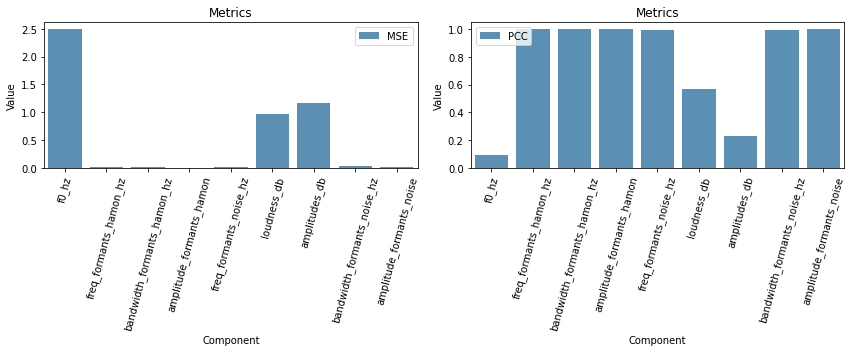

---------------------------------------------------------------------
------------------------------watch----------------------------------
---------------------------------------------------------------------


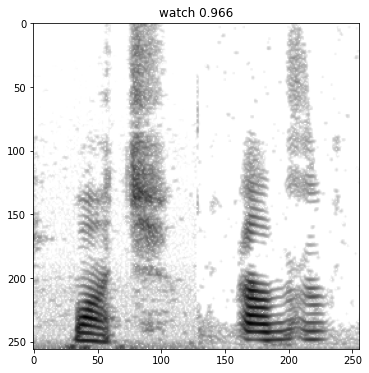

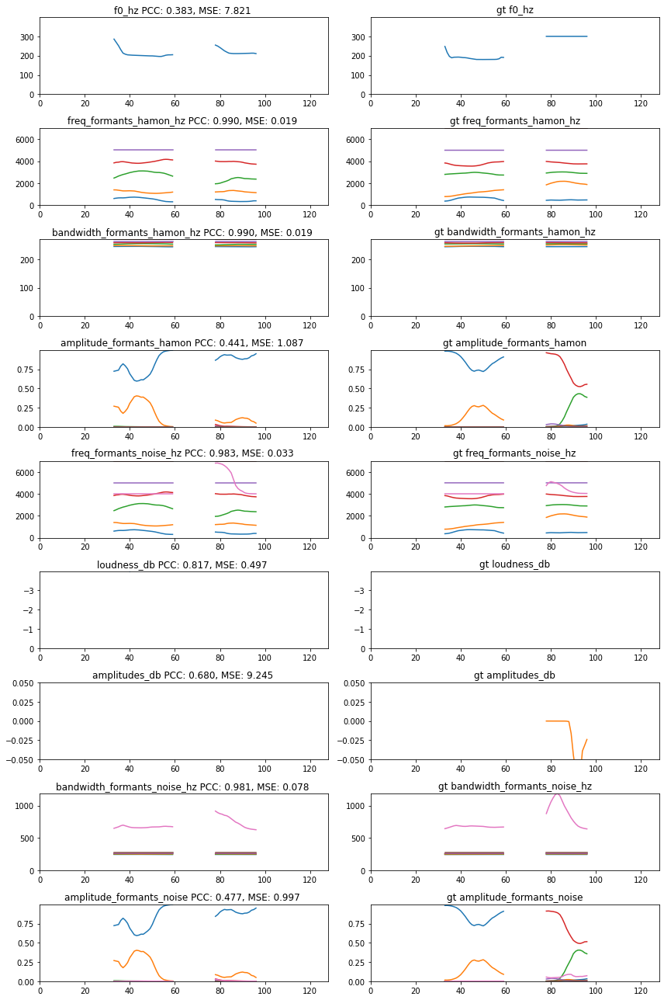

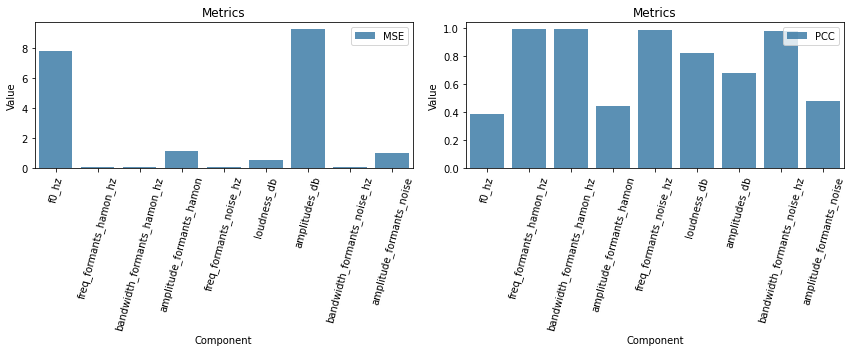

---------------------------------------------------------------------
------------------------------heart----------------------------------
---------------------------------------------------------------------


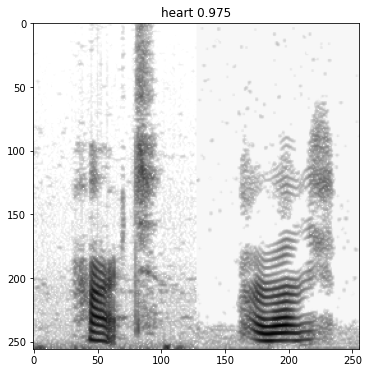

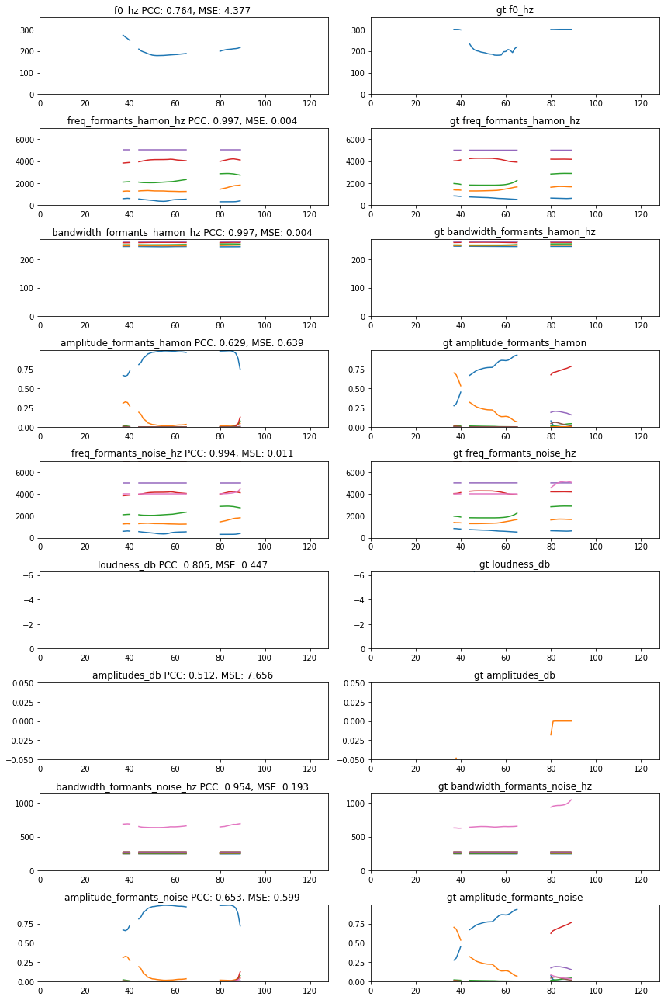

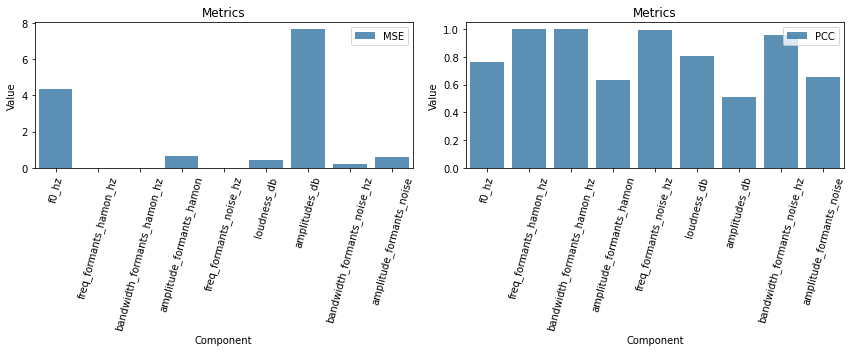

----------------------------------------------------------------------
------------------------------ladder----------------------------------
----------------------------------------------------------------------


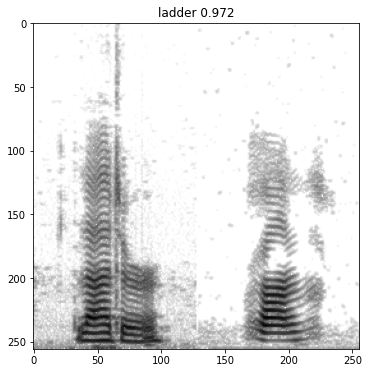

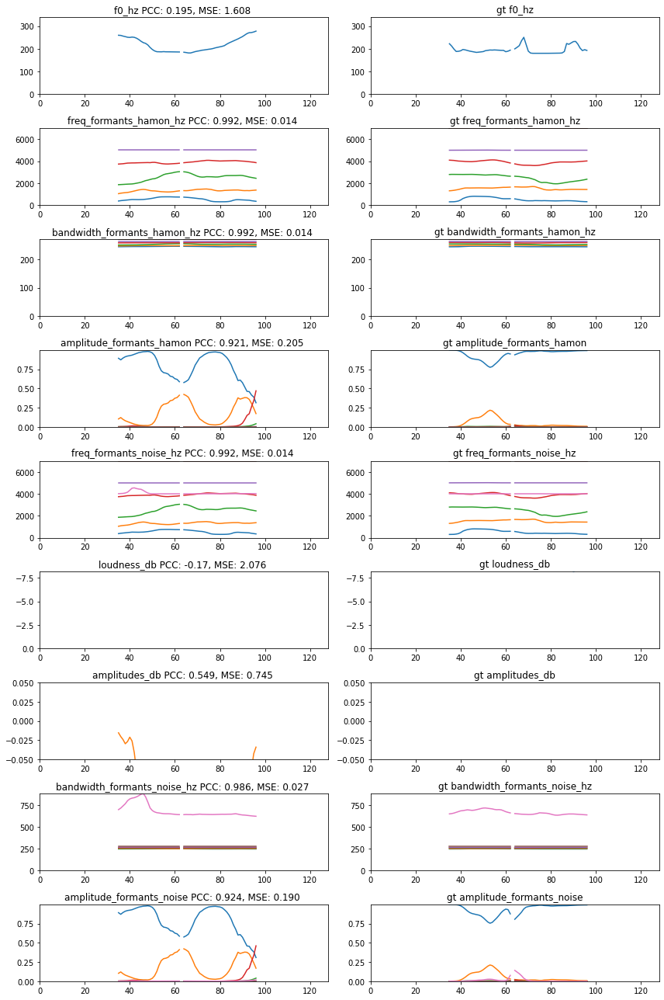

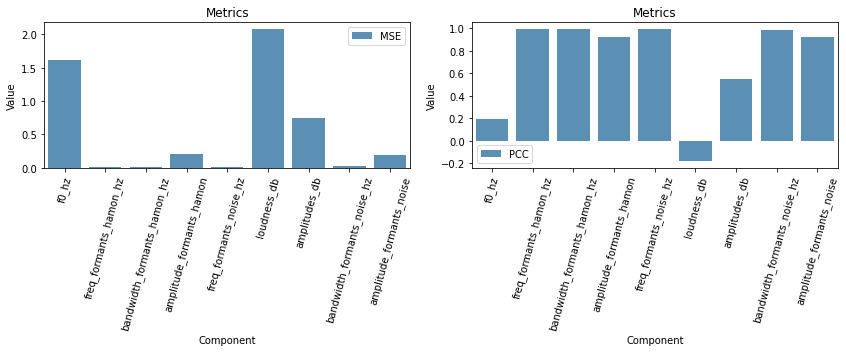

--------------------------------------------------------------------
------------------------------drum----------------------------------
--------------------------------------------------------------------


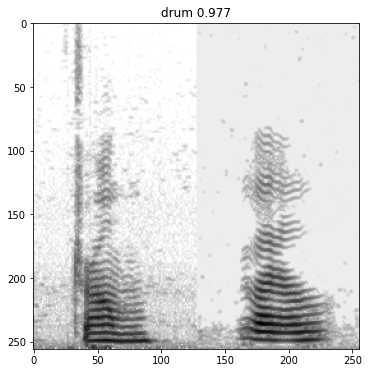

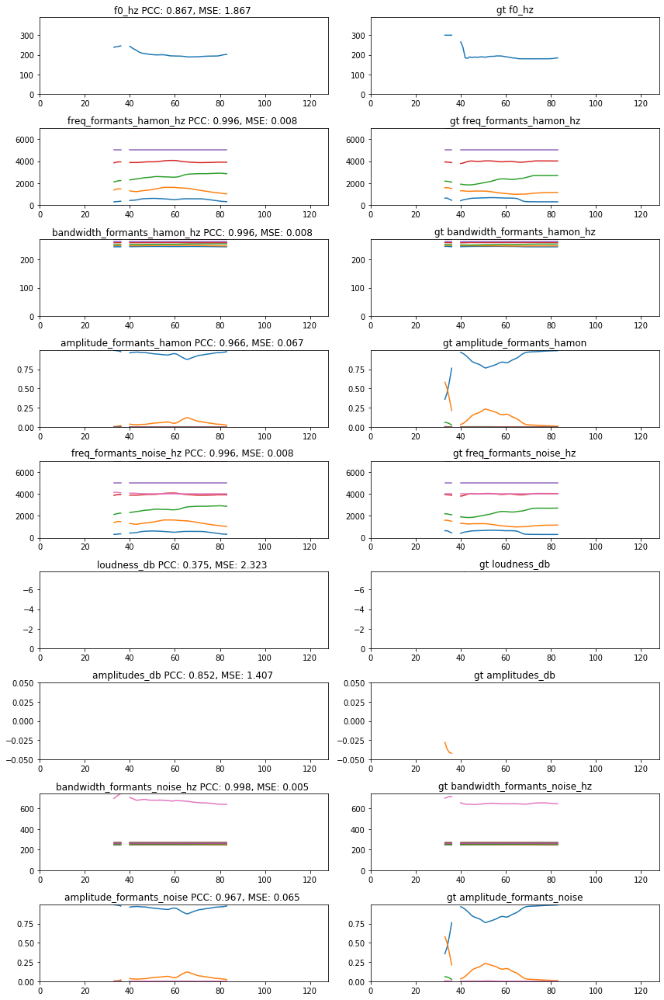

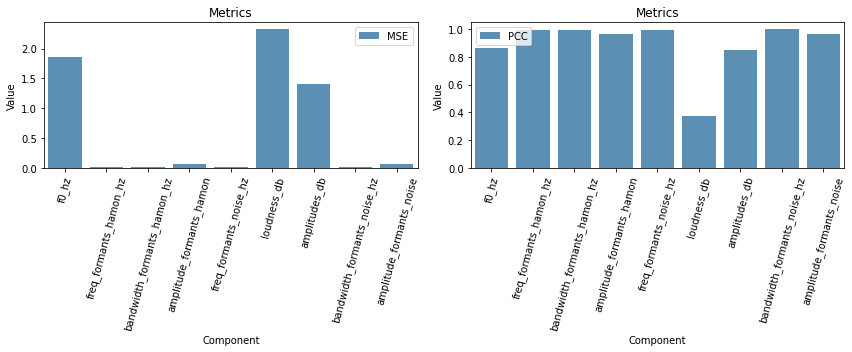

-------------------------------------------------------------------
------------------------------dog----------------------------------
-------------------------------------------------------------------


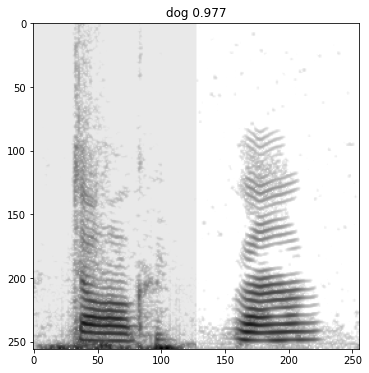

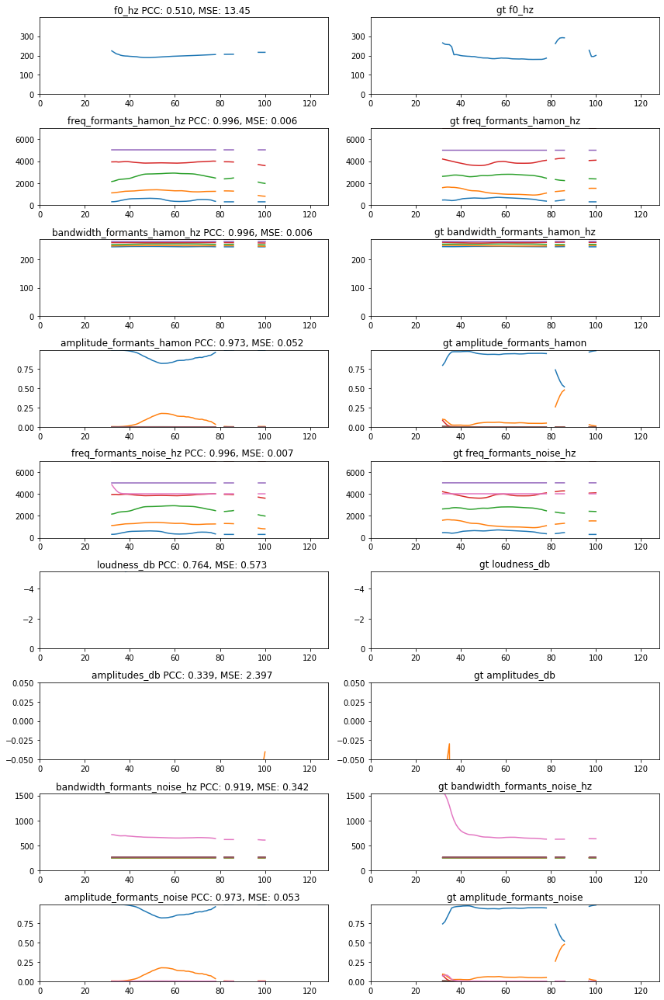

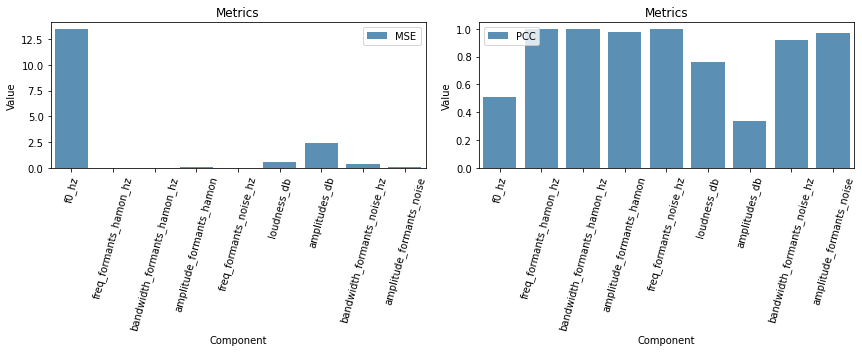

-------------------------------------------------------------------
------------------------------gun----------------------------------
-------------------------------------------------------------------


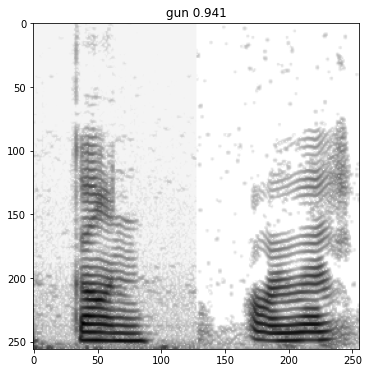

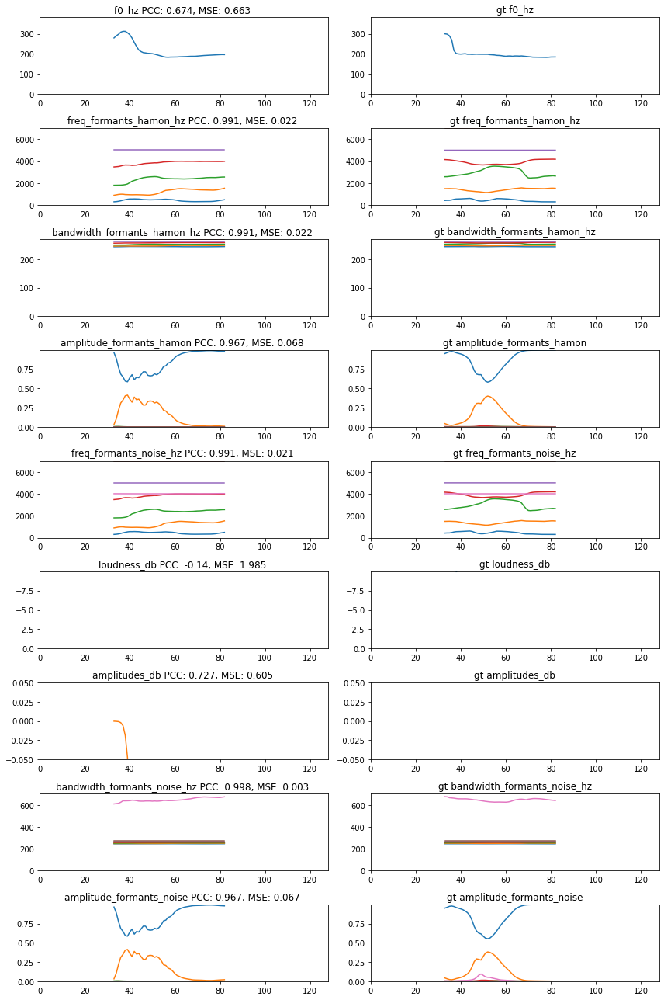

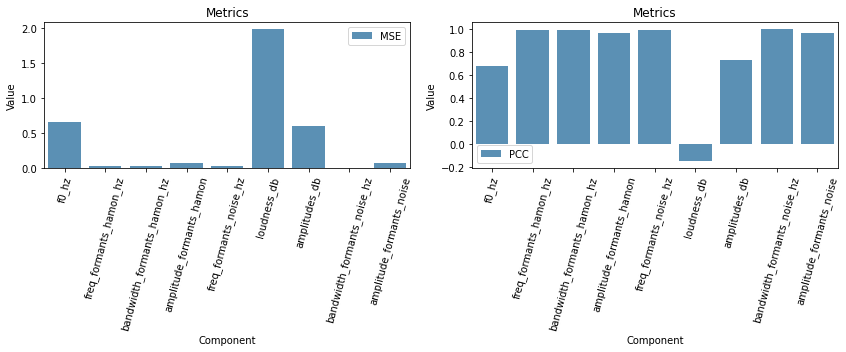

-----------------------------------------------------------------------
------------------------------balloon----------------------------------
-----------------------------------------------------------------------


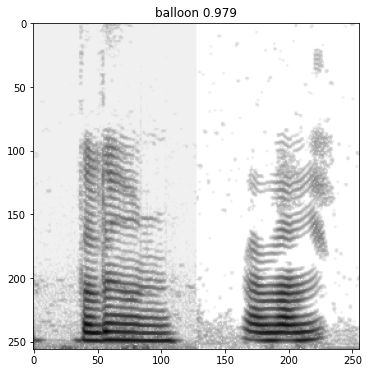

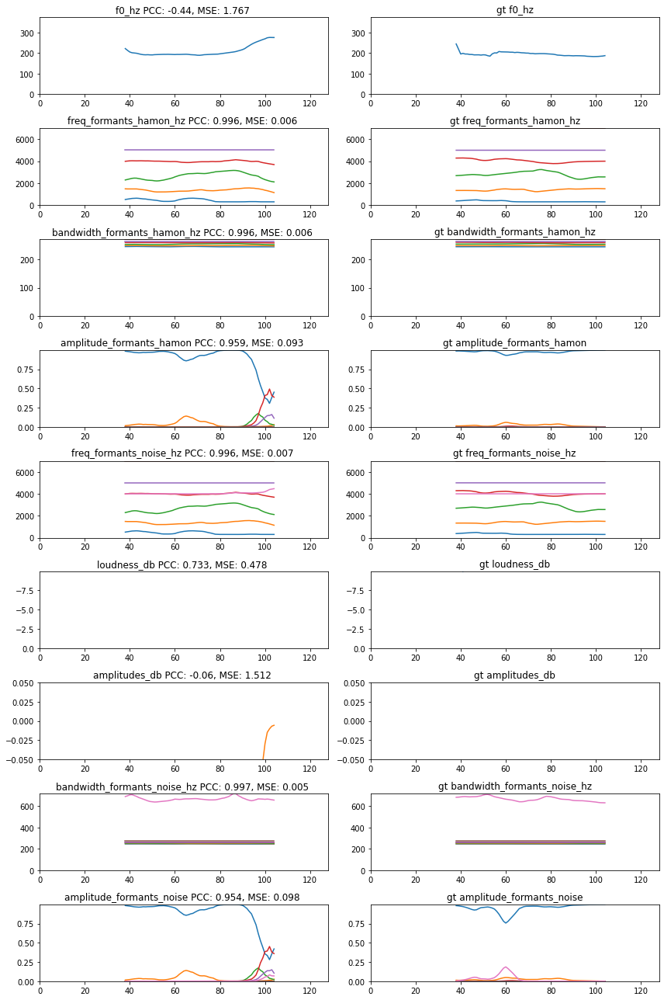

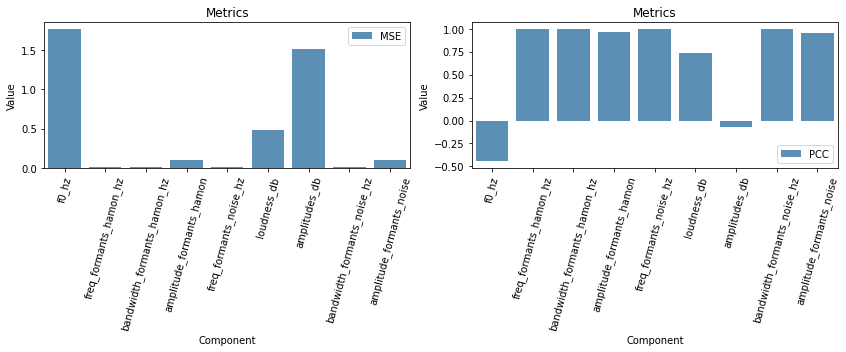

------------------------------------------------------------------------
------------------------------airplane----------------------------------
------------------------------------------------------------------------


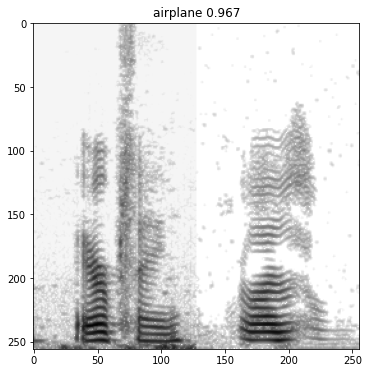

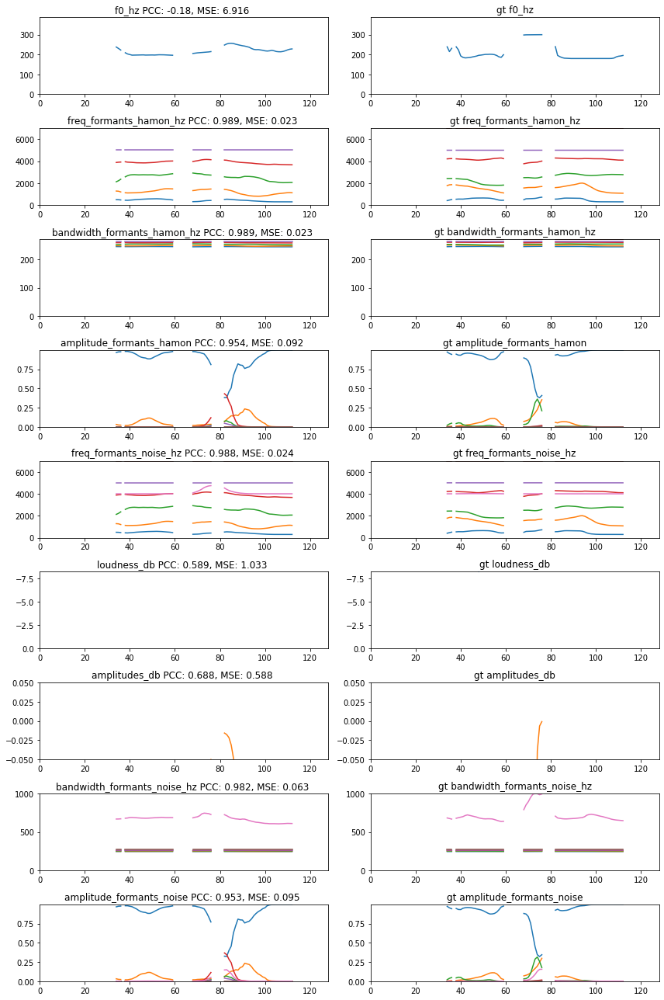

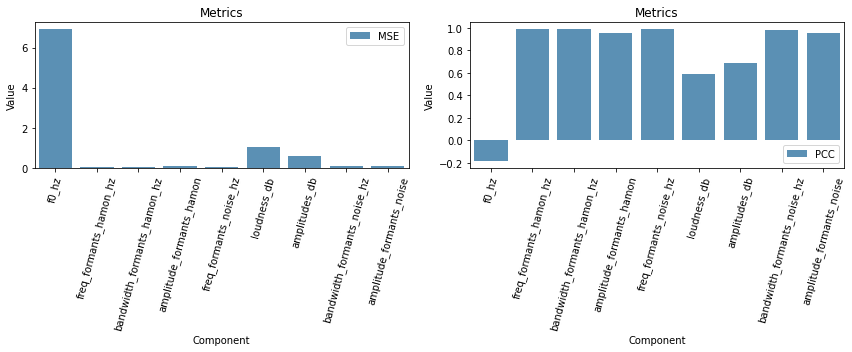

In [250]:
for word_ind in np.setdiff1d(np.arange(0,50),\
             np.concatenate((intelligible_dict[sample_ind],part_intelligible_dict[sample_ind]))):
    pccstmp, msestmp = plot_components(components_ecog ,components ,word_ind=word_ind, \
                                       weighted_loss=1)
    pccs_df.iloc[word_ind] = pccstmp
    mses_df.iloc[word_ind] = msestmp

## compare components metric, group by words' interlligibility level

In [301]:
intell_ind = intelligible_dict[sample_ind]
part_intell_ind = part_intelligible_dict[sample_ind]
others_ind = np.setdiff1d(np.arange(0,50),\
             np.concatenate((intelligible_dict[sample_ind],part_intelligible_dict[sample_ind])))
#pccs_df.iloc[intell_ind], pccs_df.iloc[part_intell_ind], pccs_df.iloc[others_ind]

In [297]:
def get_plotdf(originaldf,wordtype='intell'):
    plotdf = pd.DataFrame(np.concatenate((originaldf.values.reshape(-1,1),\
    np.array([i for i in originaldf.columns]*\
             originaldf.shape[0]).reshape(-1,1),\
    np.repeat(np.array(originaldf.index),\
              originaldf.shape[1]).reshape(-1,1),\
            np.repeat(wordtype,originaldf.values.reshape(-1,1).shape[0]).reshape(-1,1)),axis=1),\
                          columns = ['value','feature','wordind','word'])
    return plotdf

plotdf = pd.DataFrame(np.concatenate((pccs_df.iloc[intell_ind].values.reshape(-1,1),\
np.array([i for i in pccs_df.iloc[intell_ind].columns]*\
         pccs_df.iloc[intell_ind].shape[0]).reshape(-1,1),\
np.repeat(np.array(pccs_df.iloc[intell_ind].index),\
          pccs_df.iloc[intell_ind].shape[1]).reshape(-1,1),\
        np.repeat('intell',pccs_df.iloc[intell_ind].values.reshape(-1,1).shape[0]).reshape(-1,1)),axis=1),\
                      columns = ['value','feature','wordind','word'])

In [288]:
flatui = ['#FF7373','#BBFF5C','#F0B9FF',"#FEBE87"]
sns.set_palette(sns.color_palette(flatui))

plotdf =get_plotdf(pccs_df.iloc[intell_ind])
fig,ax=plt.subplots(figsize=(12,4))
plot = sns.boxplot(data=plotdf,x='feature',y='value',hue='word')
for item in plot.get_xticklabels():
        item.set_rotation(75)
ax.set_ylabel('PCC')

plotdf =get_plotdf(mses_df.iloc[intell_ind])
fig,ax=plt.subplots(figsize=(12,4))
plot = sns.boxplot(data=plotdf,x='feature',y='value',hue='word')
for item in plot.get_xticklabels():
        item.set_rotation(75)
ax.set_ylabel('MSE')

In [304]:
pccall = pd.concat((get_plotdf(pccs_df.iloc[intell_ind],wordtype='intell'),\
    get_plotdf(pccs_df.iloc[part_intell_ind],wordtype='part_intell'),\
    get_plotdf(pccs_df.iloc[others_ind],wordtype='others')))

mseall = pd.concat((get_plotdf(mses_df.iloc[intell_ind],wordtype='intell'),\
    get_plotdf(mses_df.iloc[part_intell_ind],wordtype='part_intell'),\
    get_plotdf(mses_df.iloc[others_ind],wordtype='others')))

Text(0.5, 1.0, 'PCC')

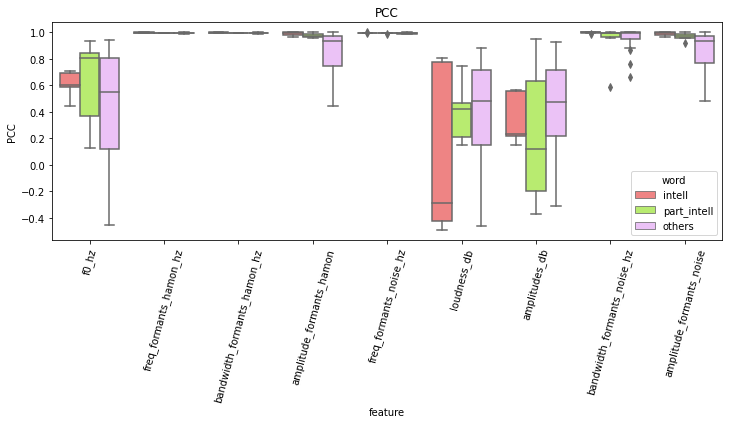

In [308]:
fig,ax=plt.subplots(figsize=(12,4))
plot = sns.boxplot(data=pccall,x='feature',y='value',hue='word')
for item in plot.get_xticklabels():
        item.set_rotation(75)
ax.set_ylabel('PCC')
ax.set_title('PCC')

Text(0.5, 1.0, 'MSE')

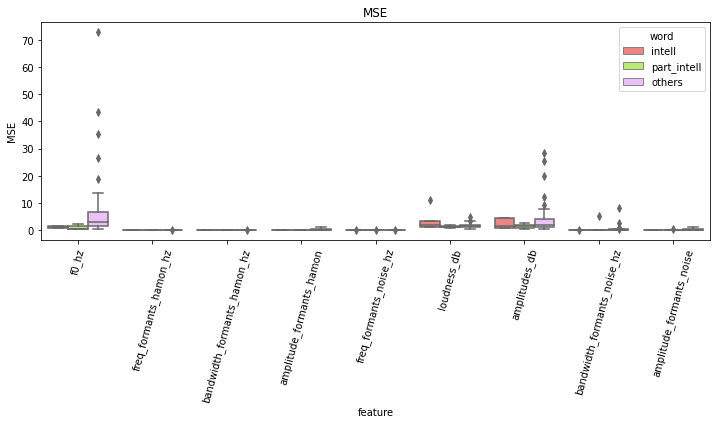

In [307]:
fig,ax=plt.subplots(figsize=(12,4))
plot = sns.boxplot(data=mseall,x='feature',y='value',hue='word')
for item in plot.get_xticklabels():
        item.set_rotation(75)
ax.set_ylabel('MSE')
ax.set_title('MSE')